In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
 %cd "/content/drive/My Drive/Hand Written Text Recognition/IAM Folder"

/content/drive/My Drive/Hand Written Text Recognition/IAM Folder


In [ ]:
!pip install stow
import stow
import tarfile
from tqdm import tqdm
from urllib.request import urlopen
from io import BytesIO
import os

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.9/80.9 kB 2.0 MB/s eta 0:00:00


In [ ]:
dataset_path='iam_words'
dataset, vocab, max_len = [], set(), 0

# Preprocess the dataset by the specific IAM_Words dataset file structure
words = open(os.path.join("iam_words", "words.txt"), "r").readlines()
for line in tqdm(words):
    if line.startswith("#"):
        continue

    line_split = line.split(" ")
    if len(line_split) < 2:  # Check if line_split has at least two elements
        continue
    if line_split[1] == "err":
        continue

    folder1 = line_split[0][:3]
    folder2 = line_split[0][:8]
    file_name = line_split[0] + ".png"
    label = line_split[-1].rstrip('\n')

    rel_path = os.path.join(dataset_path, "words", folder1, folder2, file_name)
    if not os.path.exists(rel_path):
        continue

    dataset.append([rel_path, label])
    vocab.update(list(label))
    max_len = max(max_len, len(label))

100%|██████████| 44583/44583 [01:39<00:00, 449.34it/s] 


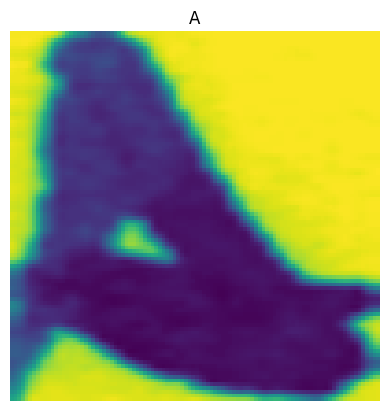

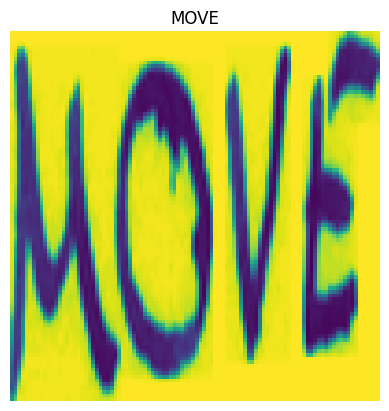

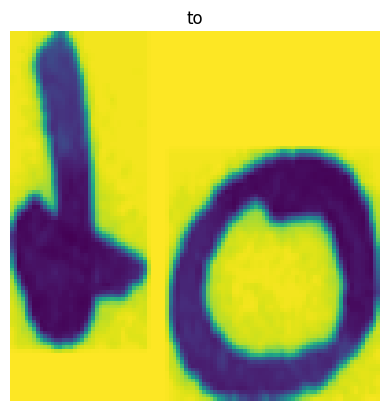

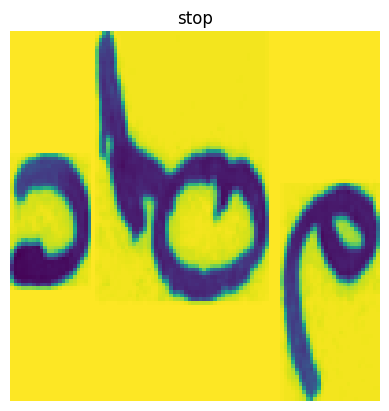

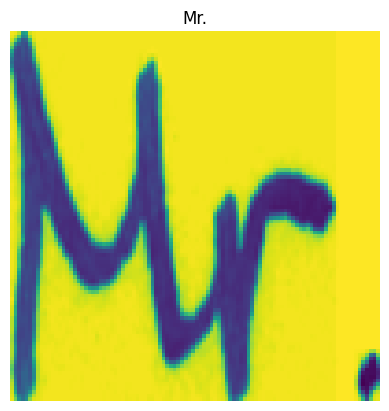

...

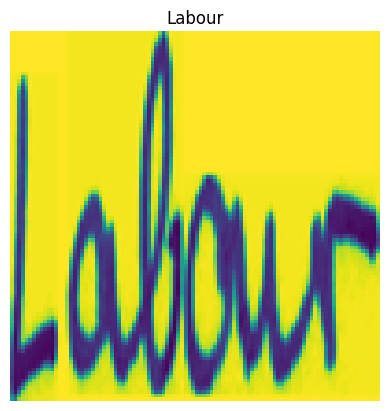

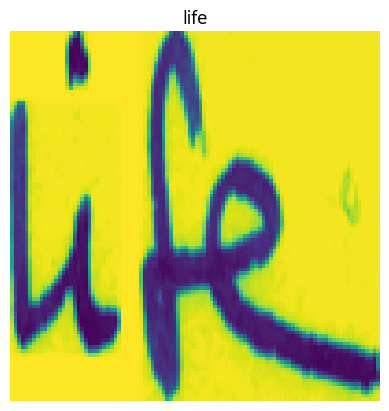

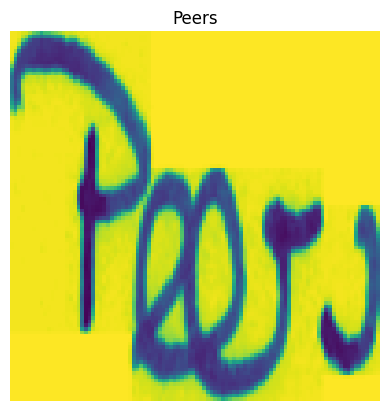

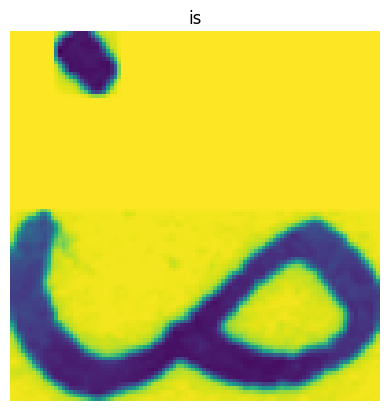

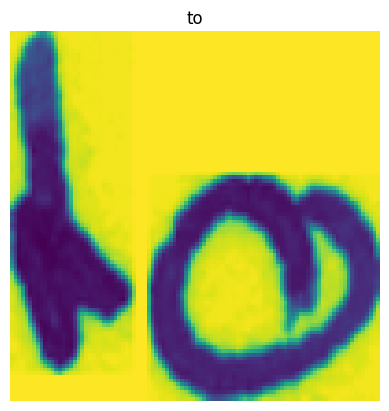

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt

# Define the size to which you want to resize the images
resize_width = 100  # Adjust this as needed
resize_height = 100  # Adjust this as needed

# Define the number of files you want to display
num_files_to_display = 15  # Adjust this as needed

# Iterate over a subset of the dataset
for file_path, label in dataset[:num_files_to_display]:
    # Load the image
    img = Image.open(file_path)

    # Resize the image
    img_resized = img.resize((resize_width, resize_height))

    # Display the resized image and its label
    plt.imshow(img_resized)
    plt.title(label)
    plt.axis('off')
    plt.show()


In [ ]:
# Create a ModelConfigs object to store model configurations
configs = ModelConfigs()

# Save vocab and maximum text length to configs
configs.vocab = "".join(vocab)
configs.max_text_length = max_len
configs.save()

In [ ]:
!pip install mltu
from mltu.configs import BaseModelConfigs
from datetime import datetime
class ModelConfigs(BaseModelConfigs):
    def __init__(self):
        super().__init__()
        self.model_path = os.path.join("Models/04_sentence_recognition", datetime.strftime(datetime.now(), "%Y%m%d%H%M"))
        self.vocab = ""
        self.height = 96
        self.width = 1408
        self.max_text_length = 0
        self.batch_size = 32
        self.learning_rate = 0.0005
        self.train_epochs = 1000
        self.train_workers = 20

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.6/74.6 kB 2.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 20.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 10.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 123.4/123.4 kB 15.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 10.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 37.9 MB/s eta 0:00:00
  Created wheel for qqdm: filename=qqdm-0.0.7-py3-none-any.whl size=6466 sha256=96836bd3cbde6c50b1651e39092a132f120547d2d2bcdfbb27f2bd76a953fe47
  Stored in directory: /root/.cache/pip/wheels/40/1a/56/5dccdea123a172661eb65c8c29fde4567dbda2b72b5fc5893a
Successfully built qqdm


In [ ]:
from mltu.tensorflow.dataProvider import DataProvider
from mltu.preprocessors import ImageReader
from mltu.transformers import ImageResizer, LabelIndexer, LabelPadding, ImageShowCV2
from mltu.augmentors import RandomBrightness, RandomRotate, RandomErodeDilate, RandomSharpen
from mltu.annotations.images import CVImage
data_provider = DataProvider(
    dataset=dataset,
    skip_validation=True,
    batch_size=configs.batch_size,
    data_preprocessors=[ImageReader(CVImage)],
    transformers=[
        ImageResizer(configs.width, configs.height, keep_aspect_ratio=True),
        LabelIndexer(configs.vocab),
        LabelPadding(max_word_length=configs.max_text_length, padding_value=len(configs.vocab)),
        ],
)
train_data_provider, val_data_provider = data_provider.split(split = 0.9)

INFO:DataProvider:Skipping Dataset validation...


In [ ]:
# model.py

from keras import layers
from keras.models import Model

from mltu.tensorflow.model_utils import residual_block


def train_model(input_dim, output_dim, activation="leaky_relu", dropout=0.2):

    inputs = layers.Input(shape=input_dim, name="input")

    # normalize images here instead in preprocessing step
    input = layers.Lambda(lambda x: x / 255)(inputs)

    x1 = residual_block(input, 32, activation=activation, skip_conv=True, strides=1, dropout=dropout)

    x2 = residual_block(x1, 32, activation=activation, skip_conv=True, strides=2, dropout=dropout)
    x3 = residual_block(x2, 32, activation=activation, skip_conv=False, strides=1, dropout=dropout)

    x4 = residual_block(x3, 64, activation=activation, skip_conv=True, strides=2, dropout=dropout)
    x5 = residual_block(x4, 64, activation=activation, skip_conv=False, strides=1, dropout=dropout)

    x6 = residual_block(x5, 128, activation=activation, skip_conv=True, strides=2, dropout=dropout)
    x7 = residual_block(x6, 128, activation=activation, skip_conv=True, strides=1, dropout=dropout)

    x8 = residual_block(x7, 128, activation=activation, skip_conv=True, strides=2, dropout=dropout)
    x9 = residual_block(x8, 128, activation=activation, skip_conv=False, strides=1, dropout=dropout)

    squeezed = layers.Reshape((x9.shape[-3] * x9.shape[-2], x9.shape[-1]))(x9)

    blstm = layers.Bidirectional(layers.LSTM(256, return_sequences=True))(squeezed)
    blstm = layers.Dropout(dropout)(blstm)

    blstm = layers.Bidirectional(layers.LSTM(64, return_sequences=True))(blstm)
    blstm = layers.Dropout(dropout)(blstm)

    output = layers.Dense(output_dim + 1, activation="softmax", name="output")(blstm)

    model = Model(inputs=inputs, outputs=output)
    return model

In [ ]:
# Creating TensorFlow model architecture
from mltu.tensorflow.losses import CTCloss
from mltu.tensorflow.metrics import CERMetric, WERMetric
import tensorflow as tf
model = train_model(
    input_dim = (configs.height, configs.width, 3),
    output_dim = len(configs.vocab),
)

# Compile the model and print summary
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=configs.learning_rate),
    loss=CTCloss(),
    metrics=[
        CERMetric(vocabulary=configs.vocab),
        WERMetric(vocabulary=configs.vocab)
        ],
    run_eagerly=False
)
model.summary(line_length=110)

Model: "model"
______________________________________________________________________________________________________________
 Layer (type)                    Output Shape                     Param #    Connected to                     
 input (InputLayer)              [(None, 96, 1408, 3)]            0          []                               
                                                                                                              
 lambda (Lambda)                 (None, 96, 1408, 3)              0          ['input[0][0]']                  
                                                                                                              
 conv2d (Conv2D)                 (None, 96, 1408, 32)             896        ['lambda[0][0]']                 
                                                                                                              
 batch_normalization (BatchNorm  (None, 96, 1408, 32)             128        ['conv2d[0][0]']    

In [ ]:
!pip install tf2onnx
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, TensorBoard
from mltu.tensorflow.callbacks import Model2onnx, TrainLogger
earlystopper = EarlyStopping(monitor="val_CER", patience=25, verbose=1, mode="min")
checkpoint = ModelCheckpoint(f"{configs.model_path}/model.h5", monitor="val_CER", verbose=1, save_best_only=True, mode="min")
trainLogger = TrainLogger(configs.model_path)
tb_callback = TensorBoard(f"{configs.model_path}/logs", update_freq=1)
reduceLROnPlat = ReduceLROnPlateau(monitor="val_CER", factor=0.9, min_delta=1e-10, patience=5, verbose=1, mode="auto")
model2onnx = Model2onnx(f"{configs.model_path}/model.h5")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.8/455.8 kB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.9/15.9 MB 58.6 MB/s eta 0:00:00


In [ ]:
"""import numpy as np
x_train = np.array([sample[0] for sample in train_set])  # Input images
y_train = np.array([sample[1] for sample in train_set])  # Labels
x_val = np.array([sample[0] for sample in val_set])  # Validation images
y_val = np.array([sample[1] for sample in val_set])  # Validation labels
print("Shape of x_train_resized:", x_train.shape)
print("Shape of x_val_resized:", x_val.shape)
# Ensure input images have the correct shape
print("Shape of x_train:", x_train.shape)
print("Shape of x_val:", x_val.shape)"""


'import numpy as np\nx_train = np.array([sample[0] for sample in train_set])  # Input images\ny_train = np.array([sample[1] for sample in train_set])  # Labels\nx_val = np.array([sample[0] for sample in val_set])  # Validation images\ny_val = np.array([sample[1] for sample in val_set])  # Validation labels\nprint("Shape of x_train_resized:", x_train.shape)\nprint("Shape of x_val_resized:", x_val.shape)\n# Ensure input images have the correct shape\nprint("Shape of x_train:", x_train.shape)\nprint("Shape of x_val:", x_val.shape)'

In [ ]:
model.fit(
    train_data_provider,
    validation_data=val_data_provider,
    epochs=configs.train_epochs,
    callbacks=[earlystopper, checkpoint, trainLogger, reduceLROnPlat, tb_callback, model2onnx],
    workers=configs.train_workers
)

# Save training and validation datasets as csv files
train_data_provider.to_csv(stow.join(configs.model_path, 'train.csv'))
val_data_provider.to_csv(stow.join(configs.model_path, 'val.csv'))

Epoch 1/1000
  3/187 [..............................] - ETA: 2:26:17 - loss: 1842.4047 - CER: 48.4787 - WER: 1.0000

KeyboardInterrupt: 

In [ ]:
import cv2
from PIL import Image
import numpy as np

def preprocess_images(image_paths, target_size=(100, 100), num_channels=3):
    images = []
    for path in image_paths:
        # Load and preprocess each image
        image = load_and_preprocess_image(path, target_size, num_channels)
        images.append(image)

    # Convert the list of images into a NumPy array
    return np.array(images)

def load_and_preprocess_image(image_path, target_size=(100, 100), num_channels=3):
    # Load the image from the given path
    image = Image.open(image_path)

    # Resize the image to the target size
    image = image.resize(target_size)

    # Convert the image to grayscale (if needed)
    image = image.convert('RGB') if num_channels == 3 else image.convert('L')

    # Normalize pixel values to the range [0, 1]
    image = np.array(image) / 255.0

    return image

# Usage example
x_train = np.array([sample[0] for sample in train_set])  # Input images
y_train = np.array([sample[1] for sample in train_set])  # Labels
x_val = np.array([sample[0] for sample in val_set])  # Validation images
y_val = np.array([sample[1] for sample in val_set])  # Validation labels

# Preprocess input images (e.g., resize, normalize pixel values)
x_train = preprocess_images(x_train)
x_val = preprocess_images(x_val)
"""target_shape = (1408, 96)
x_train_resized = np.array([cv2.resize(image, target_shape) for image in x_train])
x_val_resized = np.array([cv2.resize(image, target_shape) for image in x_val])"""

# Ensure input images have the correct shape
print("Shape of x_train_resized:", x_train.shape)
print("Shape of x_val_resized:", x_val.shape)
# Ensure input images have the correct shape
print("Shape of x_train:", x_train.shape)
print("Shape of x_val:", x_val.shape)





NameError: name 'train_set' is not defined

  0%|          | 0/663 [00:00<?, ?it/s]

Image:  iam_words/words/c03/c03-003d/c03-003d-00-08.png
Label: has
Prediction:  has
CER: 0.0; WER: 0.0


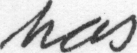

Prediction Text: has
Image:  iam_words/words/a01/a01-132u/a01-132u-04-04.png
Label: not
Prediction:  not
CER: 0.0; WER: 0.0


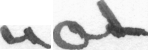

  0%|          | 2/663 [00:01<09:35,  1.15it/s]

Prediction Text: not
Image:  iam_words/words/c03/c03-003e/c03-003e-03-09.png
Label: central
Prediction:  central
CER: 0.0; WER: 0.0


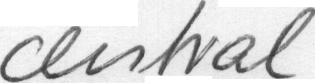

  0%|          | 3/663 [00:02<08:39,  1.27it/s]

Prediction Text: central
Image:  iam_words/words/a01/a01-063u/a01-063u-04-02.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


  1%|          | 4/663 [00:03<09:24,  1.17it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-007d/c03-007d-04-03.png
Label: public
Prediction:  publiec
CER: 0.16666666666666666; WER: 1.0


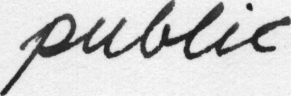

  1%|          | 5/663 [00:04<08:44,  1.26it/s]

Prediction Text: publiec
Image:  iam_words/words/c03/c03-094e/c03-094e-02-04.png
Label: Mr.
Prediction:  .
CER: 0.6666666666666666; WER: 1.0


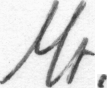

  1%|          | 6/663 [00:05<09:58,  1.10it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-053x/a01-053x-08-07.png
Label: the
Prediction:  The
CER: 0.3333333333333333; WER: 1.0


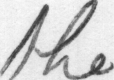

  1%|          | 7/663 [00:05<09:12,  1.19it/s]

Prediction Text: The
Image:  iam_words/words/a01/a01-030x/a01-030x-02-09.png
Label: I
Prediction:  ,
CER: 1.0; WER: 1.0


  1%|          | 8/663 [00:06<10:02,  1.09it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-113u/a01-113u-02-00.png
Label: different
Prediction:  different
CER: 0.0; WER: 0.0


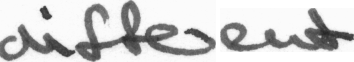

  1%|▏         | 9/663 [00:07<08:59,  1.21it/s]

Prediction Text: different
Image:  iam_words/words/a01/a01-117u/a01-117u-03-01.png
Label: social
Prediction:  social
CER: 0.0; WER: 0.0


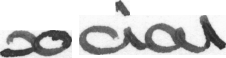

  2%|▏         | 10/663 [00:08<08:54,  1.22it/s]

Prediction Text: social
Image:  iam_words/words/c03/c03-007d/c03-007d-04-05.png
Label: and
Prediction:  and
CER: 0.0; WER: 0.0


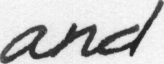

  2%|▏         | 11/663 [00:09<08:35,  1.27it/s]

Prediction Text: and
Image:  iam_words/words/c03/c03-081c/c03-081c-02-05.png
Label: in
Prediction:  in
CER: 0.0; WER: 0.0


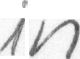

  2%|▏         | 12/663 [00:09<08:08,  1.33it/s]

Prediction Text: in
Image:  iam_words/words/a01/a01-007x/a01-007x-03-02.png
Label: ,
Prediction:  ,
CER: 0.0; WER: 0.0


  2%|▏         | 13/663 [00:10<08:26,  1.28it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-003a/c03-003a-00-01.png
Label: is
Prediction:  .
CER: 1.0; WER: 1.0


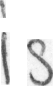

  2%|▏         | 14/663 [00:11<08:26,  1.28it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-094a/c03-094a-01-00.png
Label: tively
Prediction:  Divel
CER: 0.3333333333333333; WER: 1.0


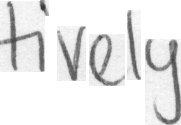

  2%|▏         | 15/663 [00:12<08:26,  1.28it/s]

Prediction Text: Divel
Image:  iam_words/words/a01/a01-091u/a01-091u-01-06.png
Label: answer
Prediction:  aswer
CER: 0.16666666666666666; WER: 1.0


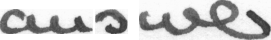

Prediction Text: aswer
Image:  iam_words/words/c03/c03-087e/c03-087e-08-01.png
Label: his
Prediction:  thst
CER: 1.0; WER: 1.0


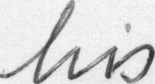

  3%|▎         | 17/663 [00:13<07:20,  1.47it/s]

Prediction Text: thst
Image:  iam_words/words/a01/a01-132x/a01-132x-00-03.png
Label: continue
Prediction:  cantine
CER: 0.25; WER: 1.0


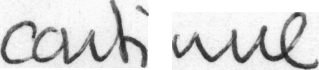

  3%|▎         | 18/663 [00:14<08:13,  1.31it/s]

Prediction Text: cantine
Image:  iam_words/words/a01/a01-117u/a01-117u-09-01.png
Label: against
Prediction:  against
CER: 0.0; WER: 0.0


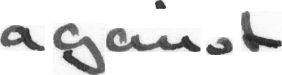

  3%|▎         | 19/663 [00:15<08:20,  1.29it/s]

Prediction Text: against
Image:  iam_words/words/a01/a01-038x/a01-038x-00-01.png
Label: Macleod
Prediction:  Dulatt
CER: 0.8571428571428571; WER: 1.0


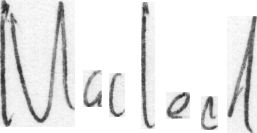

  3%|▎         | 20/663 [00:15<08:20,  1.29it/s]

Prediction Text: Dulatt
Image:  iam_words/words/c03/c03-096d/c03-096d-07-00.png
Label: accents
Prediction:  accents
CER: 0.0; WER: 0.0


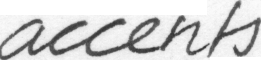

Prediction Text: accents
Image:  iam_words/words/a01/a01-122u/a01-122u-04-07.png
Label: and
Prediction:  and
CER: 0.0; WER: 0.0


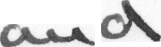

  3%|▎         | 22/663 [00:16<06:52,  1.55it/s]

Prediction Text: and
Image:  iam_words/words/a01/a01-107u/a01-107u-04-07.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


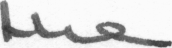

  3%|▎         | 23/663 [00:17<06:50,  1.56it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-021b/c03-021b-07-02.png
Label: love
Prediction:  Moree
CER: 0.75; WER: 1.0


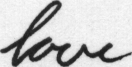

  4%|▎         | 24/663 [00:18<06:50,  1.56it/s]

Prediction Text: Moree
Image:  iam_words/words/c03/c03-084d/c03-084d-06-05.png
Label: on
Prediction:  o
CER: 0.5; WER: 1.0


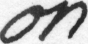

  4%|▍         | 25/663 [00:19<07:22,  1.44it/s]

Prediction Text: o
Image:  iam_words/words/a01/a01-026x/a01-026x-02-02.png
Label: negotiations
Prediction:  ingotiation
CER: 0.25; WER: 1.0


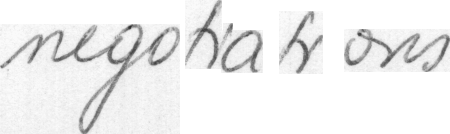

  4%|▍         | 26/663 [00:19<07:31,  1.41it/s]

Prediction Text: ingotiation
Image:  iam_words/words/c03/c03-096a/c03-096a-02-07.png
Label: action
Prediction:  action
CER: 0.0; WER: 0.0


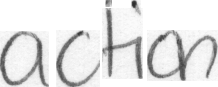

  4%|▍         | 27/663 [00:20<07:41,  1.38it/s]

Prediction Text: action
Image:  iam_words/words/c03/c03-087f/c03-087f-02-03.png
Label: melodramatic
Prediction:  melodamatic
CER: 0.08333333333333333; WER: 1.0


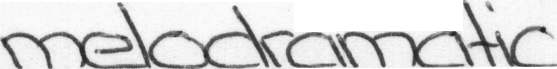

  4%|▍         | 28/663 [00:21<07:32,  1.40it/s]

Prediction Text: melodamatic
Image:  iam_words/words/a01/a01-011u/a01-011u-03-03.png
Label: (
Prediction:  .
CER: 1.0; WER: 1.0


  4%|▍         | 29/663 [00:21<07:28,  1.41it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-058x/a01-058x-04-02.png
Label: offer
Prediction:  if
CER: 0.8; WER: 1.0


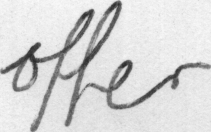

  5%|▍         | 30/663 [00:22<07:36,  1.39it/s]

Prediction Text: if
Image:  iam_words/words/c03/c03-021e/c03-021e-02-00.png
Label: sexual
Prediction:  sexual
CER: 0.0; WER: 0.0


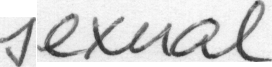

  5%|▍         | 31/663 [00:23<07:51,  1.34it/s]

Prediction Text: sexual
Image:  iam_words/words/a01/a01-113u/a01-113u-06-05.png
Label: put
Prediction:  but
CER: 0.3333333333333333; WER: 1.0


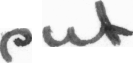

  5%|▍         | 32/663 [00:24<08:12,  1.28it/s]

Prediction Text: but
Image:  iam_words/words/c03/c03-087d/c03-087d-05-06.png
Label: perhaps
Prediction:  perhaps
CER: 0.0; WER: 0.0


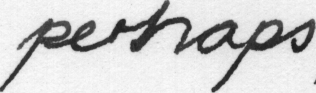

  5%|▍         | 33/663 [00:24<07:36,  1.38it/s]

Prediction Text: perhaps
Image:  iam_words/words/c03/c03-081a/c03-081a-01-06.png
Label: speak
Prediction:  Irpatt
CER: 1.0; WER: 1.0


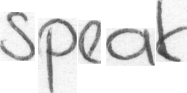

  5%|▌         | 34/663 [00:25<07:59,  1.31it/s]

Prediction Text: Irpatt
Image:  iam_words/words/a01/a01-007x/a01-007x-04-01.png
Label: an
Prediction:  an
CER: 0.0; WER: 0.0


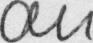

  5%|▌         | 35/663 [00:26<08:15,  1.27it/s]

Prediction Text: an
Image:  iam_words/words/c03/c03-003c/c03-003c-06-07.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


  5%|▌         | 36/663 [00:27<08:13,  1.27it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-081b/c03-081b-00-05.png
Label: committed
Prediction:  committed
CER: 0.0; WER: 0.0


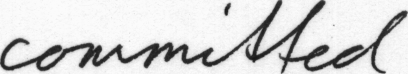

Prediction Text: committed
Image:  iam_words/words/c03/c03-094f/c03-094f-00-06.png
Label: is
Prediction:  ,
CER: 1.0; WER: 1.0


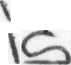

  6%|▌         | 38/663 [00:28<06:27,  1.61it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-011u/a01-011u-03-00.png
Label: African
Prediction:  African
CER: 0.0; WER: 0.0


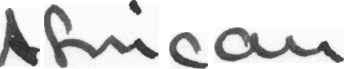

  6%|▌         | 39/663 [00:29<06:55,  1.50it/s]

Prediction Text: African
Image:  iam_words/words/a01/a01-049u/a01-049u-10-06.png
Label: received
Prediction:  received
CER: 0.0; WER: 0.0


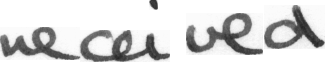

  6%|▌         | 40/663 [00:29<07:20,  1.42it/s]

Prediction Text: received
Image:  iam_words/words/c03/c03-087a/c03-087a-00-03.png
Label: perhaps
Prediction:  perhaps
CER: 0.0; WER: 0.0


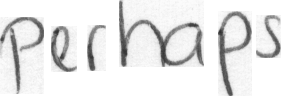

  6%|▌         | 41/663 [00:30<07:38,  1.36it/s]

Prediction Text: perhaps
Image:  iam_words/words/c03/c03-087f/c03-087f-06-02.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


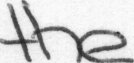

  6%|▋         | 42/663 [00:31<07:26,  1.39it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-084f/c03-084f-05-02.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


  6%|▋         | 43/663 [00:32<07:21,  1.40it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-128u/a01-128u-00-01.png
Label: Mr.
Prediction:  M.
CER: 0.3333333333333333; WER: 1.0


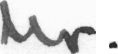

  7%|▋         | 44/663 [00:32<07:30,  1.37it/s]

Prediction Text: M.
Image:  iam_words/words/a01/a01-049x/a01-049x-01-04.png
Label: by
Prediction:  .
CER: 1.0; WER: 1.0


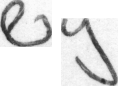

  7%|▋         | 45/663 [00:33<07:43,  1.33it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-020x/a01-020x-05-06.png
Label: delegates
Prediction:  delegates
CER: 0.0; WER: 0.0


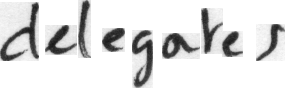

  7%|▋         | 46/663 [00:34<08:09,  1.26it/s]

Prediction Text: delegates
Image:  iam_words/words/c03/c03-021a/c03-021a-08-06.png
Label: to
Prediction:  .
CER: 1.0; WER: 1.0


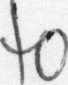

  7%|▋         | 47/663 [00:35<07:48,  1.32it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-007x/a01-007x-06-01.png
Label: have
Prediction:  Mau
CER: 0.75; WER: 1.0


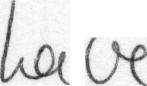

Prediction Text: Mau
Image:  iam_words/words/c03/c03-081c/c03-081c-01-06.png
Label: for
Prediction:  .
CER: 1.0; WER: 1.0


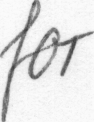

  7%|▋         | 49/663 [00:36<06:08,  1.67it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-003f/c03-003f-00-03.png
Label: a
Prediction:  ,
CER: 1.0; WER: 1.0


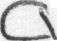

  8%|▊         | 50/663 [00:36<06:24,  1.59it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-084f/c03-084f-08-03.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


  8%|▊         | 51/663 [00:37<06:27,  1.58it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-014x/a01-014x-09-00.png
Label: Macmillan
Prediction:  Macmilan
CER: 0.1111111111111111; WER: 1.0


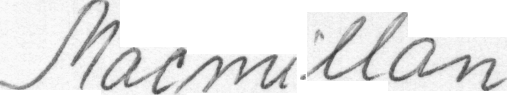

  8%|▊         | 52/663 [00:38<06:55,  1.47it/s]

Prediction Text: Macmilan
Image:  iam_words/words/c03/c03-016a/c03-016a-09-01.png
Label: bear
Prediction:  Weal
CER: 0.5; WER: 1.0


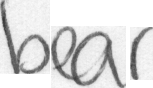

  8%|▊         | 53/663 [00:38<06:31,  1.56it/s]

Prediction Text: Weal
Image:  iam_words/words/a01/a01-026u/a01-026u-00-06.png
Label: Secretary
Prediction:  Secretary
CER: 0.0; WER: 0.0


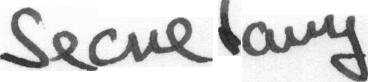

  8%|▊         | 54/663 [00:39<07:07,  1.42it/s]

Prediction Text: Secretary
Image:  iam_words/words/c03/c03-084e/c03-084e-03-07.png
Label: "
Prediction:  .
CER: 1.0; WER: 1.0


  8%|▊         | 55/663 [00:40<07:01,  1.44it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-007b/c03-007b-07-00.png
Label: the
Prediction:  T
CER: 1.0; WER: 1.0


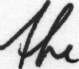

  8%|▊         | 56/663 [00:40<06:59,  1.45it/s]

Prediction Text: T
Image:  iam_words/words/a01/a01-107u/a01-107u-07-08.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


  9%|▊         | 57/663 [00:41<07:10,  1.41it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-087u/a01-087u-08-00.png
Label: balance-sheet
Prediction:  balancerished
CER: 0.3076923076923077; WER: 1.0


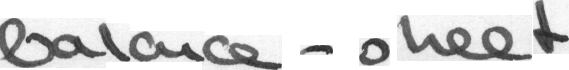

  9%|▊         | 58/663 [00:42<07:13,  1.40it/s]

Prediction Text: balancerished
Image:  iam_words/words/c03/c03-000f/c03-000f-04-04.png
Label: also
Prediction:  labso
CER: 0.5; WER: 1.0


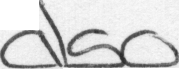

  9%|▉         | 59/663 [00:43<07:01,  1.43it/s]

Prediction Text: labso
Image:  iam_words/words/a01/a01-053x/a01-053x-08-00.png
Label: nomination
Prediction:  momintion
CER: 0.2; WER: 1.0


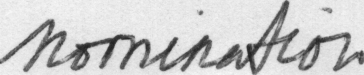

  9%|▉         | 60/663 [00:43<07:09,  1.40it/s]

Prediction Text: momintion
Image:  iam_words/words/c03/c03-021f/c03-021f-08-02.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


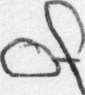

  9%|▉         | 61/663 [00:44<07:01,  1.43it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-021e/c03-021e-01-00.png
Label: by
Prediction:  .
CER: 1.0; WER: 1.0


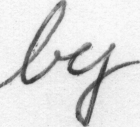

  9%|▉         | 62/663 [00:45<06:55,  1.45it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-030u/a01-030u-00-04.png
Label: member
Prediction:  member
CER: 0.0; WER: 0.0


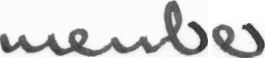

 10%|▉         | 63/663 [00:45<07:10,  1.39it/s]

Prediction Text: member
Image:  iam_words/words/c03/c03-021b/c03-021b-02-09.png
Label: to
Prediction:  '
CER: 1.0; WER: 1.0


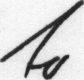

 10%|▉         | 64/663 [00:46<07:33,  1.32it/s]

Prediction Text: '
Image:  iam_words/words/a01/a01-058x/a01-058x-06-04.png
Label: get
Prediction:  .
CER: 1.0; WER: 1.0


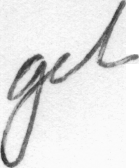

 10%|▉         | 65/663 [00:47<07:25,  1.34it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-016b/c03-016b-07-02.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 10%|▉         | 66/663 [00:48<07:30,  1.33it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-000d/c03-000d-01-07.png
Label: the
Prediction:  1the
CER: 0.3333333333333333; WER: 1.0


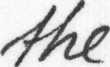

 10%|█         | 67/663 [00:49<07:46,  1.28it/s]

Prediction Text: 1the
Image:  iam_words/words/c03/c03-003e/c03-003e-08-00.png
Label: create
Prediction:  breate
CER: 0.16666666666666666; WER: 1.0


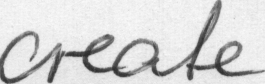

 10%|█         | 68/663 [00:49<07:46,  1.27it/s]

Prediction Text: breate
Image:  iam_words/words/a01/a01-020u/a01-020u-00-02.png
Label: went
Prediction:  went
CER: 0.0; WER: 0.0


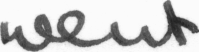

 10%|█         | 69/663 [00:50<07:42,  1.28it/s]

Prediction Text: went
Image:  iam_words/words/a01/a01-049x/a01-049x-10-01.png
Label: about
Prediction:  about
CER: 0.0; WER: 0.0


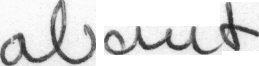

 11%|█         | 70/663 [00:51<07:41,  1.28it/s]

Prediction Text: about
Image:  iam_words/words/c03/c03-021b/c03-021b-02-02.png
Label: yet
Prediction:  ,
CER: 1.0; WER: 1.0


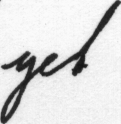

 11%|█         | 71/663 [00:52<07:26,  1.33it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-003c/c03-003c-01-00.png
Label: ceived
Prediction:  reived
CER: 0.16666666666666666; WER: 1.0


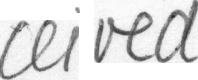

 11%|█         | 72/663 [00:52<07:11,  1.37it/s]

Prediction Text: reived
Image:  iam_words/words/a01/a01-000u/a01-000u-00-04.png
Label: Mr.
Prediction:  M..
CER: 0.3333333333333333; WER: 1.0


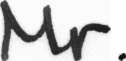

Prediction Text: M..
Image:  iam_words/words/c03/c03-003f/c03-003f-03-00.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


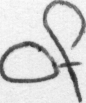

 11%|█         | 74/663 [00:53<05:22,  1.83it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-096d/c03-096d-08-03.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 11%|█▏        | 75/663 [00:54<05:23,  1.82it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-087d/c03-087d-00-04.png
Label: ,
Prediction:  ,
CER: 0.0; WER: 0.0


 11%|█▏        | 76/663 [00:54<05:45,  1.70it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-072u/a01-072u-00-02.png
Label: costs
Prediction:  costs
CER: 0.0; WER: 0.0


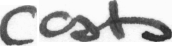

 12%|█▏        | 77/663 [00:55<06:14,  1.56it/s]

Prediction Text: costs
Image:  iam_words/words/c03/c03-087c/c03-087c-01-00.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


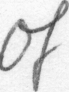

 12%|█▏        | 78/663 [00:56<06:31,  1.50it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-081f/c03-081f-04-06.png
Label: but
Prediction:  But
CER: 0.3333333333333333; WER: 1.0


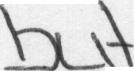

 12%|█▏        | 79/663 [00:56<06:14,  1.56it/s]

Prediction Text: But
Image:  iam_words/words/c03/c03-021f/c03-021f-02-00.png
Label: sexual
Prediction:  sexual
CER: 0.0; WER: 0.0


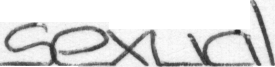

 12%|█▏        | 80/663 [00:57<06:18,  1.54it/s]

Prediction Text: sexual
Image:  iam_words/words/a01/a01-026x/a01-026x-00-08.png
Label: denied
Prediction:  denied
CER: 0.0; WER: 0.0


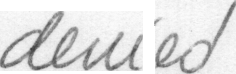

 12%|█▏        | 81/663 [00:58<06:31,  1.49it/s]

Prediction Text: denied
Image:  iam_words/words/a01/a01-117u/a01-117u-04-02.png
Label: 28.5
Prediction:  285
CER: 0.25; WER: 1.0


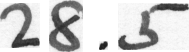

 12%|█▏        | 82/663 [00:59<06:46,  1.43it/s]

Prediction Text: 285
Image:  iam_words/words/c03/c03-094d/c03-094d-01-00.png
Label: insensitively
Prediction:  insensitively
CER: 0.0; WER: 0.0


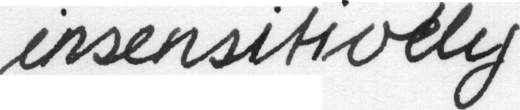

 13%|█▎        | 83/663 [00:59<07:00,  1.38it/s]

Prediction Text: insensitively
Image:  iam_words/words/c03/c03-016c/c03-016c-02-02.png
Label: in
Prediction:  :
CER: 1.0; WER: 1.0


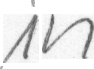

 13%|█▎        | 84/663 [01:00<07:26,  1.30it/s]

Prediction Text: :
Image:  iam_words/words/a01/a01-030u/a01-030u-04-04.png
Label: an
Prediction:  a
CER: 0.5; WER: 1.0


 13%|█▎        | 85/663 [01:01<07:26,  1.30it/s]

Prediction Text: a
Image:  iam_words/words/a01/a01-014x/a01-014x-06-02.png
Label: demonstrations
Prediction:  demsitlatios
CER: 0.35714285714285715; WER: 1.0


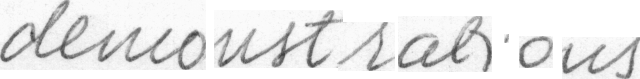

 13%|█▎        | 86/663 [01:02<07:07,  1.35it/s]

Prediction Text: demsitlatios
Image:  iam_words/words/a01/a01-020x/a01-020x-07-01.png
Label: discuss
Prediction:  disust
CER: 0.2857142857142857; WER: 1.0


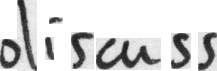

Prediction Text: disust
Image:  iam_words/words/a01/a01-007u/a01-007u-00-06.png
Label: Peers
Prediction:  Peer
CER: 0.2; WER: 1.0


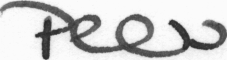

 13%|█▎        | 88/663 [01:02<05:36,  1.71it/s]

Prediction Text: Peer
Image:  iam_words/words/a01/a01-117u/a01-117u-02-07.png
Label: as
Prediction:  os
CER: 0.5; WER: 1.0


 13%|█▎        | 89/663 [01:03<05:51,  1.63it/s]

Prediction Text: os
Image:  iam_words/words/a01/a01-020x/a01-020x-02-06.png
Label: revealed
Prediction:  revealed
CER: 0.0; WER: 0.0


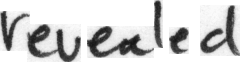

 14%|█▎        | 90/663 [01:04<06:11,  1.54it/s]

Prediction Text: revealed
Image:  iam_words/words/c03/c03-003e/c03-003e-02-01.png
Label: again
Prediction:  apaind
CER: 0.4; WER: 1.0


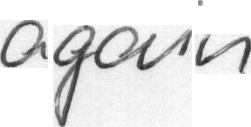

 14%|█▎        | 91/663 [01:05<06:38,  1.44it/s]

Prediction Text: apaind
Image:  iam_words/words/a01/a01-128u/a01-128u-00-04.png
Label: down
Prediction:  down
CER: 0.0; WER: 0.0


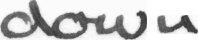

 14%|█▍        | 92/663 [01:05<06:25,  1.48it/s]

Prediction Text: down
Image:  iam_words/words/c03/c03-000f/c03-000f-04-01.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 14%|█▍        | 93/663 [01:06<06:11,  1.53it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-084b/c03-084b-00-02.png
Label: Stonehouse's
Prediction:  Stonhouse's
CER: 0.08333333333333333; WER: 1.0


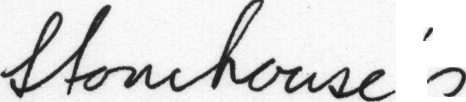

Prediction Text: Stonhouse's
Image:  iam_words/words/c03/c03-021d/c03-021d-02-04.png
Label: yet
Prediction:  .
CER: 1.0; WER: 1.0


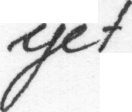

Prediction Text: .
Image:  iam_words/words/c03/c03-094d/c03-094d-09-04.png
Label: Mr.
Prediction:  "
CER: 1.0; WER: 1.0


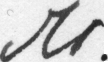

 14%|█▍        | 96/663 [01:07<03:51,  2.45it/s]

Prediction Text: "
Image:  iam_words/words/c03/c03-084c/c03-084c-06-06.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 15%|█▍        | 97/663 [01:07<04:30,  2.09it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-014x/a01-014x-05-06.png
Label: There
Prediction:  Then
CER: 0.4; WER: 1.0


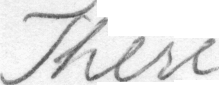

 15%|█▍        | 98/663 [01:08<05:10,  1.82it/s]

Prediction Text: Then
Image:  iam_words/words/c03/c03-084a/c03-084a-00-05.png
Label: quietly
Prediction:  Juiethy
CER: 0.2857142857142857; WER: 1.0


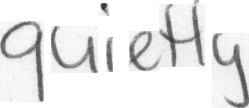

 15%|█▍        | 99/663 [01:09<05:36,  1.67it/s]

Prediction Text: Juiethy
Image:  iam_words/words/a01/a01-043u/a01-043u-08-01.png
Label: Government
Prediction:  Government
CER: 0.0; WER: 0.0


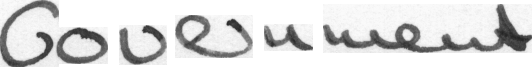

 15%|█▌        | 100/663 [01:10<05:58,  1.57it/s]

Prediction Text: Government
Image:  iam_words/words/a01/a01-102u/a01-102u-04-03.png
Label: a
Prediction:  a
CER: 0.0; WER: 0.0


 15%|█▌        | 101/663 [01:10<06:21,  1.47it/s]

Prediction Text: a
Image:  iam_words/words/a01/a01-072x/a01-072x-00-03.png
Label: are
Prediction:  w
CER: 1.0; WER: 1.0


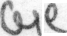

 15%|█▌        | 102/663 [01:11<06:30,  1.44it/s]

Prediction Text: w
Image:  iam_words/words/c03/c03-094b/c03-094b-07-00.png
Label: with
Prediction:  with
CER: 0.0; WER: 0.0


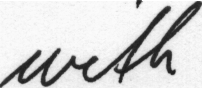

 16%|█▌        | 103/663 [01:12<06:30,  1.43it/s]

Prediction Text: with
Image:  iam_words/words/c03/c03-016a/c03-016a-06-02.png
Label: herself
Prediction:  theselt
CER: 0.42857142857142855; WER: 1.0


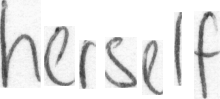

 16%|█▌        | 104/663 [01:12<06:18,  1.48it/s]

Prediction Text: theselt
Image:  iam_words/words/c03/c03-084b/c03-084b-07-03.png
Label: ambition
Prediction:  ambition
CER: 0.0; WER: 0.0


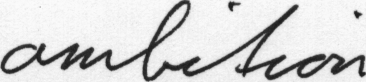

 16%|█▌        | 105/663 [01:13<06:27,  1.44it/s]

Prediction Text: ambition
Image:  iam_words/words/a01/a01-058u/a01-058u-03-04.png
Label: yesterday
Prediction:  yesterday
CER: 0.0; WER: 0.0


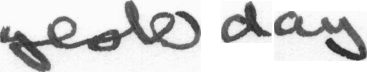

 16%|█▌        | 106/663 [01:14<06:15,  1.48it/s]

Prediction Text: yesterday
Image:  iam_words/words/c03/c03-096a/c03-096a-01-01.png
Label: from
Prediction:  Irad
CER: 0.75; WER: 1.0


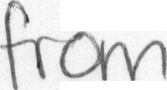

 16%|█▌        | 107/663 [01:15<06:26,  1.44it/s]

Prediction Text: Irad
Image:  iam_words/words/a01/a01-000x/a01-000x-04-00.png
Label: and
Prediction:  "l
CER: 1.0; WER: 1.0


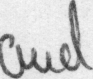

 16%|█▋        | 108/663 [01:15<06:51,  1.35it/s]

Prediction Text: "l
Image:  iam_words/words/c03/c03-087d/c03-087d-05-00.png
Label: unredeemable
Prediction:  unedemable
CER: 0.16666666666666666; WER: 1.0


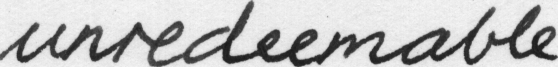

 16%|█▋        | 109/663 [01:16<06:50,  1.35it/s]

Prediction Text: unedemable
Image:  iam_words/words/c03/c03-016e/c03-016e-07-06.png
Label: half
Prediction:  thl
CER: 0.75; WER: 1.0


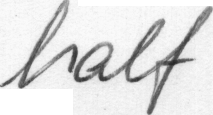

 17%|█▋        | 110/663 [01:17<06:22,  1.44it/s]

Prediction Text: thl
Image:  iam_words/words/c03/c03-096e/c03-096e-03-00.png
Label: the
Prediction:  The
CER: 0.3333333333333333; WER: 1.0


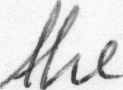

 17%|█▋        | 111/663 [01:18<06:52,  1.34it/s]

Prediction Text: The
Image:  iam_words/words/c03/c03-000b/c03-000b-05-07.png
Label: conception
Prediction:  conception
CER: 0.0; WER: 0.0


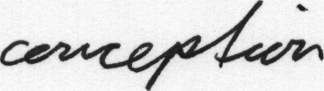

 17%|█▋        | 112/663 [01:18<06:35,  1.39it/s]

Prediction Text: conception
Image:  iam_words/words/a01/a01-132u/a01-132u-02-06.png
Label: decided
Prediction:  decided
CER: 0.0; WER: 0.0


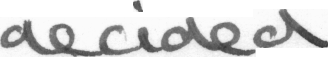

 17%|█▋        | 113/663 [01:19<06:19,  1.45it/s]

Prediction Text: decided
Image:  iam_words/words/a01/a01-049u/a01-049u-09-01.png
Label: later
Prediction:  later
CER: 0.0; WER: 0.0


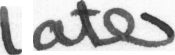

 17%|█▋        | 114/663 [01:20<06:32,  1.40it/s]

Prediction Text: later
Image:  iam_words/words/a01/a01-053x/a01-053x-05-00.png
Label: He
Prediction:  "
CER: 1.0; WER: 1.0


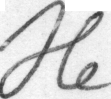

 17%|█▋        | 115/663 [01:20<06:30,  1.40it/s]

Prediction Text: "
Image:  iam_words/words/c03/c03-000a/c03-000a-04-01.png
Label: with
Prediction:  Wilt
CER: 0.75; WER: 1.0


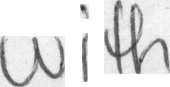

 17%|█▋        | 116/663 [01:21<06:03,  1.50it/s]

Prediction Text: Wilt
Image:  iam_words/words/c03/c03-096b/c03-096b-04-00.png
Label: with
Prediction:  Ditht
CER: 0.5; WER: 1.0


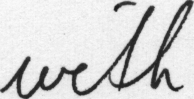

 18%|█▊        | 117/663 [01:21<05:44,  1.58it/s]

Prediction Text: Ditht
Image:  iam_words/words/c03/c03-021c/c03-021c-04-02.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 18%|█▊        | 118/663 [01:22<05:53,  1.54it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-087c/c03-087c-05-05.png
Label: if
Prediction:  .
CER: 1.0; WER: 1.0


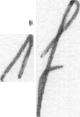

 18%|█▊        | 119/663 [01:23<06:21,  1.43it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-058u/a01-058u-00-03.png
Label: ready
Prediction:  Thady
CER: 0.4; WER: 1.0


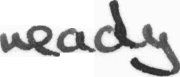

 18%|█▊        | 120/663 [01:24<06:30,  1.39it/s]

Prediction Text: Thady
Image:  iam_words/words/c03/c03-096d/c03-096d-00-02.png
Label: Lucas's
Prediction:  Lucas's
CER: 0.0; WER: 0.0


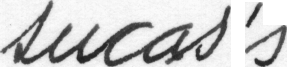

 18%|█▊        | 121/663 [01:24<06:19,  1.43it/s]

Prediction Text: Lucas's
Image:  iam_words/words/c03/c03-021c/c03-021c-08-04.png
Label: you
Prediction:  ,
CER: 1.0; WER: 1.0


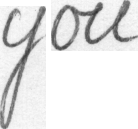

 18%|█▊        | 122/663 [01:25<06:28,  1.39it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-020x/a01-020x-01-06.png
Label: had
Prediction:  had
CER: 0.0; WER: 0.0


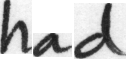

 19%|█▊        | 123/663 [01:26<06:18,  1.43it/s]

Prediction Text: had
Image:  iam_words/words/c03/c03-007b/c03-007b-04-02.png
Label: strewn
Prediction:  thenn
CER: 0.5; WER: 1.0


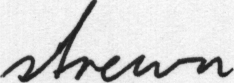

 19%|█▊        | 124/663 [01:27<06:23,  1.40it/s]

Prediction Text: thenn
Image:  iam_words/words/a01/a01-082u/a01-082u-04-02.png
Label: America
Prediction:  America
CER: 0.0; WER: 0.0


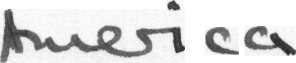

 19%|█▉        | 125/663 [01:27<06:41,  1.34it/s]

Prediction Text: America
Image:  iam_words/words/a01/a01-063x/a01-063x-07-02.png
Label: 210million
Prediction:  210mllion
CER: 0.1; WER: 1.0


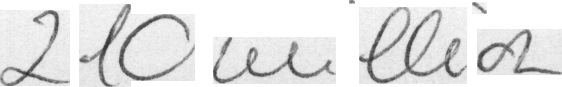

 19%|█▉        | 126/663 [01:28<06:37,  1.35it/s]

Prediction Text: 210mllion
Image:  iam_words/words/c03/c03-094e/c03-094e-07-01.png
Label: set
Prediction:  bet
CER: 0.3333333333333333; WER: 1.0


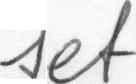

Prediction Text: bet
Image:  iam_words/words/a01/a01-011u/a01-011u-00-04.png
Label: Kaunda's
Prediction:  Kaunda's
CER: 0.0; WER: 0.0


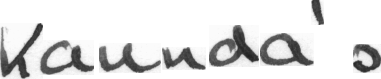

Prediction Text: Kaunda's
Image:  iam_words/words/a01/a01-030u/a01-030u-01-02.png
Label: was
Prediction:  was
CER: 0.0; WER: 0.0


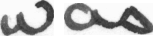

 19%|█▉        | 129/663 [01:29<04:01,  2.21it/s]

Prediction Text: was
Image:  iam_words/words/c03/c03-096c/c03-096c-02-04.png
Label: by
Prediction:  .
CER: 1.0; WER: 1.0


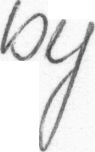

 20%|█▉        | 130/663 [01:29<04:21,  2.04it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-000b/c03-000b-06-00.png
Label: are
Prediction:  are
CER: 0.0; WER: 0.0


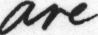

 20%|█▉        | 131/663 [01:30<04:29,  1.98it/s]

Prediction Text: are
Image:  iam_words/words/a01/a01-011u/a01-011u-02-02.png
Label: members
Prediction:  members
CER: 0.0; WER: 0.0


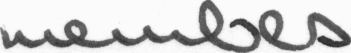

 20%|█▉        | 132/663 [01:31<04:51,  1.82it/s]

Prediction Text: members
Image:  iam_words/words/c03/c03-007d/c03-007d-07-01.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


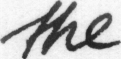

 20%|██        | 133/663 [01:31<05:09,  1.71it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-094a/c03-094a-02-03.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 20%|██        | 134/663 [01:32<05:22,  1.64it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-087a/c03-087a-06-01.png
Label: if
Prediction:  .
CER: 1.0; WER: 1.0


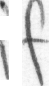

 20%|██        | 135/663 [01:33<05:35,  1.57it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-030u/a01-030u-03-01.png
Label: no
Prediction:  no
CER: 0.0; WER: 0.0


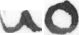

 21%|██        | 136/663 [01:33<05:49,  1.51it/s]

Prediction Text: no
Image:  iam_words/words/c03/c03-000d/c03-000d-01-00.png
Label: play
Prediction:  pa
CER: 0.5; WER: 1.0


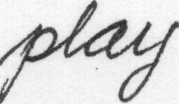

 21%|██        | 137/663 [01:34<06:18,  1.39it/s]

Prediction Text: pa
Image:  iam_words/words/a01/a01-043u/a01-043u-01-03.png
Label: PRESIDENT
Prediction:  PRESIDENT
CER: 0.0; WER: 0.0


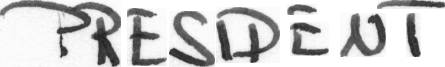

 21%|██        | 138/663 [01:35<06:07,  1.43it/s]

Prediction Text: PRESIDENT
Image:  iam_words/words/a01/a01-091u/a01-091u-08-03.png
Label: beyond
Prediction:  beyond
CER: 0.0; WER: 0.0


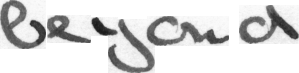

 21%|██        | 139/663 [01:36<05:52,  1.49it/s]

Prediction Text: beyond
Image:  iam_words/words/a01/a01-003x/a01-003x-01-06.png
Label: likely
Prediction:  !
CER: 1.0; WER: 1.0


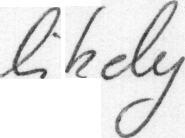

 21%|██        | 140/663 [01:36<06:05,  1.43it/s]

Prediction Text: !
Image:  iam_words/words/a01/a01-000x/a01-000x-00-07.png
Label: nominating
Prediction:  qiis
CER: 0.8; WER: 1.0


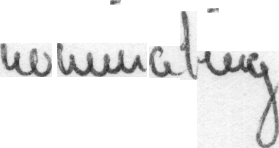

 21%|██▏       | 141/663 [01:37<06:16,  1.39it/s]

Prediction Text: qiis
Image:  iam_words/words/c03/c03-096d/c03-096d-05-01.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 21%|██▏       | 142/663 [01:38<05:57,  1.46it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-084d/c03-084d-03-02.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 22%|██▏       | 143/663 [01:38<06:07,  1.41it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-094f/c03-094f-02-00.png
Label: always
Prediction:  rlays
CER: 0.3333333333333333; WER: 1.0


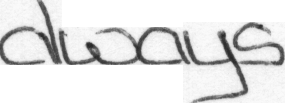

 22%|██▏       | 144/663 [01:39<06:00,  1.44it/s]

Prediction Text: rlays
Image:  iam_words/words/c03/c03-087c/c03-087c-05-07.png
Label: had
Prediction:  had
CER: 0.0; WER: 0.0


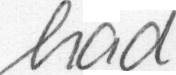

 22%|██▏       | 145/663 [01:40<05:47,  1.49it/s]

Prediction Text: had
Image:  iam_words/words/a01/a01-007x/a01-007x-07-04.png
Label: Welensky
Prediction:  M
CER: 1.0; WER: 1.0


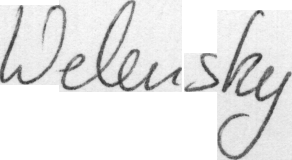

 22%|██▏       | 146/663 [01:40<05:27,  1.58it/s]

Prediction Text: M
Image:  iam_words/words/a01/a01-113u/a01-113u-09-06.png
Label: of
Prediction:  ,t
CER: 1.0; WER: 1.0


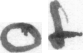

 22%|██▏       | 147/663 [01:41<05:42,  1.51it/s]

Prediction Text: ,t
Image:  iam_words/words/a01/a01-058x/a01-058x-02-05.png
Label: position
Prediction:  povition
CER: 0.125; WER: 1.0


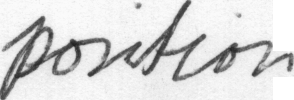

 22%|██▏       | 148/663 [01:42<05:48,  1.48it/s]

Prediction Text: povition
Image:  iam_words/words/c03/c03-016e/c03-016e-08-03.png
Label: is
Prediction:  .
CER: 1.0; WER: 1.0


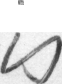

 22%|██▏       | 149/663 [01:42<05:27,  1.57it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-096b/c03-096b-04-06.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 23%|██▎       | 150/663 [01:43<05:27,  1.57it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-014u/a01-014u-00-03.png
Label: Federal
Prediction:  Federal
CER: 0.0; WER: 0.0


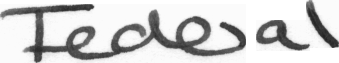

Prediction Text: Federal
Image:  iam_words/words/a01/a01-014x/a01-014x-01-04.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


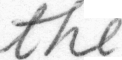

 23%|██▎       | 152/663 [01:44<04:35,  1.86it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-096b/c03-096b-06-04.png
Label: accents
Prediction:  accents
CER: 0.0; WER: 0.0


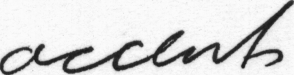

 23%|██▎       | 153/663 [01:44<04:49,  1.76it/s]

Prediction Text: accents
Image:  iam_words/words/c03/c03-094c/c03-094c-08-04.png
Label: colour
Prediction:  Colour
CER: 0.16666666666666666; WER: 1.0


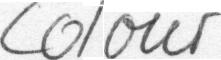

Prediction Text: Colour
Image:  iam_words/words/c03/c03-094e/c03-094e-08-09.png
Label: ,
Prediction:  '
CER: 1.0; WER: 1.0


 23%|██▎       | 155/663 [01:45<03:59,  2.12it/s]

Prediction Text: '
Image:  iam_words/words/c03/c03-003f/c03-003f-01-06.png
Label: cinema
Prediction:  cinema
CER: 0.0; WER: 0.0


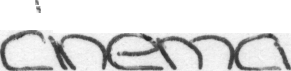

 24%|██▎       | 156/663 [01:46<04:30,  1.88it/s]

Prediction Text: cinema
Image:  iam_words/words/c03/c03-016c/c03-016c-06-03.png
Label: incoherently
Prediction:  incoherently
CER: 0.0; WER: 0.0


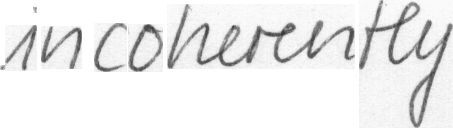

 24%|██▎       | 157/663 [01:46<04:42,  1.79it/s]

Prediction Text: incoherently
Image:  iam_words/words/a01/a01-096u/a01-096u-07-02.png
Label: party's
Prediction:  party's
CER: 0.0; WER: 0.0


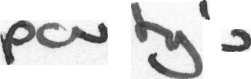

 24%|██▍       | 158/663 [01:47<05:08,  1.64it/s]

Prediction Text: party's
Image:  iam_words/words/c03/c03-000f/c03-000f-03-01.png
Label: produced
Prediction:  produced
CER: 0.0; WER: 0.0


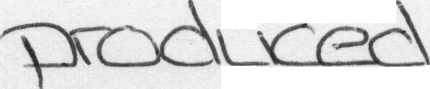

Prediction Text: produced
Image:  iam_words/words/a01/a01-058u/a01-058u-00-06.png
Label: tough
Prediction:  though
CER: 0.2; WER: 1.0


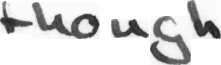

 24%|██▍       | 160/663 [01:48<04:14,  1.98it/s]

Prediction Text: though
Image:  iam_words/words/c03/c03-007e/c03-007e-03-05.png
Label: the
Prediction:  The
CER: 0.3333333333333333; WER: 1.0


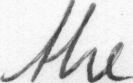

 24%|██▍       | 161/663 [01:49<04:53,  1.71it/s]

Prediction Text: The
Image:  iam_words/words/c03/c03-087a/c03-087a-04-07.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 24%|██▍       | 162/663 [01:49<04:54,  1.70it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-081a/c03-081a-09-03.png
Label: restrained
Prediction:  restrained
CER: 0.0; WER: 0.0


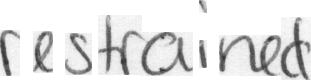

 25%|██▍       | 163/663 [01:50<05:03,  1.65it/s]

Prediction Text: restrained
Image:  iam_words/words/a01/a01-038x/a01-038x-01-08.png
Label: Roy
Prediction:  .
CER: 1.0; WER: 1.0


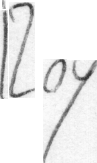

 25%|██▍       | 164/663 [01:51<05:30,  1.51it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-094d/c03-094d-06-02.png
Label: ;
Prediction:  ,
CER: 1.0; WER: 1.0


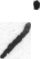

 25%|██▍       | 165/663 [01:52<05:33,  1.49it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-107u/a01-107u-07-01.png
Label: there
Prediction:  there
CER: 0.0; WER: 0.0


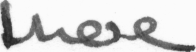

 25%|██▌       | 166/663 [01:52<05:37,  1.47it/s]

Prediction Text: there
Image:  iam_words/words/a01/a01-053u/a01-053u-03-06.png
Label: Robertson
Prediction:  Robertson
CER: 0.0; WER: 0.0


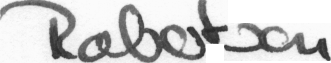

 25%|██▌       | 167/663 [01:53<05:19,  1.55it/s]

Prediction Text: Robertson
Image:  iam_words/words/a01/a01-122u/a01-122u-03-05.png
Label: Let
Prediction:  let
CER: 0.3333333333333333; WER: 1.0


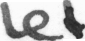

 25%|██▌       | 168/663 [01:54<05:39,  1.46it/s]

Prediction Text: let
Image:  iam_words/words/c03/c03-094a/c03-094a-05-06.png
Label: they
Prediction:  .
CER: 1.0; WER: 1.0


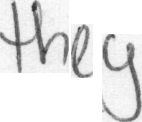

 25%|██▌       | 169/663 [01:54<05:22,  1.53it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-016e/c03-016e-01-06.png
Label: A
Prediction:  ,
CER: 1.0; WER: 1.0


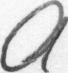

 26%|██▌       | 170/663 [01:55<05:13,  1.57it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-021a/c03-021a-08-02.png
Label: "
Prediction:  .
CER: 1.0; WER: 1.0


 26%|██▌       | 171/663 [01:56<05:32,  1.48it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-007a/c03-007a-06-03.png
Label: the
Prediction:  Te
CER: 0.6666666666666666; WER: 1.0


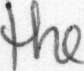

 26%|██▌       | 172/663 [01:56<05:17,  1.55it/s]

Prediction Text: Te
Image:  iam_words/words/c03/c03-003c/c03-003c-08-03.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


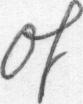

 26%|██▌       | 173/663 [01:57<05:31,  1.48it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-003a/c03-003a-08-01.png
Label: atmosphere
Prediction:  aotmosphere
CER: 0.1; WER: 1.0


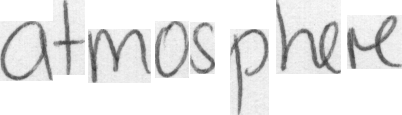

 26%|██▌       | 174/663 [01:58<05:27,  1.49it/s]

Prediction Text: aotmosphere
Image:  iam_words/words/c03/c03-081f/c03-081f-04-07.png
Label: not
Prediction:  nott
CER: 0.3333333333333333; WER: 1.0


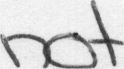

 26%|██▋       | 175/663 [01:58<05:24,  1.50it/s]

Prediction Text: nott
Image:  iam_words/words/c03/c03-087e/c03-087e-06-06.png
Label: a
Prediction:  ,
CER: 1.0; WER: 1.0


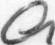

 27%|██▋       | 176/663 [01:59<05:06,  1.59it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-084d/c03-084d-02-01.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


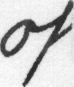

 27%|██▋       | 177/663 [01:59<05:04,  1.59it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-026x/a01-026x-00-06.png
Label: Secretary
Prediction:  !y
CER: 0.8888888888888888; WER: 1.0


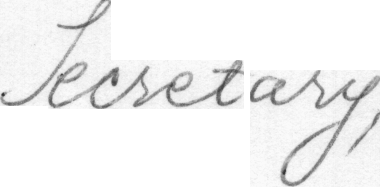

 27%|██▋       | 178/663 [02:00<05:17,  1.53it/s]

Prediction Text: !y
Image:  iam_words/words/c03/c03-021e/c03-021e-08-06.png
Label: need
Prediction:  neld
CER: 0.25; WER: 1.0


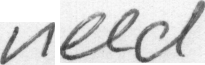

 27%|██▋       | 179/663 [02:01<05:27,  1.48it/s]

Prediction Text: neld
Image:  iam_words/words/a01/a01-020x/a01-020x-07-03.png
Label: function
Prediction:  Janction
CER: 0.25; WER: 1.0


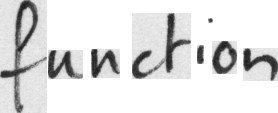

 27%|██▋       | 180/663 [02:02<05:38,  1.43it/s]

Prediction Text: Janction
Image:  iam_words/words/a01/a01-096u/a01-096u-05-01.png
Label: a
Prediction:  "
CER: 1.0; WER: 1.0


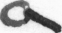

 27%|██▋       | 181/663 [02:02<05:38,  1.42it/s]

Prediction Text: "
Image:  iam_words/words/a01/a01-000x/a01-000x-00-02.png
Label: to
Prediction:  .
CER: 1.0; WER: 1.0


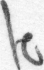

 27%|██▋       | 182/663 [02:03<05:54,  1.36it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-007x/a01-007x-05-03.png
Label: Nationalist
Prediction:  Nationalist
CER: 0.0; WER: 0.0


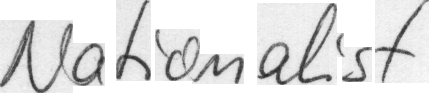

 28%|██▊       | 183/663 [02:04<06:00,  1.33it/s]

Prediction Text: Nationalist
Image:  iam_words/words/c03/c03-081b/c03-081b-02-03.png
Label: would
Prediction:  would
CER: 0.0; WER: 0.0


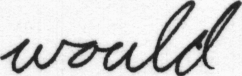

 28%|██▊       | 184/663 [02:04<05:38,  1.42it/s]

Prediction Text: would
Image:  iam_words/words/c03/c03-007a/c03-007a-06-04.png
Label: memory
Prediction:  guemon
CER: 0.6666666666666666; WER: 1.0


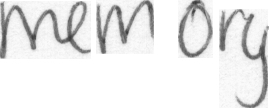

 28%|██▊       | 185/663 [02:05<05:25,  1.47it/s]

Prediction Text: guemon
Image:  iam_words/words/a01/a01-014u/a01-014u-01-02.png
Label: London
Prediction:  London
CER: 0.0; WER: 0.0


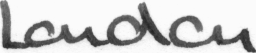

Prediction Text: London
Image:  iam_words/words/c03/c03-084d/c03-084d-01-06.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


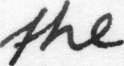

 28%|██▊       | 187/663 [02:06<04:17,  1.85it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-007a/c03-007a-03-05.png
Label: play-grounds
Prediction:  play-grounds
CER: 0.0; WER: 0.0


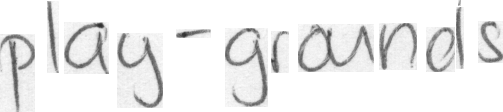

 28%|██▊       | 188/663 [02:07<04:49,  1.64it/s]

Prediction Text: play-grounds
Image:  iam_words/words/c03/c03-087d/c03-087d-04-05.png
Label: in
Prediction:  i
CER: 0.5; WER: 1.0


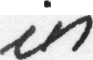

 29%|██▊       | 189/663 [02:07<04:50,  1.63it/s]

Prediction Text: i
Image:  iam_words/words/c03/c03-084e/c03-084e-07-04.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 29%|██▊       | 190/663 [02:08<04:47,  1.64it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-081a/c03-081a-04-07.png
Label: but
Prediction:  Iett
CER: 1.0; WER: 1.0


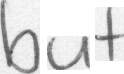

 29%|██▉       | 191/663 [02:09<05:14,  1.50it/s]

Prediction Text: Iett
Image:  iam_words/words/c03/c03-016b/c03-016b-03-00.png
Label: promiscuous
Prediction:  pomiscuous
CER: 0.09090909090909091; WER: 1.0


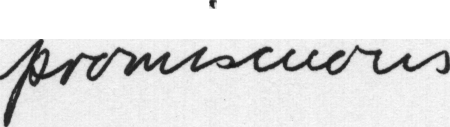

 29%|██▉       | 192/663 [02:09<05:34,  1.41it/s]

Prediction Text: pomiscuous
Image:  iam_words/words/a01/a01-049u/a01-049u-05-00.png
Label: Committee
Prediction:  Committee
CER: 0.0; WER: 0.0


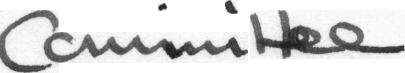

 29%|██▉       | 193/663 [02:10<05:44,  1.37it/s]

Prediction Text: Committee
Image:  iam_words/words/a01/a01-014x/a01-014x-06-05.png
Label: Yesterday
Prediction:  Yevedy
CER: 0.4444444444444444; WER: 1.0


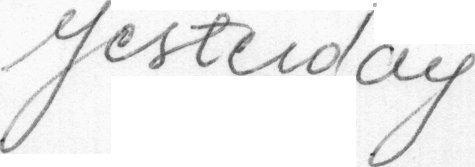

 29%|██▉       | 194/663 [02:11<05:41,  1.37it/s]

Prediction Text: Yevedy
Image:  iam_words/words/c03/c03-087a/c03-087a-04-00.png
Label: around
Prediction:  around
CER: 0.0; WER: 0.0


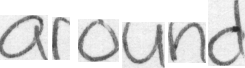

Prediction Text: around
Image:  iam_words/words/c03/c03-016a/c03-016a-07-07.png
Label: case
Prediction:  rase
CER: 0.25; WER: 1.0


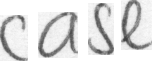

 30%|██▉       | 196/663 [02:12<04:25,  1.76it/s]

Prediction Text: rase
Image:  iam_words/words/c03/c03-087c/c03-087c-06-05.png
Label: way
Prediction:  .
CER: 1.0; WER: 1.0


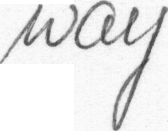

 30%|██▉       | 197/663 [02:14<07:01,  1.11it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-053u/a01-053u-07-00.png
Label: in
Prediction:  .
CER: 1.0; WER: 1.0


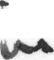

 30%|██▉       | 198/663 [02:15<06:53,  1.12it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-021b/c03-021b-05-09.png
Label: her
Prediction:  t
CER: 1.0; WER: 1.0


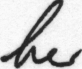

 30%|███       | 199/663 [02:15<06:22,  1.21it/s]

Prediction Text: t
Image:  iam_words/words/c03/c03-081f/c03-081f-06-05.png
Label: effective
Prediction:  effective
CER: 0.0; WER: 0.0


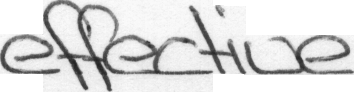

 30%|███       | 200/663 [02:16<05:57,  1.30it/s]

Prediction Text: effective
Image:  iam_words/words/c03/c03-007e/c03-007e-05-05.png
Label: the
Prediction:  The
CER: 0.3333333333333333; WER: 1.0


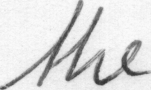

 30%|███       | 201/663 [02:16<05:30,  1.40it/s]

Prediction Text: The
Image:  iam_words/words/c03/c03-003c/c03-003c-08-05.png
Label: city
Prediction:  .
CER: 1.0; WER: 1.0


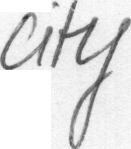

 30%|███       | 202/663 [02:17<05:15,  1.46it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-007a/c03-007a-01-08.png
Label: England
Prediction:  Anglosd
CER: 0.42857142857142855; WER: 1.0


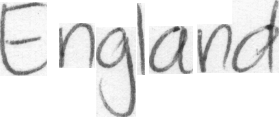

 31%|███       | 203/663 [02:18<05:27,  1.41it/s]

Prediction Text: Anglosd
Image:  iam_words/words/c03/c03-084a/c03-084a-00-00.png
Label: Mr.
Prediction:  I
CER: 1.0; WER: 1.0


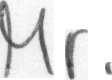

Prediction Text: I
Image:  iam_words/words/a01/a01-020x/a01-020x-02-00.png
Label: blown
Prediction:  bloun
CER: 0.2; WER: 1.0


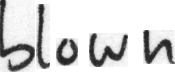

 31%|███       | 205/663 [02:19<04:13,  1.80it/s]

Prediction Text: bloun
Image:  iam_words/words/c03/c03-016a/c03-016a-01-01.png
Label: realism
Prediction:  tealism
CER: 0.14285714285714285; WER: 1.0


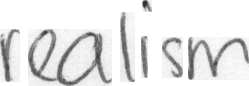

 31%|███       | 206/663 [02:19<04:48,  1.59it/s]

Prediction Text: tealism
Image:  iam_words/words/a01/a01-063x/a01-063x-07-07.png
Label: United
Prediction:  Uited
CER: 0.16666666666666666; WER: 1.0


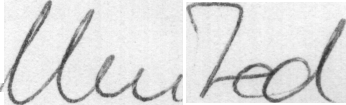

 31%|███       | 207/663 [02:20<05:12,  1.46it/s]

Prediction Text: Uited
Image:  iam_words/words/c03/c03-021d/c03-021d-02-07.png
Label: a
Prediction:  a
CER: 0.0; WER: 0.0


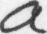

 31%|███▏      | 208/663 [02:21<05:16,  1.44it/s]

Prediction Text: a
Image:  iam_words/words/a01/a01-117u/a01-117u-03-06.png
Label: had
Prediction:  had
CER: 0.0; WER: 0.0


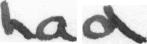

 32%|███▏      | 209/663 [02:22<05:05,  1.48it/s]

Prediction Text: had
Image:  iam_words/words/c03/c03-003a/c03-003a-00-09.png
Label: been
Prediction:  Ween
CER: 0.25; WER: 1.0


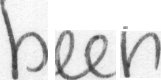

 32%|███▏      | 210/663 [02:22<05:25,  1.39it/s]

Prediction Text: Ween
Image:  iam_words/words/a01/a01-043u/a01-043u-02-05.png
Label: Negro
Prediction:  Negro
CER: 0.0; WER: 0.0


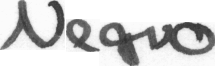

 32%|███▏      | 211/663 [02:23<05:13,  1.44it/s]

Prediction Text: Negro
Image:  iam_words/words/c03/c03-081f/c03-081f-04-04.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 32%|███▏      | 212/663 [02:24<05:11,  1.45it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-000f/c03-000f-05-05.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 32%|███▏      | 213/663 [02:24<04:53,  1.53it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-000b/c03-000b-02-00.png
Label: tomorrow
Prediction:  tommow
CER: 0.375; WER: 1.0


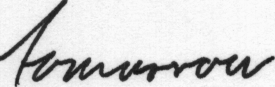

 32%|███▏      | 214/663 [02:25<05:01,  1.49it/s]

Prediction Text: tommow
Image:  iam_words/words/a01/a01-000x/a01-000x-02-04.png
Label: tomorrow
Prediction:  Monural
CER: 0.75; WER: 1.0


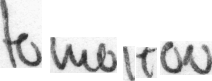

 32%|███▏      | 215/663 [02:26<05:40,  1.31it/s]

Prediction Text: Monural
Image:  iam_words/words/c03/c03-094a/c03-094a-00-05.png
Label: )
Prediction:  .
CER: 1.0; WER: 1.0


Prediction Text: .
Image:  iam_words/words/a01/a01-014u/a01-014u-03-01.png
Label: night
Prediction:  hight
CER: 0.2; WER: 1.0


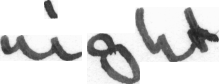

 33%|███▎      | 217/663 [02:27<04:30,  1.65it/s]

Prediction Text: hight
Image:  iam_words/words/a01/a01-058u/a01-058u-00-05.png
Label: get
Prediction:  bet
CER: 0.3333333333333333; WER: 1.0


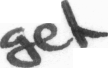

 33%|███▎      | 218/663 [02:28<04:41,  1.58it/s]

Prediction Text: bet
Image:  iam_words/words/c03/c03-087e/c03-087e-06-01.png
Label: attempt
Prediction:  Nattemptt
CER: 0.2857142857142857; WER: 1.0


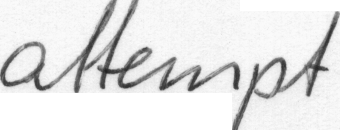

 33%|███▎      | 219/663 [02:28<04:37,  1.60it/s]

Prediction Text: Nattemptt
Image:  iam_words/words/a01/a01-102u/a01-102u-02-04.png
Label: charges
Prediction:  chages
CER: 0.14285714285714285; WER: 1.0


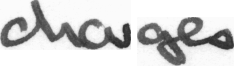

 33%|███▎      | 220/663 [02:29<05:00,  1.47it/s]

Prediction Text: chages
Image:  iam_words/words/c03/c03-016e/c03-016e-06-01.png
Label: time
Prediction:  tine
CER: 0.25; WER: 1.0


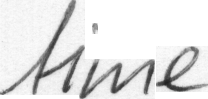

 33%|███▎      | 221/663 [02:30<05:15,  1.40it/s]

Prediction Text: tine
Image:  iam_words/words/a01/a01-122u/a01-122u-08-02.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 33%|███▎      | 222/663 [02:31<05:20,  1.38it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-107u/a01-107u-07-06.png
Label: can
Prediction:  cam
CER: 0.3333333333333333; WER: 1.0


 34%|███▎      | 223/663 [02:31<05:21,  1.37it/s]

Prediction Text: cam
Image:  iam_words/words/c03/c03-021b/c03-021b-04-01.png
Label: acts
Prediction:  Iacht
CER: 0.75; WER: 1.0


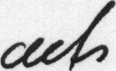

 34%|███▍      | 224/663 [02:32<05:23,  1.36it/s]

Prediction Text: Iacht
Image:  iam_words/words/a01/a01-014u/a01-014u-05-01.png
Label: Sir
Prediction:  Sir
CER: 0.0; WER: 0.0


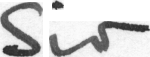

 34%|███▍      | 225/663 [02:33<05:28,  1.33it/s]

Prediction Text: Sir
Image:  iam_words/words/a01/a01-058x/a01-058x-03-03.png
Label: in
Prediction:  i
CER: 0.5; WER: 1.0


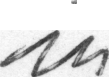

 34%|███▍      | 226/663 [02:33<05:12,  1.40it/s]

Prediction Text: i
Image:  iam_words/words/c03/c03-016a/c03-016a-05-05.png
Label: experiences
Prediction:  experiences
CER: 0.0; WER: 0.0


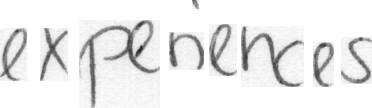

 34%|███▍      | 227/663 [02:34<05:00,  1.45it/s]

Prediction Text: experiences
Image:  iam_words/words/a01/a01-096u/a01-096u-08-05.png
Label: service
Prediction:  service
CER: 0.0; WER: 0.0


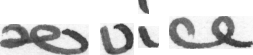

 34%|███▍      | 228/663 [02:35<05:12,  1.39it/s]

Prediction Text: service
Image:  iam_words/words/c03/c03-007e/c03-007e-06-06.png
Label: sacred
Prediction:  sacred
CER: 0.0; WER: 0.0


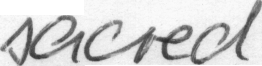

 35%|███▍      | 229/663 [02:35<04:48,  1.50it/s]

Prediction Text: sacred
Image:  iam_words/words/c03/c03-087f/c03-087f-05-01.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 35%|███▍      | 230/663 [02:36<04:58,  1.45it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-107u/a01-107u-03-05.png
Label: and
Prediction:  and
CER: 0.0; WER: 0.0


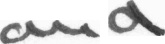

 35%|███▍      | 231/663 [02:37<04:54,  1.47it/s]

Prediction Text: and
Image:  iam_words/words/a01/a01-003x/a01-003x-07-07.png
Label: which
Prediction:  Whell
CER: 0.8; WER: 1.0


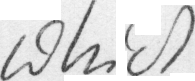

 35%|███▍      | 232/663 [02:38<05:03,  1.42it/s]

Prediction Text: Whell
Image:  iam_words/words/c03/c03-094c/c03-094c-06-07.png
Label: effi-
Prediction:  .
CER: 1.0; WER: 1.0


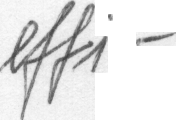

 35%|███▌      | 233/663 [02:38<05:07,  1.40it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-094f/c03-094f-07-00.png
Label: their
Prediction:  Their
CER: 0.2; WER: 1.0


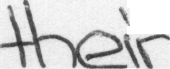

 35%|███▌      | 234/663 [02:39<05:08,  1.39it/s]

Prediction Text: Their
Image:  iam_words/words/a01/a01-011x/a01-011x-08-06.png
Label: policy
Prediction:  ,
CER: 1.0; WER: 1.0


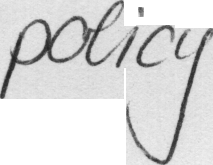

 35%|███▌      | 235/663 [02:40<05:11,  1.38it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-084f/c03-084f-04-01.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


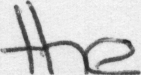

 36%|███▌      | 236/663 [02:40<05:08,  1.39it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-000c/c03-000c-05-05.png
Label: derived
Prediction:  derived
CER: 0.0; WER: 0.0


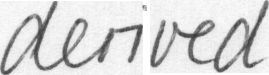

 36%|███▌      | 237/663 [02:41<05:04,  1.40it/s]

Prediction Text: derived
Image:  iam_words/words/c03/c03-021a/c03-021a-04-05.png
Label: expectant
Prediction:  sempectantt
CER: 0.3333333333333333; WER: 1.0


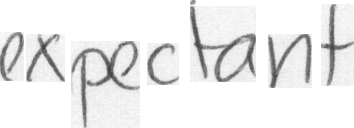

 36%|███▌      | 238/663 [02:42<05:26,  1.30it/s]

Prediction Text: sempectantt
Image:  iam_words/words/a01/a01-128u/a01-128u-10-06.png
Label: cent.
Prediction:  cent
CER: 0.2; WER: 1.0


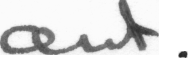

 36%|███▌      | 239/663 [02:43<05:29,  1.29it/s]

Prediction Text: cent
Image:  iam_words/words/c03/c03-000e/c03-000e-06-04.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


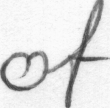

 36%|███▌      | 240/663 [02:44<05:14,  1.34it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-132u/a01-132u-07-02.png
Label: that
Prediction:  that
CER: 0.0; WER: 0.0


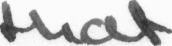

 36%|███▋      | 241/663 [02:44<05:26,  1.29it/s]

Prediction Text: that
Image:  iam_words/words/c03/c03-003a/c03-003a-07-03.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 37%|███▋      | 242/663 [02:45<05:05,  1.38it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-043u/a01-043u-08-03.png
Label: State
Prediction:  State
CER: 0.0; WER: 0.0


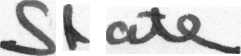

 37%|███▋      | 243/663 [02:46<04:58,  1.41it/s]

Prediction Text: State
Image:  iam_words/words/a01/a01-128u/a01-128u-00-03.png
Label: sat
Prediction:  bt
CER: 0.6666666666666666; WER: 1.0


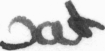

 37%|███▋      | 244/663 [02:47<05:16,  1.33it/s]

Prediction Text: bt
Image:  iam_words/words/a01/a01-132u/a01-132u-06-06.png
Label: foods
Prediction:  foods
CER: 0.0; WER: 0.0


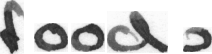

 37%|███▋      | 245/663 [02:47<05:23,  1.29it/s]

Prediction Text: foods
Image:  iam_words/words/a01/a01-087u/a01-087u-07-07.png
Label: that
Prediction:  that
CER: 0.0; WER: 0.0


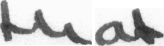

 37%|███▋      | 246/663 [02:48<05:11,  1.34it/s]

Prediction Text: that
Image:  iam_words/words/c03/c03-003b/c03-003b-03-01.png
Label: marriage
Prediction:  mamagg
CER: 0.5; WER: 1.0


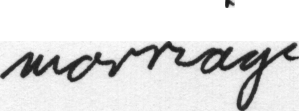

 37%|███▋      | 247/663 [02:49<04:54,  1.41it/s]

Prediction Text: mamagg
Image:  iam_words/words/c03/c03-003b/c03-003b-02-03.png
Label: the
Prediction:  7
CER: 1.0; WER: 1.0


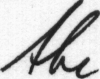

 37%|███▋      | 248/663 [02:49<04:51,  1.42it/s]

Prediction Text: 7
Image:  iam_words/words/a01/a01-058u/a01-058u-06-03.png
Label: get
Prediction:  ,t
CER: 0.6666666666666666; WER: 1.0


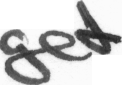

 38%|███▊      | 249/663 [02:50<05:01,  1.37it/s]

Prediction Text: ,t
Image:  iam_words/words/c03/c03-000d/c03-000d-02-06.png
Label: been
Prediction:  been
CER: 0.0; WER: 0.0


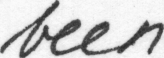

 38%|███▊      | 250/663 [02:51<04:51,  1.42it/s]

Prediction Text: been
Image:  iam_words/words/c03/c03-096c/c03-096c-05-00.png
Label: asking
Prediction:  ,
CER: 1.0; WER: 1.0


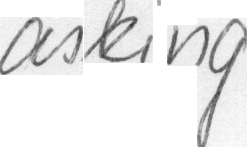

 38%|███▊      | 251/663 [02:52<05:24,  1.27it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-000x/a01-000x-02-01.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


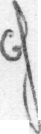

 38%|███▊      | 252/663 [02:52<05:13,  1.31it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-003d/c03-003d-01-03.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


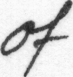

 38%|███▊      | 253/663 [02:53<05:07,  1.33it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-094f/c03-094f-00-00.png
Label: Mr.
Prediction:  I
CER: 1.0; WER: 1.0


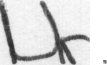

 38%|███▊      | 254/663 [02:54<05:25,  1.26it/s]

Prediction Text: I
Image:  iam_words/words/c03/c03-081b/c03-081b-01-00.png
Label: technical
Prediction:  technical
CER: 0.0; WER: 0.0


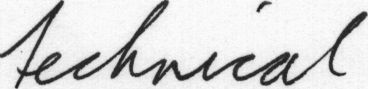

Prediction Text: technical
Image:  iam_words/words/a01/a01-043x/a01-043x-07-00.png
Label: in
Prediction:  .
CER: 1.0; WER: 1.0


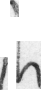

 39%|███▊      | 256/663 [02:55<04:01,  1.69it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-003b/c03-003b-07-07.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 39%|███▉      | 257/663 [02:56<04:14,  1.59it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-043x/a01-043x-05-07.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


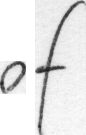

 39%|███▉      | 258/663 [02:56<04:17,  1.57it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-094d/c03-094d-05-01.png
Label: Richards
Prediction:  Richards
CER: 0.0; WER: 0.0


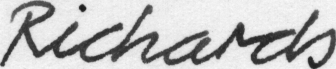

 39%|███▉      | 259/663 [02:57<04:22,  1.54it/s]

Prediction Text: Richards
Image:  iam_words/words/a01/a01-053u/a01-053u-09-01.png
Label: be
Prediction:  be
CER: 0.0; WER: 0.0


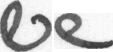

 39%|███▉      | 260/663 [02:58<04:29,  1.50it/s]

Prediction Text: be
Image:  iam_words/words/c03/c03-096c/c03-096c-00-02.png
Label: Lucas's
Prediction:  Lucass
CER: 0.14285714285714285; WER: 1.0


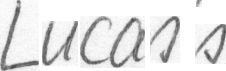

 39%|███▉      | 261/663 [02:58<04:45,  1.41it/s]

Prediction Text: Lucass
Image:  iam_words/words/c03/c03-094f/c03-094f-01-01.png
Label: pushing
Prediction:  pushing
CER: 0.0; WER: 0.0


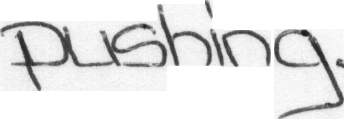

 40%|███▉      | 262/663 [02:59<04:27,  1.50it/s]

Prediction Text: pushing
Image:  iam_words/words/c03/c03-096e/c03-096e-00-06.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


Prediction Text: .
Image:  iam_words/words/c03/c03-016d/c03-016d-06-02.png
Label: time
Prediction:  tine
CER: 0.25; WER: 1.0


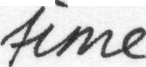

 40%|███▉      | 264/663 [03:00<03:37,  1.84it/s]

Prediction Text: tine
Image:  iam_words/words/a01/a01-113u/a01-113u-05-02.png
Label: easy
Prediction:  easy
CER: 0.0; WER: 0.0


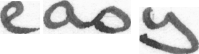

 40%|███▉      | 265/663 [03:00<03:53,  1.70it/s]

Prediction Text: easy
Image:  iam_words/words/a01/a01-132u/a01-132u-08-06.png
Label: regular
Prediction:  regular
CER: 0.0; WER: 0.0


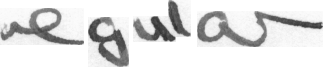

 40%|████      | 266/663 [03:01<04:05,  1.62it/s]

Prediction Text: regular
Image:  iam_words/words/a01/a01-014x/a01-014x-02-06.png
Label: night
Prediction:  gighd
CER: 0.4; WER: 1.0


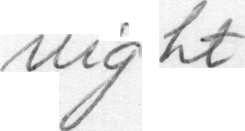

 40%|████      | 267/663 [03:02<04:20,  1.52it/s]

Prediction Text: gighd
Image:  iam_words/words/a01/a01-043x/a01-043x-06-02.png
Label: to
Prediction:  .
CER: 1.0; WER: 1.0


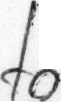

 40%|████      | 268/663 [03:03<04:28,  1.47it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-132u/a01-132u-04-02.png
Label: underpinning
Prediction:  underpinning
CER: 0.0; WER: 0.0


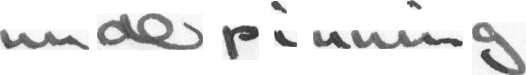

 41%|████      | 269/663 [03:04<04:46,  1.38it/s]

Prediction Text: underpinning
Image:  iam_words/words/c03/c03-087a/c03-087a-05-04.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 41%|████      | 270/663 [03:04<04:36,  1.42it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-113u/a01-113u-04-08.png
Label: comfortable
Prediction:  comfortable
CER: 0.0; WER: 0.0


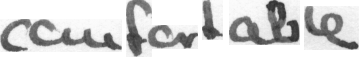

 41%|████      | 271/663 [03:05<04:46,  1.37it/s]

Prediction Text: comfortable
Image:  iam_words/words/a01/a01-003u/a01-003u-07-02.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 41%|████      | 272/663 [03:06<04:42,  1.38it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-096c/c03-096c-06-01.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


Prediction Text: .
Image:  iam_words/words/c03/c03-000d/c03-000d-04-06.png
Label: Delaney
Prediction:  Dlany
CER: 0.2857142857142857; WER: 1.0


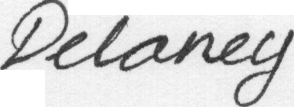

 41%|████▏     | 274/663 [03:06<03:31,  1.84it/s]

Prediction Text: Dlany
Image:  iam_words/words/a01/a01-072u/a01-072u-04-04.png
Label: a
Prediction:  ,
CER: 1.0; WER: 1.0


 41%|████▏     | 275/663 [03:07<03:50,  1.68it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-081e/c03-081e-04-00.png
Label: a
Prediction:  ,
CER: 1.0; WER: 1.0


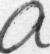

 42%|████▏     | 276/663 [03:08<03:54,  1.65it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-026x/a01-026x-01-00.png
Label: in
Prediction:  Mi
CER: 1.0; WER: 1.0


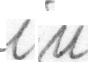

 42%|████▏     | 277/663 [03:08<04:05,  1.57it/s]

Prediction Text: Mi
Image:  iam_words/words/c03/c03-021c/c03-021c-04-05.png
Label: as
Prediction:  .
CER: 1.0; WER: 1.0


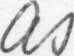

 42%|████▏     | 278/663 [03:09<04:15,  1.50it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-007f/c03-007f-08-03.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


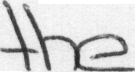

 42%|████▏     | 279/663 [03:10<04:09,  1.54it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-003c/c03-003c-07-03.png
Label: attempted
Prediction:  attempted
CER: 0.0; WER: 0.0


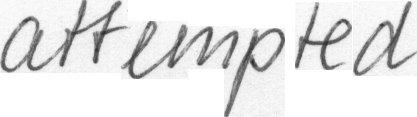

 42%|████▏     | 280/663 [03:10<04:12,  1.52it/s]

Prediction Text: attempted
Image:  iam_words/words/a01/a01-132x/a01-132x-04-04.png
Label: -
Prediction:  .
CER: 1.0; WER: 1.0


 42%|████▏     | 281/663 [03:11<04:35,  1.39it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-021b/c03-021b-00-02.png
Label: the
Prediction:  .
CER: 1.0; WER: 1.0


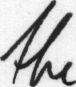

 43%|████▎     | 282/663 [03:12<04:30,  1.41it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-016b/c03-016b-01-09.png
Label: in
Prediction:  ,
CER: 1.0; WER: 1.0


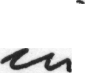

 43%|████▎     | 283/663 [03:13<04:26,  1.42it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-087e/c03-087e-02-03.png
Label: inevitability
Prediction:  inevitability
CER: 0.0; WER: 0.0


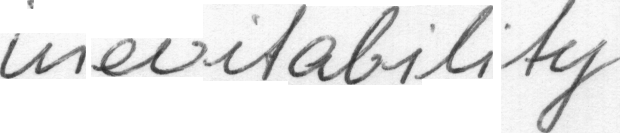

 43%|████▎     | 284/663 [03:13<04:14,  1.49it/s]

Prediction Text: inevitability
Image:  iam_words/words/a01/a01-058u/a01-058u-07-05.png
Label: with
Prediction:  with
CER: 0.0; WER: 0.0


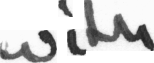

Prediction Text: with
Image:  iam_words/words/c03/c03-007b/c03-007b-03-03.png
Label: ,
Prediction:  '
CER: 1.0; WER: 1.0


 43%|████▎     | 286/663 [03:14<03:07,  2.01it/s]

Prediction Text: '
Image:  iam_words/words/c03/c03-021e/c03-021e-01-01.png
Label: an
Prediction:  an
CER: 0.0; WER: 0.0


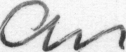

 43%|████▎     | 287/663 [03:15<03:33,  1.76it/s]

Prediction Text: an
Image:  iam_words/words/c03/c03-021f/c03-021f-03-02.png
Label: a
Prediction:  a
CER: 0.0; WER: 0.0


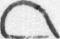

 43%|████▎     | 288/663 [03:15<03:41,  1.69it/s]

Prediction Text: a
Image:  iam_words/words/c03/c03-021d/c03-021d-04-07.png
Label: ,
Prediction:  ,
CER: 0.0; WER: 0.0


 44%|████▎     | 289/663 [03:16<04:02,  1.54it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-007u/a01-007u-02-00.png
Label: sentiment
Prediction:  senfiment
CER: 0.1111111111111111; WER: 1.0


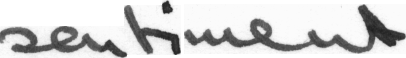

Prediction Text: senfiment
Image:  iam_words/words/c03/c03-096e/c03-096e-01-04.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 44%|████▍     | 291/663 [03:17<03:05,  2.01it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-096u/a01-096u-07-03.png
Label: proposal
Prediction:  propooal
CER: 0.125; WER: 1.0


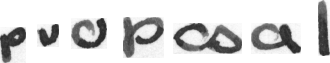

 44%|████▍     | 292/663 [03:17<03:15,  1.90it/s]

Prediction Text: propooal
Image:  iam_words/words/c03/c03-016d/c03-016d-00-05.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


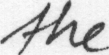

 44%|████▍     | 293/663 [03:18<03:39,  1.69it/s]

Prediction Text: the
Image:  iam_words/words/a01/a01-087u/a01-087u-03-01.png
Label: unemotional
Prediction:  nnetional
CER: 0.2727272727272727; WER: 1.0


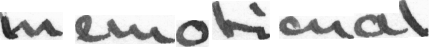

 44%|████▍     | 294/663 [03:19<03:55,  1.57it/s]

Prediction Text: nnetional
Image:  iam_words/words/c03/c03-007a/c03-007a-04-03.png
Label: the
Prediction:  The
CER: 0.3333333333333333; WER: 1.0


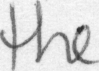

 44%|████▍     | 295/663 [03:20<03:57,  1.55it/s]

Prediction Text: The
Image:  iam_words/words/a01/a01-000x/a01-000x-05-02.png
Label: Manchester
Prediction:  Rhnodheter
CER: 0.5; WER: 1.0


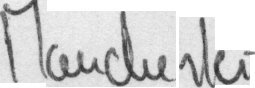

 45%|████▍     | 296/663 [03:20<04:02,  1.51it/s]

Prediction Text: Rhnodheter
Image:  iam_words/words/c03/c03-081d/c03-081d-06-01.png
Label: her
Prediction:  her
CER: 0.0; WER: 0.0


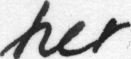

 45%|████▍     | 297/663 [03:21<04:15,  1.43it/s]

Prediction Text: her
Image:  iam_words/words/a01/a01-014u/a01-014u-05-06.png
Label: Mr.
Prediction:  M.
CER: 0.3333333333333333; WER: 1.0


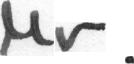

 45%|████▍     | 298/663 [03:22<04:18,  1.41it/s]

Prediction Text: M.
Image:  iam_words/words/a01/a01-058u/a01-058u-03-05.png
Label: that
Prediction:  that
CER: 0.0; WER: 0.0


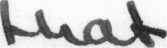

 45%|████▌     | 299/663 [03:22<04:08,  1.47it/s]

Prediction Text: that
Image:  iam_words/words/a01/a01-000u/a01-000u-01-05.png
Label: Peers
Prediction:  Peers
CER: 0.0; WER: 0.0


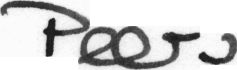

Prediction Text: Peers
Image:  iam_words/words/a01/a01-038x/a01-038x-01-02.png
Label: to
Prediction:  .
CER: 1.0; WER: 1.0


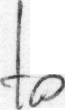

 45%|████▌     | 301/663 [03:23<03:14,  1.86it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-084d/c03-084d-02-02.png
Label: Betti's
Prediction:  Betti's
CER: 0.0; WER: 0.0


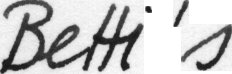

 46%|████▌     | 302/663 [03:24<03:30,  1.72it/s]

Prediction Text: Betti's
Image:  iam_words/words/a01/a01-030u/a01-030u-07-03.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 46%|████▌     | 303/663 [03:25<03:46,  1.59it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-087e/c03-087e-07-04.png
Label: in
Prediction:  ,
CER: 1.0; WER: 1.0


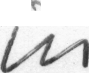

 46%|████▌     | 304/663 [03:25<03:59,  1.50it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-087e/c03-087e-04-01.png
Label: him
Prediction:  thind
CER: 1.0; WER: 1.0


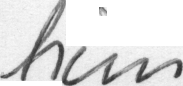

 46%|████▌     | 305/663 [03:26<03:46,  1.58it/s]

Prediction Text: thind
Image:  iam_words/words/c03/c03-000c/c03-000c-02-07.png
Label: and
Prediction:  and
CER: 0.0; WER: 0.0


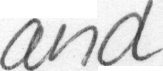

 46%|████▌     | 306/663 [03:27<04:05,  1.46it/s]

Prediction Text: and
Image:  iam_words/words/a01/a01-113u/a01-113u-00-04.png
Label: their
Prediction:  their
CER: 0.0; WER: 0.0


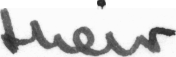

 46%|████▋     | 307/663 [03:28<04:20,  1.37it/s]

Prediction Text: their
Image:  iam_words/words/a01/a01-038x/a01-038x-01-00.png
Label: had
Prediction:  .
CER: 1.0; WER: 1.0


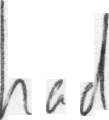

 46%|████▋     | 308/663 [03:28<04:25,  1.34it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-003x/a01-003x-04-07.png
Label: existence
Prediction:  cistancd
CER: 0.4444444444444444; WER: 1.0


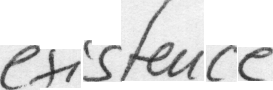

 47%|████▋     | 309/663 [03:29<04:12,  1.40it/s]

Prediction Text: cistancd
Image:  iam_words/words/a01/a01-132x/a01-132x-00-06.png
Label: development
Prediction:  development
CER: 0.0; WER: 0.0


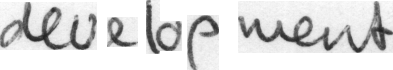

Prediction Text: development
Image:  iam_words/words/c03/c03-096b/c03-096b-05-05.png
Label: us
Prediction:  in
CER: 1.0; WER: 1.0


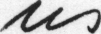

 47%|████▋     | 311/663 [03:30<03:05,  1.90it/s]

Prediction Text: in
Image:  iam_words/words/a01/a01-091u/a01-091u-01-02.png
Label: Tories
Prediction:  Tories
CER: 0.0; WER: 0.0


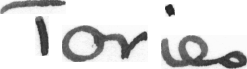

 47%|████▋     | 312/663 [03:30<03:26,  1.70it/s]

Prediction Text: Tories
Image:  iam_words/words/c03/c03-003c/c03-003c-03-03.png
Label: and
Prediction:  ma
CER: 1.0; WER: 1.0


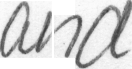

 47%|████▋     | 313/663 [03:31<03:28,  1.68it/s]

Prediction Text: ma
Image:  iam_words/words/c03/c03-096c/c03-096c-05-07.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


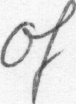

 47%|████▋     | 314/663 [03:32<03:39,  1.59it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-016c/c03-016c-08-01.png
Label: her
Prediction:  su
CER: 1.0; WER: 1.0


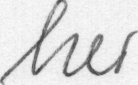

 48%|████▊     | 315/663 [03:32<03:49,  1.52it/s]

Prediction Text: su
Image:  iam_words/words/c03/c03-007e/c03-007e-08-00.png
Label: part
Prediction:  partt
CER: 0.25; WER: 1.0


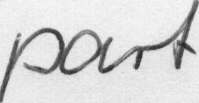

 48%|████▊     | 316/663 [03:33<03:52,  1.49it/s]

Prediction Text: partt
Image:  iam_words/words/c03/c03-084a/c03-084a-03-05.png
Label: in
Prediction:  .
CER: 1.0; WER: 1.0


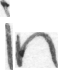

 48%|████▊     | 317/663 [03:34<03:50,  1.50it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-096c/c03-096c-02-00.png
Label: driven
Prediction:  Ariven
CER: 0.16666666666666666; WER: 1.0


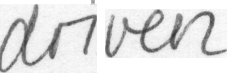

 48%|████▊     | 318/663 [03:34<03:48,  1.51it/s]

Prediction Text: Ariven
Image:  iam_words/words/c03/c03-021e/c03-021e-08-00.png
Label: panionship
Prediction:  panionship
CER: 0.0; WER: 0.0


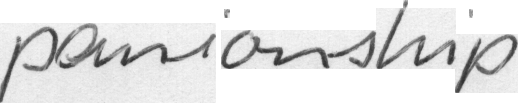

 48%|████▊     | 319/663 [03:35<03:53,  1.48it/s]

Prediction Text: panionship
Image:  iam_words/words/c03/c03-081f/c03-081f-06-06.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 48%|████▊     | 320/663 [03:36<04:00,  1.43it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-087f/c03-087f-00-05.png
Label: some
Prediction:  some
CER: 0.0; WER: 0.0


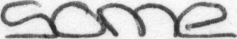

 48%|████▊     | 321/663 [03:37<03:49,  1.49it/s]

Prediction Text: some
Image:  iam_words/words/c03/c03-016b/c03-016b-06-06.png
Label: half
Prediction:  Thalf
CER: 0.25; WER: 1.0


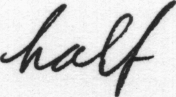

 49%|████▊     | 322/663 [03:37<03:57,  1.43it/s]

Prediction Text: Thalf
Image:  iam_words/words/c03/c03-007e/c03-007e-06-00.png
Label: head-stones
Prediction:  head-stones
CER: 0.0; WER: 0.0


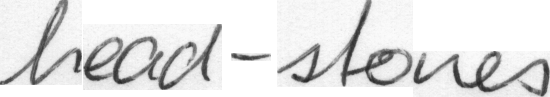

 49%|████▊     | 323/663 [03:38<03:55,  1.44it/s]

Prediction Text: head-stones
Image:  iam_words/words/a01/a01-053u/a01-053u-08-00.png
Label: has
Prediction:  ha
CER: 0.3333333333333333; WER: 1.0


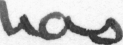

 49%|████▉     | 324/663 [03:39<03:59,  1.41it/s]

Prediction Text: ha
Image:  iam_words/words/a01/a01-043u/a01-043u-01-05.png
Label: today
Prediction:  today
CER: 0.0; WER: 0.0


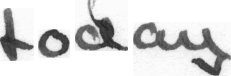

 49%|████▉     | 325/663 [03:39<04:01,  1.40it/s]

Prediction Text: today
Image:  iam_words/words/a01/a01-117u/a01-117u-01-01.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


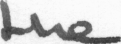

 49%|████▉     | 326/663 [03:40<04:11,  1.34it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-003f/c03-003f-04-01.png
Label: characters
Prediction:  characters
CER: 0.0; WER: 0.0


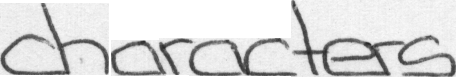

 49%|████▉     | 327/663 [03:41<03:58,  1.41it/s]

Prediction Text: characters
Image:  iam_words/words/a01/a01-087u/a01-087u-04-01.png
Label: statement
Prediction:  statement
CER: 0.0; WER: 0.0


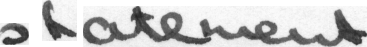

 49%|████▉     | 328/663 [03:42<04:03,  1.37it/s]

Prediction Text: statement
Image:  iam_words/words/c03/c03-087d/c03-087d-05-02.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 50%|████▉     | 329/663 [03:42<03:50,  1.45it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-000c/c03-000c-06-04.png
Label: control
Prediction:  control
CER: 0.0; WER: 0.0


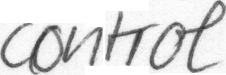

 50%|████▉     | 330/663 [03:43<03:47,  1.46it/s]

Prediction Text: control
Image:  iam_words/words/a01/a01-063x/a01-063x-06-01.png
Label: "
Prediction:  .
CER: 1.0; WER: 1.0


 50%|████▉     | 331/663 [03:44<03:50,  1.44it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-081b/c03-081b-03-03.png
Label: if
Prediction:  ,
CER: 1.0; WER: 1.0


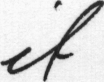

 50%|█████     | 332/663 [03:44<03:40,  1.50it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-087e/c03-087e-07-08.png
Label: mani-
Prediction:  mani-
CER: 0.0; WER: 0.0


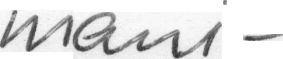

 50%|█████     | 333/663 [03:45<03:53,  1.42it/s]

Prediction Text: mani-
Image:  iam_words/words/c03/c03-096b/c03-096b-00-07.png
Label: arose
Prediction:  arose
CER: 0.0; WER: 0.0


Prediction Text: arose
Image:  iam_words/words/a01/a01-113u/a01-113u-03-04.png
Label: for
Prediction:  fo
CER: 0.3333333333333333; WER: 1.0


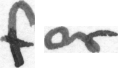

 51%|█████     | 335/663 [03:46<03:06,  1.76it/s]

Prediction Text: fo
Image:  iam_words/words/c03/c03-007e/c03-007e-00-01.png
Label: A
Prediction:  .
CER: 1.0; WER: 1.0


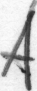

 51%|█████     | 336/663 [03:47<03:27,  1.57it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-016b/c03-016b-06-08.png
Label: and
Prediction:  and
CER: 0.0; WER: 0.0


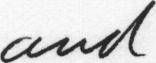

 51%|█████     | 337/663 [03:47<03:30,  1.55it/s]

Prediction Text: and
Image:  iam_words/words/c03/c03-094f/c03-094f-02-07.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 51%|█████     | 338/663 [03:48<03:33,  1.52it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-003e/c03-003e-04-00.png
Label: characters
Prediction:  characters
CER: 0.0; WER: 0.0


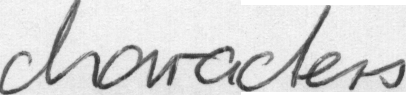

 51%|█████     | 339/663 [03:49<03:37,  1.49it/s]

Prediction Text: characters
Image:  iam_words/words/a01/a01-128u/a01-128u-03-06.png
Label: to
Prediction:  I
CER: 1.0; WER: 1.0


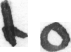

 51%|█████▏    | 340/663 [03:49<03:26,  1.57it/s]

Prediction Text: I
Image:  iam_words/words/c03/c03-096a/c03-096a-08-00.png
Label: tradition
Prediction:  tradition
CER: 0.0; WER: 0.0


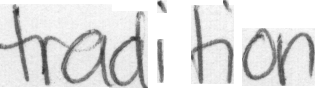

 51%|█████▏    | 341/663 [03:50<03:29,  1.54it/s]

Prediction Text: tradition
Image:  iam_words/words/c03/c03-000b/c03-000b-00-04.png
Label: Miss
Prediction:  Min
CER: 0.5; WER: 1.0


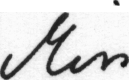

 52%|█████▏    | 342/663 [03:51<03:36,  1.48it/s]

Prediction Text: Min
Image:  iam_words/words/c03/c03-087f/c03-087f-07-02.png
Label: faith
Prediction:  falt
CER: 0.4; WER: 1.0


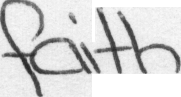

 52%|█████▏    | 343/663 [03:52<04:04,  1.31it/s]

Prediction Text: falt
Image:  iam_words/words/c03/c03-003b/c03-003b-02-00.png
Label: again
Prediction:  .
CER: 1.0; WER: 1.0


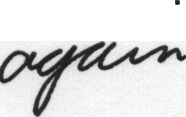

 52%|█████▏    | 344/663 [03:52<04:02,  1.32it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-094b/c03-094b-08-05.png
Label: suitably
Prediction:  suitably
CER: 0.0; WER: 0.0


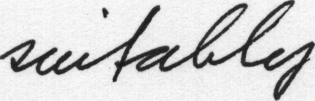

 52%|█████▏    | 345/663 [03:53<03:58,  1.33it/s]

Prediction Text: suitably
Image:  iam_words/words/c03/c03-016d/c03-016d-02-00.png
Label: girl
Prediction:  ,
CER: 1.0; WER: 1.0


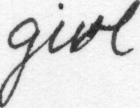

 52%|█████▏    | 346/663 [03:54<03:56,  1.34it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-021e/c03-021e-03-06.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


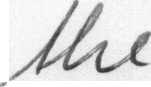

 52%|█████▏    | 347/663 [03:55<03:50,  1.37it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-000c/c03-000c-06-02.png
Label: conception
Prediction:  Coneption
CER: 0.2; WER: 1.0


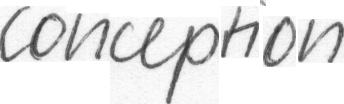

 52%|█████▏    | 348/663 [03:55<03:52,  1.36it/s]

Prediction Text: Coneption
Image:  iam_words/words/c03/c03-016b/c03-016b-03-04.png
Label: such
Prediction:  buch
CER: 0.25; WER: 1.0


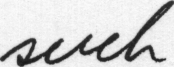

 53%|█████▎    | 349/663 [03:56<03:44,  1.40it/s]

Prediction Text: buch
Image:  iam_words/words/a01/a01-063x/a01-063x-05-01.png
Label: next
Prediction:  bert
CER: 0.5; WER: 1.0


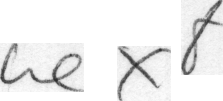

 53%|█████▎    | 350/663 [03:57<03:47,  1.38it/s]

Prediction Text: bert
Image:  iam_words/words/a01/a01-003x/a01-003x-08-08.png
Label: institution
Prediction:  instilution
CER: 0.09090909090909091; WER: 1.0


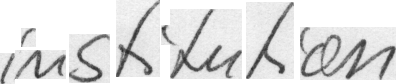

 53%|█████▎    | 351/663 [03:58<03:53,  1.33it/s]

Prediction Text: instilution
Image:  iam_words/words/c03/c03-087d/c03-087d-07-08.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


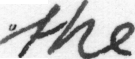

 53%|█████▎    | 352/663 [03:58<03:42,  1.40it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-084d/c03-084d-06-03.png
Label: a
Prediction:  ,
CER: 1.0; WER: 1.0


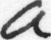

 53%|█████▎    | 353/663 [03:59<03:46,  1.37it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-096e/c03-096e-07-00.png
Label: queer
Prediction:  guer
CER: 0.4; WER: 1.0


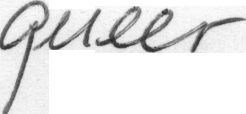

 53%|█████▎    | 354/663 [04:00<03:32,  1.45it/s]

Prediction Text: guer
Image:  iam_words/words/c03/c03-016b/c03-016b-04-01.png
Label: sex
Prediction:  set
CER: 0.3333333333333333; WER: 1.0


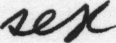

 54%|█████▎    | 355/663 [04:00<03:33,  1.44it/s]

Prediction Text: set
Image:  iam_words/words/c03/c03-087a/c03-087a-06-03.png
Label: had
Prediction:  had
CER: 0.0; WER: 0.0


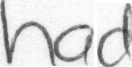

 54%|█████▎    | 356/663 [04:01<03:36,  1.42it/s]

Prediction Text: had
Image:  iam_words/words/a01/a01-003x/a01-003x-01-02.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


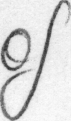

 54%|█████▍    | 357/663 [04:02<03:35,  1.42it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-007x/a01-007x-01-03.png
Label: created
Prediction:  brated
CER: 0.2857142857142857; WER: 1.0


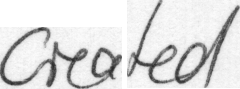

 54%|█████▍    | 358/663 [04:02<03:37,  1.40it/s]

Prediction Text: brated
Image:  iam_words/words/c03/c03-087a/c03-087a-01-05.png
Label: attempting
Prediction:  Natempting
CER: 0.2; WER: 1.0


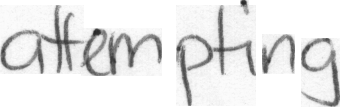

 54%|█████▍    | 359/663 [04:03<03:48,  1.33it/s]

Prediction Text: Natempting
Image:  iam_words/words/c03/c03-016a/c03-016a-02-01.png
Label: lives
Prediction:  Mivese
CER: 0.4; WER: 1.0


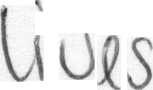

 54%|█████▍    | 360/663 [04:04<03:33,  1.42it/s]

Prediction Text: Mivese
Image:  iam_words/words/c03/c03-087f/c03-087f-05-06.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 54%|█████▍    | 361/663 [04:05<03:30,  1.43it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-053u/a01-053u-09-00.png
Label: can
Prediction:  san
CER: 0.3333333333333333; WER: 1.0


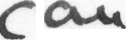

 55%|█████▍    | 362/663 [04:05<03:32,  1.42it/s]

Prediction Text: san
Image:  iam_words/words/c03/c03-007a/c03-007a-06-00.png
Label: "
Prediction:  .
CER: 1.0; WER: 1.0


 55%|█████▍    | 363/663 [04:06<03:38,  1.37it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-058x/a01-058x-09-02.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 55%|█████▍    | 364/663 [04:07<03:25,  1.46it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-003u/a01-003u-07-05.png
Label: that
Prediction:  that
CER: 0.0; WER: 0.0


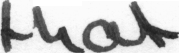

 55%|█████▌    | 365/663 [04:07<03:18,  1.50it/s]

Prediction Text: that
Image:  iam_words/words/c03/c03-021e/c03-021e-08-05.png
Label: you
Prediction:  p
CER: 1.0; WER: 1.0


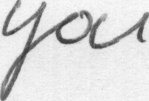

Prediction Text: p
Image:  iam_words/words/c03/c03-003c/c03-003c-02-03.png
Label: it
Prediction:  .
CER: 1.0; WER: 1.0


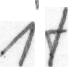

 55%|█████▌    | 367/663 [04:08<02:40,  1.85it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-094a/c03-094a-00-01.png
Label: William
Prediction:  Willianm
CER: 0.14285714285714285; WER: 1.0


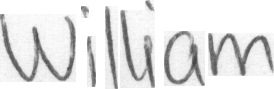

 56%|█████▌    | 368/663 [04:09<02:42,  1.82it/s]

Prediction Text: Willianm
Image:  iam_words/words/c03/c03-000d/c03-000d-01-06.png
Label: at
Prediction:  .
CER: 1.0; WER: 1.0


 56%|█████▌    | 369/663 [04:09<02:49,  1.73it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-007e/c03-007e-03-04.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 56%|█████▌    | 370/663 [04:10<02:57,  1.65it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-016a/c03-016a-05-08.png
Label: the
Prediction:  Tt
CER: 1.0; WER: 1.0


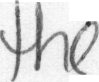

 56%|█████▌    | 371/663 [04:11<03:07,  1.55it/s]

Prediction Text: Tt
Image:  iam_words/words/c03/c03-021d/c03-021d-05-04.png
Label: and
Prediction:  and
CER: 0.0; WER: 0.0


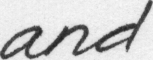

 56%|█████▌    | 372/663 [04:11<03:08,  1.54it/s]

Prediction Text: and
Image:  iam_words/words/c03/c03-007d/c03-007d-02-01.png
Label: and
Prediction:  and
CER: 0.0; WER: 0.0


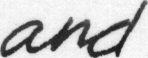

 56%|█████▋    | 373/663 [04:12<03:12,  1.51it/s]

Prediction Text: and
Image:  iam_words/words/c03/c03-081a/c03-081a-03-05.png
Label: if
Prediction:  .
CER: 1.0; WER: 1.0


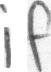

 56%|█████▋    | 374/663 [04:13<03:07,  1.54it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-016d/c03-016d-01-06.png
Label: A
Prediction:  ,
CER: 1.0; WER: 1.0


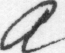

 57%|█████▋    | 375/663 [04:14<03:15,  1.47it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-096d/c03-096d-01-00.png
Label: explicably
Prediction:  explicably
CER: 0.0; WER: 0.0


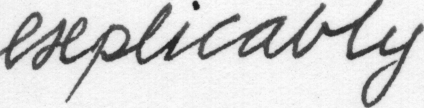

 57%|█████▋    | 376/663 [04:14<03:31,  1.36it/s]

Prediction Text: explicably
Image:  iam_words/words/a01/a01-003u/a01-003u-10-09.png
Label: out-
Prediction:  out
CER: 0.25; WER: 1.0


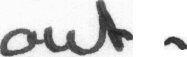

 57%|█████▋    | 377/663 [04:15<03:34,  1.33it/s]

Prediction Text: out
Image:  iam_words/words/c03/c03-016c/c03-016c-09-02.png
Label: bear
Prediction:  beal
CER: 0.25; WER: 1.0


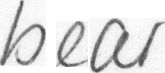

 57%|█████▋    | 378/663 [04:16<03:17,  1.44it/s]

Prediction Text: beal
Image:  iam_words/words/a01/a01-030x/a01-030x-03-07.png
Label: "
Prediction:  "
CER: 0.0; WER: 0.0


 57%|█████▋    | 379/663 [04:16<03:24,  1.39it/s]

Prediction Text: "
Image:  iam_words/words/a01/a01-020x/a01-020x-00-03.png
Label: on
Prediction:  on
CER: 0.0; WER: 0.0


 57%|█████▋    | 380/663 [04:17<03:25,  1.38it/s]

Prediction Text: on
Image:  iam_words/words/a01/a01-030x/a01-030x-01-07.png
Label: the
Prediction:  T
CER: 1.0; WER: 1.0


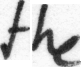

 57%|█████▋    | 381/663 [04:18<03:11,  1.47it/s]

Prediction Text: T
Image:  iam_words/words/c03/c03-016c/c03-016c-01-05.png
Label: .
Prediction:  ,
CER: 1.0; WER: 1.0


 58%|█████▊    | 382/663 [04:18<03:02,  1.54it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-063x/a01-063x-01-04.png
Label: past
Prediction:  ,
CER: 1.0; WER: 1.0


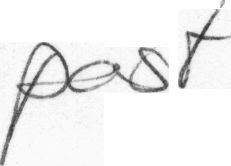

 58%|█████▊    | 383/663 [04:19<03:08,  1.49it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-058u/a01-058u-04-03.png
Label: 357million
Prediction:  357million
CER: 0.0; WER: 0.0


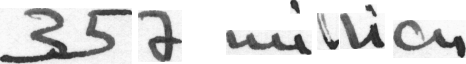

 58%|█████▊    | 384/663 [04:20<03:13,  1.44it/s]

Prediction Text: 357million
Image:  iam_words/words/a01/a01-072u/a01-072u-06-02.png
Label: more
Prediction:  more
CER: 0.0; WER: 0.0


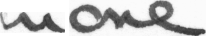

 58%|█████▊    | 385/663 [04:21<03:13,  1.44it/s]

Prediction Text: more
Image:  iam_words/words/a01/a01-058u/a01-058u-04-08.png
Label: enough
Prediction:  enough
CER: 0.0; WER: 0.0


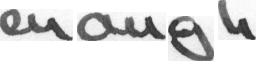

 58%|█████▊    | 386/663 [04:21<03:01,  1.53it/s]

Prediction Text: enough
Image:  iam_words/words/c03/c03-087f/c03-087f-05-05.png
Label: perhaps
Prediction:  perhaps
CER: 0.0; WER: 0.0


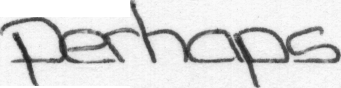

 58%|█████▊    | 387/663 [04:22<03:05,  1.49it/s]

Prediction Text: perhaps
Image:  iam_words/words/c03/c03-081e/c03-081e-04-06.png
Label: seen
Prediction:  seen
CER: 0.0; WER: 0.0


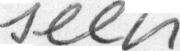

 59%|█████▊    | 388/663 [04:23<03:08,  1.46it/s]

Prediction Text: seen
Image:  iam_words/words/c03/c03-007f/c03-007f-02-04.png
Label: it
Prediction:  .
CER: 1.0; WER: 1.0


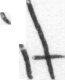

 59%|█████▊    | 389/663 [04:23<02:57,  1.55it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-081b/c03-081b-02-02.png
Label: we
Prediction:  we
CER: 0.0; WER: 0.0


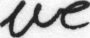

 59%|█████▉    | 390/663 [04:24<02:52,  1.59it/s]

Prediction Text: we
Image:  iam_words/words/c03/c03-007e/c03-007e-04-05.png
Label: and
Prediction:  annd
CER: 0.3333333333333333; WER: 1.0


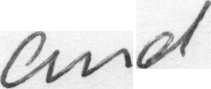

 59%|█████▉    | 391/663 [04:24<03:01,  1.50it/s]

Prediction Text: annd
Image:  iam_words/words/c03/c03-087e/c03-087e-06-02.png
Label: succeeded
Prediction:  suceeded
CER: 0.1111111111111111; WER: 1.0


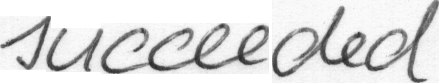

 59%|█████▉    | 392/663 [04:25<03:02,  1.49it/s]

Prediction Text: suceeded
Image:  iam_words/words/c03/c03-016e/c03-016e-01-04.png
Label: situation
Prediction:  situation
CER: 0.0; WER: 0.0


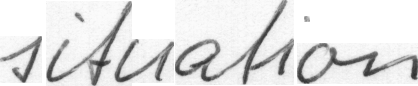

 59%|█████▉    | 393/663 [04:26<03:02,  1.48it/s]

Prediction Text: situation
Image:  iam_words/words/c03/c03-021e/c03-021e-08-02.png
Label: sympathy
Prediction:  sympathy
CER: 0.0; WER: 0.0


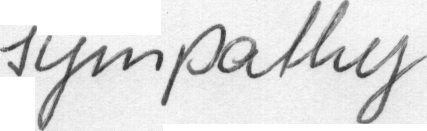

 59%|█████▉    | 394/663 [04:26<02:58,  1.51it/s]

Prediction Text: sympathy
Image:  iam_words/words/a01/a01-091u/a01-091u-09-00.png
Label: Labour
Prediction:  Labour
CER: 0.0; WER: 0.0


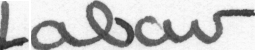

 60%|█████▉    | 395/663 [04:27<02:57,  1.51it/s]

Prediction Text: Labour
Image:  iam_words/words/a01/a01-113u/a01-113u-01-03.png
Label: different
Prediction:  different
CER: 0.0; WER: 0.0


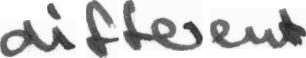

 60%|█████▉    | 396/663 [04:28<03:04,  1.45it/s]

Prediction Text: different
Image:  iam_words/words/a01/a01-068u/a01-068u-00-01.png
Label: they
Prediction:  they
CER: 0.0; WER: 0.0


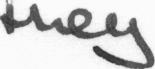

 60%|█████▉    | 397/663 [04:29<03:05,  1.44it/s]

Prediction Text: they
Image:  iam_words/words/c03/c03-016c/c03-016c-09-01.png
Label: to
Prediction:  .
CER: 1.0; WER: 1.0


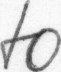

 60%|██████    | 398/663 [04:29<03:08,  1.40it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-122u/a01-122u-08-04.png
Label: in
Prediction:  ,
CER: 1.0; WER: 1.0


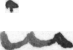

 60%|██████    | 399/663 [04:30<03:23,  1.30it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-016c/c03-016c-04-03.png
Label: sex
Prediction:  se.
CER: 0.3333333333333333; WER: 1.0


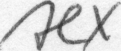

 60%|██████    | 400/663 [04:31<03:22,  1.30it/s]

Prediction Text: se.
Image:  iam_words/words/c03/c03-094c/c03-094c-05-05.png
Label: asked
Prediction:  aked
CER: 0.2; WER: 1.0


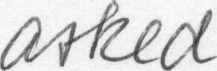

Prediction Text: aked
Image:  iam_words/words/c03/c03-003b/c03-003b-04-10.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 61%|██████    | 402/663 [04:32<02:24,  1.80it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-020x/a01-020x-01-03.png
Label: the
Prediction:  I
CER: 1.0; WER: 1.0


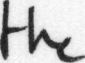

 61%|██████    | 403/663 [04:32<02:32,  1.71it/s]

Prediction Text: I
Image:  iam_words/words/c03/c03-016c/c03-016c-08-00.png
Label: Fanny
Prediction:  !
CER: 1.0; WER: 1.0


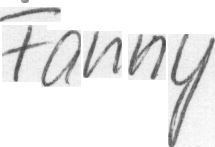

 61%|██████    | 404/663 [04:33<02:46,  1.55it/s]

Prediction Text: !
Image:  iam_words/words/a01/a01-053x/a01-053x-04-04.png
Label: on
Prediction:  on
CER: 0.0; WER: 0.0


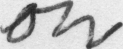

 61%|██████    | 405/663 [04:34<02:53,  1.49it/s]

Prediction Text: on
Image:  iam_words/words/a01/a01-113u/a01-113u-03-01.png
Label: an
Prediction:  an
CER: 0.0; WER: 0.0


 61%|██████    | 406/663 [04:34<02:42,  1.58it/s]

Prediction Text: an
Image:  iam_words/words/c03/c03-087f/c03-087f-00-03.png
Label: perhaps
Prediction:  perhaps
CER: 0.0; WER: 0.0


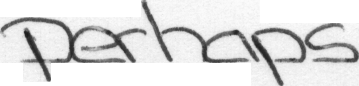

 61%|██████▏   | 407/663 [04:35<02:39,  1.61it/s]

Prediction Text: perhaps
Image:  iam_words/words/a01/a01-132u/a01-132u-00-05.png
Label: either
Prediction:  cither
CER: 0.16666666666666666; WER: 1.0


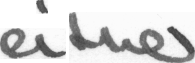

 62%|██████▏   | 408/663 [04:36<02:35,  1.64it/s]

Prediction Text: cither
Image:  iam_words/words/a01/a01-091u/a01-091u-05-06.png
Label: them
Prediction:  them
CER: 0.0; WER: 0.0


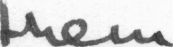

 62%|██████▏   | 409/663 [04:36<02:39,  1.59it/s]

Prediction Text: them
Image:  iam_words/words/a01/a01-026u/a01-026u-00-07.png
Label: ,
Prediction:  ,
CER: 0.0; WER: 0.0


 62%|██████▏   | 410/663 [04:37<02:47,  1.51it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-094b/c03-094b-04-07.png
Label: the
Prediction:  I
CER: 1.0; WER: 1.0


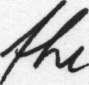

 62%|██████▏   | 411/663 [04:38<02:53,  1.45it/s]

Prediction Text: I
Image:  iam_words/words/c03/c03-021c/c03-021c-00-02.png
Label: the
Prediction:  Th
CER: 0.6666666666666666; WER: 1.0


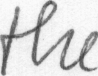

Prediction Text: Th
Image:  iam_words/words/a01/a01-049x/a01-049x-09-07.png
Label: received
Prediction:  received
CER: 0.0; WER: 0.0


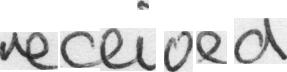

 62%|██████▏   | 413/663 [04:39<02:17,  1.81it/s]

Prediction Text: received
Image:  iam_words/words/a01/a01-026x/a01-026x-03-05.png
Label: conference
Prediction:  sonfereunen
CER: 0.4; WER: 1.0


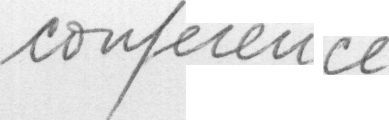

 62%|██████▏   | 414/663 [04:39<02:29,  1.66it/s]

Prediction Text: sonfereunen
Image:  iam_words/words/c03/c03-096a/c03-096a-00-02.png
Label: Lucas's
Prediction:  Lucass
CER: 0.14285714285714285; WER: 1.0


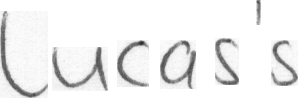

 63%|██████▎   | 415/663 [04:40<02:38,  1.56it/s]

Prediction Text: Lucass
Image:  iam_words/words/c03/c03-016a/c03-016a-06-08.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 63%|██████▎   | 416/663 [04:41<02:46,  1.48it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-096e/c03-096e-01-05.png
Label: The
Prediction:  The
CER: 0.0; WER: 0.0


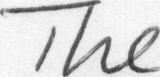

 63%|██████▎   | 417/663 [04:41<02:44,  1.50it/s]

Prediction Text: The
Image:  iam_words/words/c03/c03-087b/c03-087b-00-06.png
Label: distance
Prediction:  distance
CER: 0.0; WER: 0.0


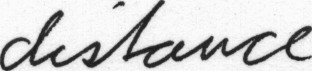

 63%|██████▎   | 418/663 [04:42<02:37,  1.55it/s]

Prediction Text: distance
Image:  iam_words/words/c03/c03-000f/c03-000f-01-00.png
Label: play
Prediction:  pla
CER: 0.25; WER: 1.0


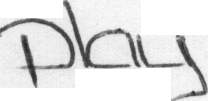

 63%|██████▎   | 419/663 [04:43<02:52,  1.42it/s]

Prediction Text: pla
Image:  iam_words/words/c03/c03-007c/c03-007c-05-07.png
Label: the
Prediction:  Thee
CER: 0.6666666666666666; WER: 1.0


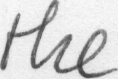

 63%|██████▎   | 420/663 [04:43<02:41,  1.51it/s]

Prediction Text: Thee
Image:  iam_words/words/c03/c03-094d/c03-094d-08-04.png
Label: efficiency
Prediction:  efficency
CER: 0.1; WER: 1.0


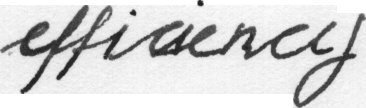

 63%|██████▎   | 421/663 [04:44<02:40,  1.51it/s]

Prediction Text: efficency
Image:  iam_words/words/a01/a01-003u/a01-003u-02-06.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


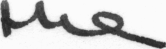

 64%|██████▎   | 422/663 [04:45<02:43,  1.48it/s]

Prediction Text: the
Image:  iam_words/words/a01/a01-128u/a01-128u-09-03.png
Label: Exchequer
Prediction:  Exchequer
CER: 0.0; WER: 0.0


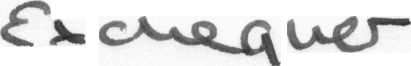

 64%|██████▍   | 423/663 [04:46<02:47,  1.43it/s]

Prediction Text: Exchequer
Image:  iam_words/words/a01/a01-026x/a01-026x-09-03.png
Label: for
Prediction:  .
CER: 1.0; WER: 1.0


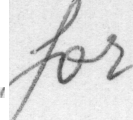

 64%|██████▍   | 424/663 [04:46<02:47,  1.43it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-030x/a01-030x-00-05.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


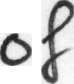

 64%|██████▍   | 425/663 [04:47<03:22,  1.18it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-132x/a01-132x-07-06.png
Label: families
Prediction:  families
CER: 0.0; WER: 0.0


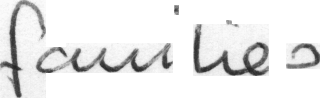

 64%|██████▍   | 426/663 [04:48<03:07,  1.27it/s]

Prediction Text: families
Image:  iam_words/words/a01/a01-053u/a01-053u-03-04.png
Label: to
Prediction:  to
CER: 0.0; WER: 0.0


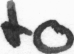

 64%|██████▍   | 427/663 [04:49<03:04,  1.28it/s]

Prediction Text: to
Image:  iam_words/words/c03/c03-096b/c03-096b-07-04.png
Label: of
Prediction:  '
CER: 1.0; WER: 1.0


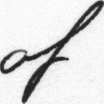

 65%|██████▍   | 428/663 [04:50<03:07,  1.26it/s]

Prediction Text: '
Image:  iam_words/words/c03/c03-003f/c03-003f-00-02.png
Label: not
Prediction:  not
CER: 0.0; WER: 0.0


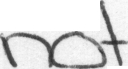

 65%|██████▍   | 429/663 [04:51<03:13,  1.21it/s]

Prediction Text: not
Image:  iam_words/words/c03/c03-081e/c03-081e-05-01.png
Label: heard
Prediction:  thard
CER: 0.4; WER: 1.0


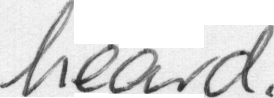

 65%|██████▍   | 430/663 [04:51<03:11,  1.22it/s]

Prediction Text: thard
Image:  iam_words/words/a01/a01-043u/a01-043u-03-02.png
Label: Minister
Prediction:  Minister
CER: 0.0; WER: 0.0


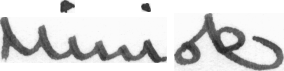

 65%|██████▌   | 431/663 [04:52<03:04,  1.26it/s]

Prediction Text: Minister
Image:  iam_words/words/c03/c03-081c/c03-081c-01-07.png
Label: herself
Prediction:  thsell
CER: 0.5714285714285714; WER: 1.0


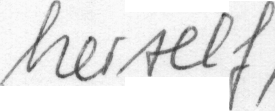

 65%|██████▌   | 432/663 [04:53<02:51,  1.34it/s]

Prediction Text: thsell
Image:  iam_words/words/c03/c03-094a/c03-094a-08-04.png
Label: Richards
Prediction:  Richards
CER: 0.0; WER: 0.0


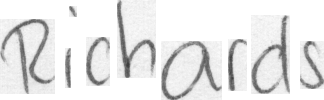

 65%|██████▌   | 433/663 [04:53<02:43,  1.41it/s]

Prediction Text: Richards
Image:  iam_words/words/c03/c03-084d/c03-084d-05-02.png
Label: Then
Prediction:  Then
CER: 0.0; WER: 0.0


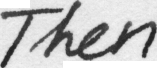

 65%|██████▌   | 434/663 [04:54<02:38,  1.45it/s]

Prediction Text: Then
Image:  iam_words/words/c03/c03-000c/c03-000c-00-02.png
Label: version
Prediction:  version
CER: 0.0; WER: 0.0


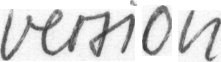

 66%|██████▌   | 435/663 [04:55<02:43,  1.40it/s]

Prediction Text: version
Image:  iam_words/words/a01/a01-007u/a01-007u-09-01.png
Label: Federal
Prediction:  Federal
CER: 0.0; WER: 0.0


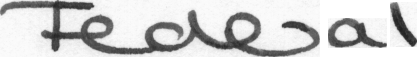

 66%|██████▌   | 436/663 [04:55<02:33,  1.48it/s]

Prediction Text: Federal
Image:  iam_words/words/a01/a01-043x/a01-043x-05-00.png
Label: Robert
Prediction:  MHll
CER: 1.0; WER: 1.0


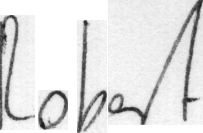

 66%|██████▌   | 437/663 [04:56<02:29,  1.51it/s]

Prediction Text: MHll
Image:  iam_words/words/a01/a01-038x/a01-038x-01-07.png
Label: Sir
Prediction:  .
CER: 1.0; WER: 1.0


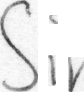

 66%|██████▌   | 438/663 [04:57<02:26,  1.54it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-084e/c03-084e-01-00.png
Label: effective
Prediction:  defetiet
CER: 0.5555555555555556; WER: 1.0


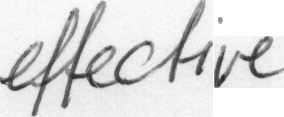

 66%|██████▌   | 439/663 [04:57<02:31,  1.48it/s]

Prediction Text: defetiet
Image:  iam_words/words/a01/a01-058x/a01-058x-02-02.png
Label: balance
Prediction:  belenet
CER: 0.5714285714285714; WER: 1.0


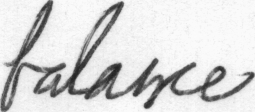

 66%|██████▋   | 440/663 [04:58<02:36,  1.43it/s]

Prediction Text: belenet
Image:  iam_words/words/c03/c03-094f/c03-094f-07-06.png
Label: proper
Prediction:  proper
CER: 0.0; WER: 0.0


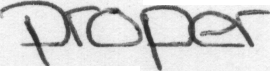

 67%|██████▋   | 441/663 [04:59<02:40,  1.38it/s]

Prediction Text: proper
Image:  iam_words/words/c03/c03-096e/c03-096e-01-00.png
Label: explicably
Prediction:  explically
CER: 0.1; WER: 1.0


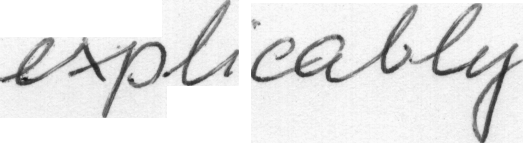

 67%|██████▋   | 442/663 [05:00<02:50,  1.30it/s]

Prediction Text: explically
Image:  iam_words/words/c03/c03-000a/c03-000a-04-02.png
Label: Miss
Prediction:  Misd
CER: 0.25; WER: 1.0


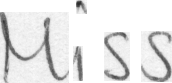

 67%|██████▋   | 443/663 [05:01<02:50,  1.29it/s]

Prediction Text: Misd
Image:  iam_words/words/a01/a01-026u/a01-026u-08-00.png
Label: Welensky
Prediction:  Welensky
CER: 0.0; WER: 0.0


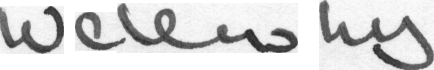

 67%|██████▋   | 444/663 [05:01<02:39,  1.38it/s]

Prediction Text: Welensky
Image:  iam_words/words/a01/a01-117u/a01-117u-02-09.png
Label: percentage
Prediction:  percentage
CER: 0.0; WER: 0.0


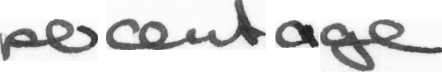

 67%|██████▋   | 445/663 [05:02<02:25,  1.49it/s]

Prediction Text: percentage
Image:  iam_words/words/a01/a01-122u/a01-122u-03-01.png
Label: commented
Prediction:  conmwened
CER: 0.3333333333333333; WER: 1.0


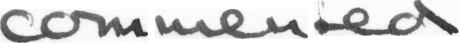

 67%|██████▋   | 446/663 [05:02<02:20,  1.54it/s]

Prediction Text: conmwened
Image:  iam_words/words/c03/c03-021c/c03-021c-07-08.png
Label: someone
Prediction:  someone
CER: 0.0; WER: 0.0


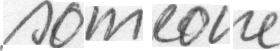

 67%|██████▋   | 447/663 [05:03<02:30,  1.44it/s]

Prediction Text: someone
Image:  iam_words/words/c03/c03-007a/c03-007a-02-03.png
Label: it
Prediction:  .
CER: 1.0; WER: 1.0


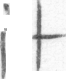

 68%|██████▊   | 448/663 [05:04<02:37,  1.37it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-000b/c03-000b-00-08.png
Label: A
Prediction:  a
CER: 1.0; WER: 1.0


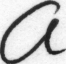

 68%|██████▊   | 449/663 [05:05<02:28,  1.44it/s]

Prediction Text: a
Image:  iam_words/words/a01/a01-007u/a01-007u-03-02.png
Label: House
Prediction:  House
CER: 0.0; WER: 0.0


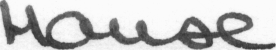

 68%|██████▊   | 450/663 [05:05<02:34,  1.38it/s]

Prediction Text: House
Image:  iam_words/words/c03/c03-081a/c03-081a-07-01.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 68%|██████▊   | 451/663 [05:06<02:34,  1.37it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-128u/a01-128u-02-06.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 68%|██████▊   | 452/663 [05:07<02:44,  1.28it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-021c/c03-021c-00-04.png
Label: girl
Prediction:  ,
CER: 1.0; WER: 1.0


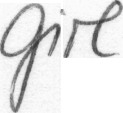

 68%|██████▊   | 453/663 [05:08<02:33,  1.37it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-107u/a01-107u-05-06.png
Label: angry
Prediction:  angry
CER: 0.0; WER: 0.0


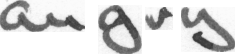

Prediction Text: angry
Image:  iam_words/words/c03/c03-007b/c03-007b-06-07.png
Label: an
Prediction:  an
CER: 0.0; WER: 0.0


 69%|██████▊   | 455/663 [05:08<01:54,  1.81it/s]

Prediction Text: an
Image:  iam_words/words/c03/c03-016e/c03-016e-08-05.png
Label: case
Prediction:  case
CER: 0.0; WER: 0.0


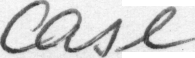

 69%|██████▉   | 456/663 [05:09<02:02,  1.68it/s]

Prediction Text: case
Image:  iam_words/words/c03/c03-003b/c03-003b-02-07.png
Label: the
Prediction:  Tt
CER: 1.0; WER: 1.0


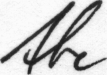

 69%|██████▉   | 457/663 [05:10<02:02,  1.68it/s]

Prediction Text: Tt
Image:  iam_words/words/c03/c03-007e/c03-007e-03-06.png
Label: school
Prediction:  school
CER: 0.0; WER: 0.0


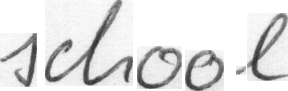

 69%|██████▉   | 458/663 [05:10<02:11,  1.55it/s]

Prediction Text: school
Image:  iam_words/words/a01/a01-007u/a01-007u-00-04.png
Label: Labour
Prediction:  Labour
CER: 0.0; WER: 0.0


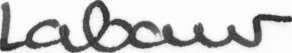

 69%|██████▉   | 459/663 [05:11<02:20,  1.45it/s]

Prediction Text: Labour
Image:  iam_words/words/c03/c03-000f/c03-000f-00-06.png
Label: Delaney's
Prediction:  Delaney's
CER: 0.0; WER: 0.0


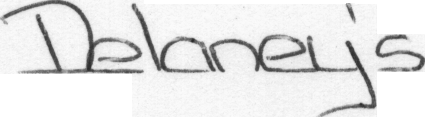

 69%|██████▉   | 460/663 [05:12<02:25,  1.40it/s]

Prediction Text: Delaney's
Image:  iam_words/words/c03/c03-087a/c03-087a-05-00.png
Label: We
Prediction:  N
CER: 1.0; WER: 1.0


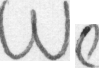

 70%|██████▉   | 461/663 [05:13<02:27,  1.37it/s]

Prediction Text: N
Image:  iam_words/words/a01/a01-128u/a01-128u-02-02.png
Label: on
Prediction:  a
CER: 1.0; WER: 1.0


 70%|██████▉   | 462/663 [05:14<02:33,  1.31it/s]

Prediction Text: a
Image:  iam_words/words/c03/c03-000d/c03-000d-04-05.png
Label: Miss
Prediction:  Miss
CER: 0.0; WER: 0.0


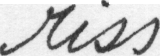

 70%|██████▉   | 463/663 [05:14<02:27,  1.35it/s]

Prediction Text: Miss
Image:  iam_words/words/c03/c03-007d/c03-007d-02-06.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 70%|██████▉   | 464/663 [05:15<02:27,  1.35it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-011u/a01-011u-01-01.png
Label: National
Prediction:  National
CER: 0.0; WER: 0.0


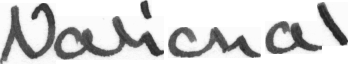

 70%|███████   | 465/663 [05:16<02:35,  1.28it/s]

Prediction Text: National
Image:  iam_words/words/c03/c03-081a/c03-081a-04-06.png
Label: seen
Prediction:  seen
CER: 0.0; WER: 0.0


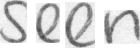

 70%|███████   | 466/663 [05:16<02:23,  1.38it/s]

Prediction Text: seen
Image:  iam_words/words/c03/c03-096d/c03-096d-06-03.png
Label: that
Prediction:  that
CER: 0.0; WER: 0.0


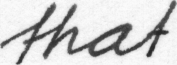

 70%|███████   | 467/663 [05:17<02:16,  1.44it/s]

Prediction Text: that
Image:  iam_words/words/a01/a01-122u/a01-122u-05-03.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 71%|███████   | 468/663 [05:18<02:21,  1.38it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-072x/a01-072x-01-05.png
Label: answer
Prediction:  Anwer
CER: 0.3333333333333333; WER: 1.0


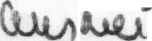

 71%|███████   | 469/663 [05:19<02:21,  1.37it/s]

Prediction Text: Anwer
Image:  iam_words/words/c03/c03-087f/c03-087f-07-06.png
Label: in
Prediction:  ,
CER: 1.0; WER: 1.0


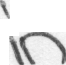

 71%|███████   | 470/663 [05:19<02:23,  1.34it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-021a/c03-021a-04-07.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 71%|███████   | 471/663 [05:20<02:24,  1.33it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-094b/c03-094b-05-01.png
Label: comically
Prediction:  fomnialy
CER: 0.4444444444444444; WER: 1.0


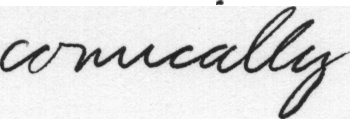

 71%|███████   | 472/663 [05:21<02:27,  1.30it/s]

Prediction Text: fomnialy
Image:  iam_words/words/c03/c03-081c/c03-081c-04-09.png
Label: Miss
Prediction:  MsA
CER: 0.5; WER: 1.0


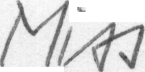

 71%|███████▏  | 473/663 [05:22<02:23,  1.33it/s]

Prediction Text: MsA
Image:  iam_words/words/a01/a01-077u/a01-077u-07-01.png
Label: aides
Prediction:  ades
CER: 0.2; WER: 1.0


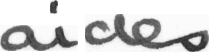

 71%|███████▏  | 474/663 [05:22<02:18,  1.37it/s]

Prediction Text: ades
Image:  iam_words/words/c03/c03-087b/c03-087b-05-06.png
Label: whether
Prediction:  wether
CER: 0.14285714285714285; WER: 1.0


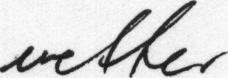

 72%|███████▏  | 475/663 [05:23<02:19,  1.34it/s]

Prediction Text: wether
Image:  iam_words/words/c03/c03-087a/c03-087a-04-01.png
Label: him
Prediction:  thin
CER: 0.6666666666666666; WER: 1.0


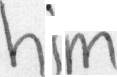

 72%|███████▏  | 476/663 [05:24<02:10,  1.43it/s]

Prediction Text: thin
Image:  iam_words/words/c03/c03-084a/c03-084a-05-07.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 72%|███████▏  | 477/663 [05:25<02:12,  1.41it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-084d/c03-084d-03-05.png
Label: play
Prediction:  payy
CER: 0.5; WER: 1.0


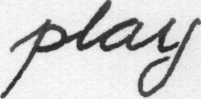

 72%|███████▏  | 478/663 [05:25<02:12,  1.40it/s]

Prediction Text: payy
Image:  iam_words/words/c03/c03-096f/c03-096f-02-05.png
Label: were
Prediction:  were
CER: 0.0; WER: 0.0


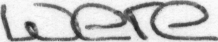

 72%|███████▏  | 479/663 [05:26<02:03,  1.49it/s]

Prediction Text: were
Image:  iam_words/words/a01/a01-020u/a01-020u-00-06.png
Label: conference
Prediction:  conference
CER: 0.0; WER: 0.0


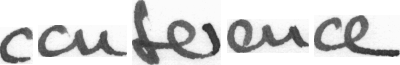

 72%|███████▏  | 480/663 [05:27<02:07,  1.44it/s]

Prediction Text: conference
Image:  iam_words/words/c03/c03-016e/c03-016e-07-05.png
Label: and
Prediction:  and
CER: 0.0; WER: 0.0


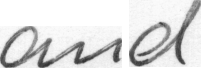

 73%|███████▎  | 481/663 [05:27<02:10,  1.40it/s]

Prediction Text: and
Image:  iam_words/words/a01/a01-063x/a01-063x-06-00.png
Label: Germany's
Prediction:  inot
CER: 0.8888888888888888; WER: 1.0


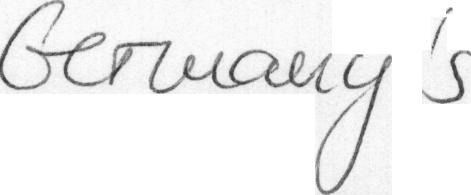

 73%|███████▎  | 482/663 [05:28<02:09,  1.40it/s]

Prediction Text: inot
Image:  iam_words/words/c03/c03-003b/c03-003b-04-05.png
Label: film
Prediction:  .
CER: 1.0; WER: 1.0


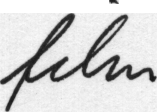

 73%|███████▎  | 483/663 [05:29<02:09,  1.39it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-000a/c03-000a-03-07.png
Label: who
Prediction:  Who
CER: 0.3333333333333333; WER: 1.0


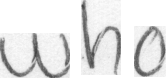

 73%|███████▎  | 484/663 [05:29<02:05,  1.42it/s]

Prediction Text: Who
Image:  iam_words/words/a01/a01-007u/a01-007u-01-03.png
Label: created
Prediction:  created
CER: 0.0; WER: 0.0


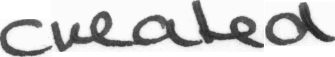

 73%|███████▎  | 485/663 [05:30<02:03,  1.44it/s]

Prediction Text: created
Image:  iam_words/words/c03/c03-087b/c03-087b-00-08.png
Label: most
Prediction:  most
CER: 0.0; WER: 0.0


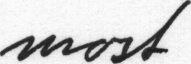

 73%|███████▎  | 486/663 [05:31<02:02,  1.44it/s]

Prediction Text: most
Image:  iam_words/words/a01/a01-082u/a01-082u-02-05.png
Label: claimed
Prediction:  claimed
CER: 0.0; WER: 0.0


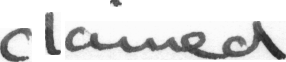

 73%|███████▎  | 487/663 [05:31<02:00,  1.46it/s]

Prediction Text: claimed
Image:  iam_words/words/c03/c03-003f/c03-003f-00-00.png
Label: This
Prediction:  This
CER: 0.0; WER: 0.0


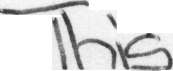

 74%|███████▎  | 488/663 [05:32<01:58,  1.47it/s]

Prediction Text: This
Image:  iam_words/words/a01/a01-049x/a01-049x-06-07.png
Label: today
Prediction:  today
CER: 0.0; WER: 0.0


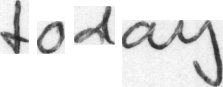

 74%|███████▍  | 489/663 [05:33<02:04,  1.39it/s]

Prediction Text: today
Image:  iam_words/words/c03/c03-007f/c03-007f-05-04.png
Label: -
Prediction:  .
CER: 1.0; WER: 1.0


 74%|███████▍  | 490/663 [05:34<02:07,  1.35it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-068u/a01-068u-04-02.png
Label: is
Prediction:  ,
CER: 1.0; WER: 1.0


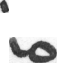

 74%|███████▍  | 491/663 [05:35<02:28,  1.16it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-084d/c03-084d-00-00.png
Label: Mr.
Prediction:  M
CER: 0.6666666666666666; WER: 1.0


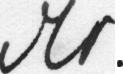

 74%|███████▍  | 492/663 [05:36<02:20,  1.21it/s]

Prediction Text: M
Image:  iam_words/words/c03/c03-003e/c03-003e-02-00.png
Label: and
Prediction:  Land
CER: 0.3333333333333333; WER: 1.0


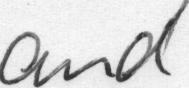

 74%|███████▍  | 493/663 [05:36<02:08,  1.32it/s]

Prediction Text: Land
Image:  iam_words/words/c03/c03-016a/c03-016a-08-04.png
Label: a
Prediction:  ,
CER: 1.0; WER: 1.0


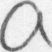

 75%|███████▍  | 494/663 [05:37<01:57,  1.44it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-122u/a01-122u-04-01.png
Label: inquiry
Prediction:  inquiry
CER: 0.0; WER: 0.0


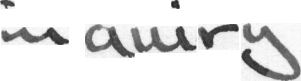

 75%|███████▍  | 495/663 [05:38<01:59,  1.40it/s]

Prediction Text: inquiry
Image:  iam_words/words/a01/a01-030u/a01-030u-00-08.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 75%|███████▍  | 496/663 [05:38<02:02,  1.36it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-087u/a01-087u-01-00.png
Label: led
Prediction:  l
CER: 0.6666666666666666; WER: 1.0


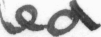

 75%|███████▍  | 497/663 [05:39<02:08,  1.30it/s]

Prediction Text: l
Image:  iam_words/words/c03/c03-081d/c03-081d-02-06.png
Label: altogether
Prediction:  altogether
CER: 0.0; WER: 0.0


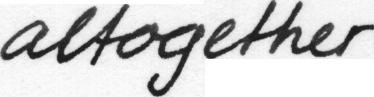

 75%|███████▌  | 498/663 [05:40<02:08,  1.29it/s]

Prediction Text: altogether
Image:  iam_words/words/c03/c03-021b/c03-021b-06-04.png
Label: sympathy
Prediction:  sympathy
CER: 0.0; WER: 0.0


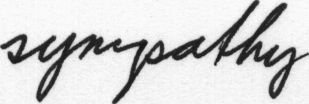

 75%|███████▌  | 499/663 [05:41<02:13,  1.23it/s]

Prediction Text: sympathy
Image:  iam_words/words/c03/c03-094f/c03-094f-06-01.png
Label: were
Prediction:  were
CER: 0.0; WER: 0.0


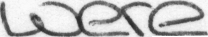

 75%|███████▌  | 500/663 [05:42<02:05,  1.30it/s]

Prediction Text: were
Image:  iam_words/words/a01/a01-058x/a01-058x-02-00.png
Label: help
Prediction:  .
CER: 1.0; WER: 1.0


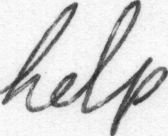

 76%|███████▌  | 501/663 [05:42<01:57,  1.38it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-081a/c03-081a-04-01.png
Label: flawed
Prediction:  flawed
CER: 0.0; WER: 0.0


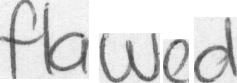

 76%|███████▌  | 502/663 [05:43<01:51,  1.44it/s]

Prediction Text: flawed
Image:  iam_words/words/c03/c03-081f/c03-081f-02-07.png
Label: clearer
Prediction:  clarer
CER: 0.14285714285714285; WER: 1.0


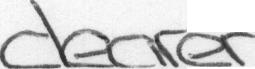

 76%|███████▌  | 503/663 [05:43<01:49,  1.46it/s]

Prediction Text: clarer
Image:  iam_words/words/c03/c03-081b/c03-081b-08-01.png
Label: ,
Prediction:  ,
CER: 0.0; WER: 0.0


 76%|███████▌  | 504/663 [05:44<01:47,  1.48it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-030x/a01-030x-03-06.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 76%|███████▌  | 505/663 [05:45<01:53,  1.40it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-077u/a01-077u-03-05.png
Label: admitted
Prediction:  admitted
CER: 0.0; WER: 0.0


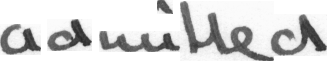

 76%|███████▋  | 506/663 [05:46<01:54,  1.37it/s]

Prediction Text: admitted
Image:  iam_words/words/c03/c03-096e/c03-096e-02-05.png
Label: were
Prediction:  were
CER: 0.0; WER: 0.0


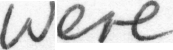

 76%|███████▋  | 507/663 [05:46<01:47,  1.45it/s]

Prediction Text: were
Image:  iam_words/words/c03/c03-096e/c03-096e-03-02.png
Label: in
Prediction:  ,
CER: 1.0; WER: 1.0


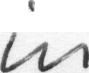

 77%|███████▋  | 508/663 [05:47<01:40,  1.54it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-081b/c03-081b-00-00.png
Label: Arguably
Prediction:  Nepualhy
CER: 0.625; WER: 1.0


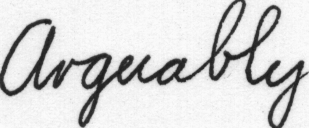

 77%|███████▋  | 509/663 [05:48<01:46,  1.45it/s]

Prediction Text: Nepualhy
Image:  iam_words/words/c03/c03-096f/c03-096f-01-05.png
Label: The
Prediction:  The
CER: 0.0; WER: 0.0


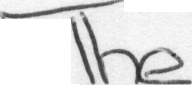

 77%|███████▋  | 510/663 [05:48<01:48,  1.41it/s]

Prediction Text: The
Image:  iam_words/words/a01/a01-011u/a01-011u-09-00.png
Label: is
Prediction:  .
CER: 1.0; WER: 1.0


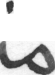

 77%|███████▋  | 511/663 [05:49<01:40,  1.52it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-007f/c03-007f-07-07.png
Label: as
Prediction:  as
CER: 0.0; WER: 0.0


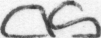

 77%|███████▋  | 512/663 [05:50<01:43,  1.45it/s]

Prediction Text: as
Image:  iam_words/words/a01/a01-053u/a01-053u-02-04.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


Prediction Text: .
Image:  iam_words/words/c03/c03-007e/c03-007e-02-07.png
Label: The
Prediction:  The
CER: 0.0; WER: 0.0


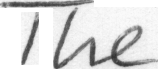

 78%|███████▊  | 514/663 [05:50<01:21,  1.83it/s]

Prediction Text: The
Image:  iam_words/words/c03/c03-094a/c03-094a-05-00.png
Label: law
Prediction:  Muu
CER: 1.0; WER: 1.0


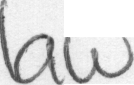

 78%|███████▊  | 515/663 [05:51<01:25,  1.73it/s]

Prediction Text: Muu
Image:  iam_words/words/c03/c03-087f/c03-087f-02-00.png
Label: to
Prediction:  I
CER: 1.0; WER: 1.0


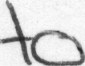

 78%|███████▊  | 516/663 [05:52<01:29,  1.65it/s]

Prediction Text: I
Image:  iam_words/words/a01/a01-026x/a01-026x-09-04.png
Label: talks
Prediction:  tallh
CER: 0.4; WER: 1.0


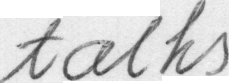

 78%|███████▊  | 517/663 [05:53<01:34,  1.54it/s]

Prediction Text: tallh
Image:  iam_words/words/a01/a01-026u/a01-026u-02-03.png
Label: secret
Prediction:  secret
CER: 0.0; WER: 0.0


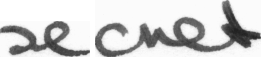

 78%|███████▊  | 518/663 [05:53<01:35,  1.52it/s]

Prediction Text: secret
Image:  iam_words/words/a01/a01-007x/a01-007x-06-02.png
Label: agreed
Prediction:  'ed
CER: 0.6666666666666666; WER: 1.0


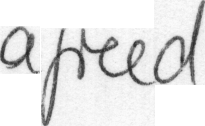

 78%|███████▊  | 519/663 [05:54<01:33,  1.55it/s]

Prediction Text: 'ed
Image:  iam_words/words/a01/a01-043u/a01-043u-00-01.png
Label: talks
Prediction:  talks
CER: 0.0; WER: 0.0


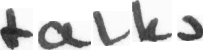

 78%|███████▊  | 520/663 [05:55<01:35,  1.50it/s]

Prediction Text: talks
Image:  iam_words/words/a01/a01-077u/a01-077u-01-00.png
Label: Germany
Prediction:  Germany
CER: 0.0; WER: 0.0


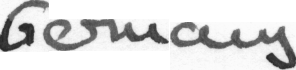

 79%|███████▊  | 521/663 [05:55<01:42,  1.39it/s]

Prediction Text: Germany
Image:  iam_words/words/c03/c03-081b/c03-081b-03-07.png
Label: flawed
Prediction:  faued
CER: 0.3333333333333333; WER: 1.0


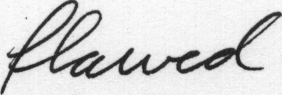

 79%|███████▊  | 522/663 [05:56<01:35,  1.48it/s]

Prediction Text: faued
Image:  iam_words/words/c03/c03-094b/c03-094b-05-04.png
Label: they
Prediction:  !
CER: 1.0; WER: 1.0


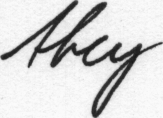

 79%|███████▉  | 523/663 [05:57<01:40,  1.40it/s]

Prediction Text: !
Image:  iam_words/words/c03/c03-016d/c03-016d-08-00.png
Label: is
Prediction:  ,
CER: 1.0; WER: 1.0


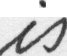

 79%|███████▉  | 524/663 [05:57<01:39,  1.40it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-038x/a01-038x-04-03.png
Label: Macmillan
Prediction:  Monthet
CER: 0.8888888888888888; WER: 1.0


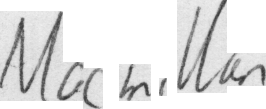

 79%|███████▉  | 525/663 [05:58<01:36,  1.44it/s]

Prediction Text: Monthet
Image:  iam_words/words/c03/c03-003a/c03-003a-00-04.png
Label: filmed
Prediction:  fiined
CER: 0.3333333333333333; WER: 1.0


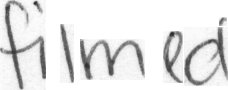

 79%|███████▉  | 526/663 [05:59<01:34,  1.45it/s]

Prediction Text: fiined
Image:  iam_words/words/c03/c03-094b/c03-094b-01-03.png
Label: Miss
Prediction:  Mhint
CER: 0.75; WER: 1.0


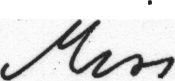

 79%|███████▉  | 527/663 [05:59<01:29,  1.53it/s]

Prediction Text: Mhint
Image:  iam_words/words/a01/a01-026x/a01-026x-06-02.png
Label: Dominion
Prediction:  Dominion
CER: 0.0; WER: 0.0


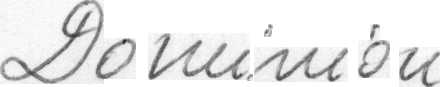

 80%|███████▉  | 528/663 [06:00<01:31,  1.47it/s]

Prediction Text: Dominion
Image:  iam_words/words/c03/c03-003e/c03-003e-02-04.png
Label: it
Prediction:  2f
CER: 1.0; WER: 1.0


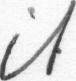

 80%|███████▉  | 529/663 [06:01<01:33,  1.43it/s]

Prediction Text: 2f
Image:  iam_words/words/a01/a01-011u/a01-011u-07-02.png
Label: Northern
Prediction:  Northern
CER: 0.0; WER: 0.0


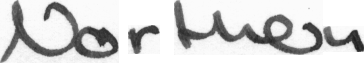

 80%|███████▉  | 530/663 [06:02<01:33,  1.42it/s]

Prediction Text: Northern
Image:  iam_words/words/c03/c03-096a/c03-096a-04-06.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 80%|████████  | 531/663 [06:02<01:36,  1.37it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-026u/a01-026u-06-00.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


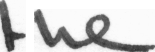

 80%|████████  | 532/663 [06:03<01:35,  1.38it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-016a/c03-016a-02-02.png
Label: in
Prediction:  ,
CER: 1.0; WER: 1.0


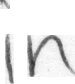

 80%|████████  | 533/663 [06:04<01:28,  1.47it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-000d/c03-000d-05-04.png
Label: and
Prediction:  ad
CER: 0.3333333333333333; WER: 1.0


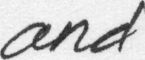

 81%|████████  | 534/663 [06:04<01:28,  1.45it/s]

Prediction Text: ad
Image:  iam_words/words/a01/a01-072u/a01-072u-03-02.png
Label: 357million
Prediction:  357million
CER: 0.0; WER: 0.0


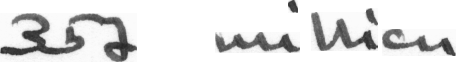

 81%|████████  | 535/663 [06:05<01:29,  1.43it/s]

Prediction Text: 357million
Image:  iam_words/words/a01/a01-049x/a01-049x-04-05.png
Label: Committee
Prediction:  Committee
CER: 0.0; WER: 0.0


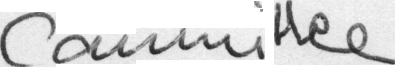

 81%|████████  | 536/663 [06:06<01:34,  1.34it/s]

Prediction Text: Committee
Image:  iam_words/words/c03/c03-000b/c03-000b-02-02.png
Label: It
Prediction:  '
CER: 1.0; WER: 1.0


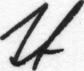

 81%|████████  | 537/663 [06:07<01:33,  1.34it/s]

Prediction Text: '
Image:  iam_words/words/a01/a01-026x/a01-026x-08-00.png
Label: Central
Prediction:  Lentral
CER: 0.14285714285714285; WER: 1.0


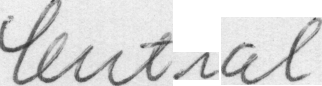

 81%|████████  | 538/663 [06:07<01:35,  1.30it/s]

Prediction Text: Lentral
Image:  iam_words/words/a01/a01-020u/a01-020u-01-05.png
Label: crisis
Prediction:  crisis
CER: 0.0; WER: 0.0


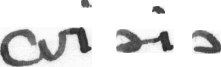

 81%|████████▏ | 539/663 [06:08<01:34,  1.31it/s]

Prediction Text: crisis
Image:  iam_words/words/a01/a01-122u/a01-122u-00-00.png
Label: "
Prediction:  .
CER: 1.0; WER: 1.0


 81%|████████▏ | 540/663 [06:09<01:32,  1.33it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-000x/a01-000x-04-08.png
Label: Will
Prediction:  ZUD
CER: 1.0; WER: 1.0


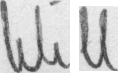

 82%|████████▏ | 541/663 [06:10<01:27,  1.40it/s]

Prediction Text: ZUD
Image:  iam_words/words/c03/c03-094e/c03-094e-03-00.png
Label: the
Prediction:  The
CER: 0.3333333333333333; WER: 1.0


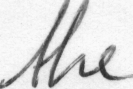

 82%|████████▏ | 542/663 [06:10<01:25,  1.42it/s]

Prediction Text: The
Image:  iam_words/words/a01/a01-020u/a01-020u-03-02.png
Label: plans
Prediction:  plans
CER: 0.0; WER: 0.0


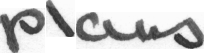

 82%|████████▏ | 543/663 [06:11<01:22,  1.46it/s]

Prediction Text: plans
Image:  iam_words/words/c03/c03-003d/c03-003d-03-08.png
Label: charac-
Prediction:  cortarausce
CER: 0.8571428571428571; WER: 1.0


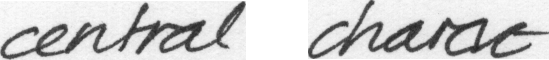

 82%|████████▏ | 544/663 [06:12<01:24,  1.40it/s]

Prediction Text: cortarausce
Image:  iam_words/words/c03/c03-007b/c03-007b-00-08.png
Label: taken
Prediction:  Itlend
CER: 0.8; WER: 1.0


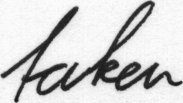

 82%|████████▏ | 545/663 [06:12<01:24,  1.39it/s]

Prediction Text: Itlend
Image:  iam_words/words/c03/c03-081e/c03-081e-00-02.png
Label: the
Prediction:  Tthe
CER: 0.3333333333333333; WER: 1.0


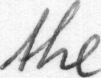

 82%|████████▏ | 546/663 [06:13<01:20,  1.45it/s]

Prediction Text: Tthe
Image:  iam_words/words/a01/a01-000u/a01-000u-04-02.png
Label: a
Prediction:  a
CER: 0.0; WER: 0.0


 83%|████████▎ | 547/663 [06:14<01:21,  1.42it/s]

Prediction Text: a
Image:  iam_words/words/a01/a01-132u/a01-132u-05-04.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


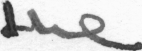

 83%|████████▎ | 548/663 [06:15<01:24,  1.37it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-000b/c03-000b-03-08.png
Label: with
Prediction:  with
CER: 0.0; WER: 0.0


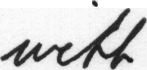

 83%|████████▎ | 549/663 [06:15<01:20,  1.41it/s]

Prediction Text: with
Image:  iam_words/words/c03/c03-094e/c03-094e-02-05.png
Label: James
Prediction:  Jamer
CER: 0.2; WER: 1.0


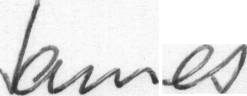

 83%|████████▎ | 550/663 [06:16<01:14,  1.51it/s]

Prediction Text: Jamer
Image:  iam_words/words/c03/c03-016a/c03-016a-01-07.png
Label: young
Prediction:  yaung
CER: 0.2; WER: 1.0


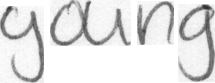

 83%|████████▎ | 551/663 [06:16<01:10,  1.58it/s]

Prediction Text: yaung
Image:  iam_words/words/c03/c03-081e/c03-081e-09-01.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


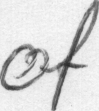

 83%|████████▎ | 552/663 [06:17<01:12,  1.53it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-091u/a01-091u-01-03.png
Label: were
Prediction:  were
CER: 0.0; WER: 0.0


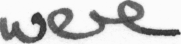

Prediction Text: were
Image:  iam_words/words/a01/a01-014u/a01-014u-00-00.png
Label: Sir
Prediction:  Sir
CER: 0.0; WER: 0.0


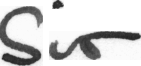

 84%|████████▎ | 554/663 [06:18<00:59,  1.85it/s]

Prediction Text: Sir
Image:  iam_words/words/a01/a01-102u/a01-102u-02-00.png
Label: anybody
Prediction:  anybody
CER: 0.0; WER: 0.0


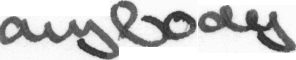

 84%|████████▎ | 555/663 [06:19<01:03,  1.69it/s]

Prediction Text: anybody
Image:  iam_words/words/c03/c03-096d/c03-096d-05-02.png
Label: One
Prediction:  une
CER: 0.3333333333333333; WER: 1.0


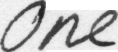

 84%|████████▍ | 556/663 [06:19<01:05,  1.65it/s]

Prediction Text: une
Image:  iam_words/words/c03/c03-096d/c03-096d-05-08.png
Label: asking
Prediction:  asking
CER: 0.0; WER: 0.0


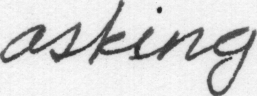

 84%|████████▍ | 557/663 [06:20<01:05,  1.62it/s]

Prediction Text: asking
Image:  iam_words/words/c03/c03-094f/c03-094f-00-03.png
Label: (
Prediction:  ,
CER: 1.0; WER: 1.0


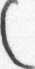

 84%|████████▍ | 558/663 [06:21<01:11,  1.47it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-122u/a01-122u-03-00.png
Label: Brown
Prediction:  Brown
CER: 0.0; WER: 0.0


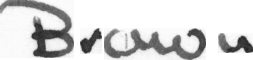

 84%|████████▍ | 559/663 [06:22<01:12,  1.43it/s]

Prediction Text: Brown
Image:  iam_words/words/a01/a01-122u/a01-122u-07-00.png
Label: food
Prediction:  food
CER: 0.0; WER: 0.0


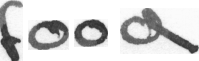

 84%|████████▍ | 560/663 [06:22<01:16,  1.35it/s]

Prediction Text: food
Image:  iam_words/words/a01/a01-049u/a01-049u-00-01.png
Label: Allen
Prediction:  Allen
CER: 0.0; WER: 0.0


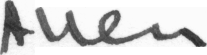

Prediction Text: Allen
Image:  iam_words/words/c03/c03-000a/c03-000a-03-00.png
Label: an
Prediction:  a
CER: 0.5; WER: 1.0


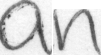

 85%|████████▍ | 562/663 [06:23<00:58,  1.74it/s]

Prediction Text: a
Image:  iam_words/words/a01/a01-003u/a01-003u-02-07.png
Label: Foot-
Prediction:  Foot-
CER: 0.0; WER: 0.0


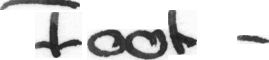

 85%|████████▍ | 563/663 [06:24<01:03,  1.57it/s]

Prediction Text: Foot-
Image:  iam_words/words/c03/c03-021c/c03-021c-08-00.png
Label: to
Prediction:  .
CER: 1.0; WER: 1.0


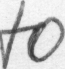

 85%|████████▌ | 564/663 [06:25<01:04,  1.54it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-084d/c03-084d-03-04.png
Label: night's
Prediction:  hiight't
CER: 0.42857142857142855; WER: 1.0


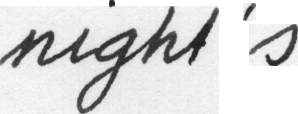

 85%|████████▌ | 565/663 [06:26<01:09,  1.40it/s]

Prediction Text: hiight't
Image:  iam_words/words/a01/a01-003u/a01-003u-07-01.png
Label: nominees
Prediction:  nominees
CER: 0.0; WER: 0.0


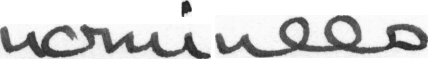

 85%|████████▌ | 566/663 [06:26<01:06,  1.45it/s]

Prediction Text: nominees
Image:  iam_words/words/a01/a01-117u/a01-117u-06-03.png
Label: Powell
Prediction:  Powell
CER: 0.0; WER: 0.0


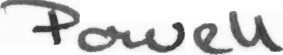

 86%|████████▌ | 567/663 [06:27<01:07,  1.42it/s]

Prediction Text: Powell
Image:  iam_words/words/c03/c03-007e/c03-007e-05-00.png
Label: rubbish
Prediction:  rubbist
CER: 0.14285714285714285; WER: 1.0


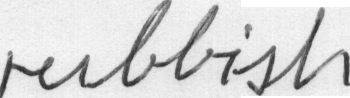

 86%|████████▌ | 568/663 [06:27<01:03,  1.49it/s]

Prediction Text: rubbist
Image:  iam_words/words/a01/a01-102u/a01-102u-07-02.png
Label: from
Prediction:  from
CER: 0.0; WER: 0.0


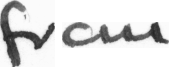

 86%|████████▌ | 569/663 [06:28<01:06,  1.40it/s]

Prediction Text: from
Image:  iam_words/words/c03/c03-081f/c03-081f-07-07.png
Label: and
Prediction:  and
CER: 0.0; WER: 0.0


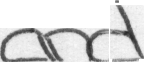

 86%|████████▌ | 570/663 [06:29<01:03,  1.46it/s]

Prediction Text: and
Image:  iam_words/words/c03/c03-081d/c03-081d-06-00.png
Label: makes
Prediction:  makes
CER: 0.0; WER: 0.0


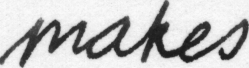

 86%|████████▌ | 571/663 [06:30<01:06,  1.39it/s]

Prediction Text: makes
Image:  iam_words/words/c03/c03-003d/c03-003d-01-02.png
Label: terms
Prediction:  terms
CER: 0.0; WER: 0.0


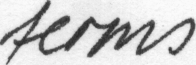

 86%|████████▋ | 572/663 [06:30<01:06,  1.37it/s]

Prediction Text: terms
Image:  iam_words/words/c03/c03-087b/c03-087b-03-05.png
Label: the
Prediction:  th
CER: 0.3333333333333333; WER: 1.0


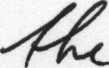

 86%|████████▋ | 573/663 [06:31<01:03,  1.43it/s]

Prediction Text: th
Image:  iam_words/words/a01/a01-058u/a01-058u-05-05.png
Label: Government
Prediction:  Government
CER: 0.0; WER: 0.0


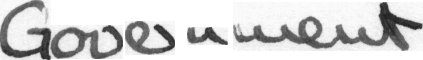

 87%|████████▋ | 574/663 [06:32<01:04,  1.39it/s]

Prediction Text: Government
Image:  iam_words/words/c03/c03-081a/c03-081a-08-03.png
Label: sergeant
Prediction:  Dergantt
CER: 0.375; WER: 1.0


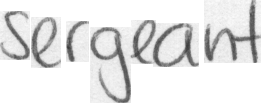

 87%|████████▋ | 575/663 [06:32<01:00,  1.46it/s]

Prediction Text: Dergantt
Image:  iam_words/words/c03/c03-094b/c03-094b-02-06.png
Label: Mr.
Prediction:  M.
CER: 0.3333333333333333; WER: 1.0


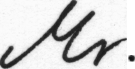

 87%|████████▋ | 576/663 [06:33<01:01,  1.41it/s]

Prediction Text: M.
Image:  iam_words/words/a01/a01-053u/a01-053u-08-01.png
Label: to
Prediction:  to
CER: 0.0; WER: 0.0


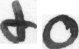

 87%|████████▋ | 577/663 [06:34<01:02,  1.38it/s]

Prediction Text: to
Image:  iam_words/words/a01/a01-082u/a01-082u-03-03.png
Label: Eisenhower
Prediction:  Gsenower
CER: 0.3; WER: 1.0


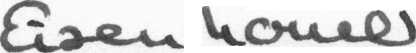

 87%|████████▋ | 578/663 [06:35<01:03,  1.34it/s]

Prediction Text: Gsenower
Image:  iam_words/words/c03/c03-096f/c03-096f-00-02.png
Label: Lucas's
Prediction:  Lucas's
CER: 0.0; WER: 0.0


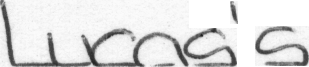

 87%|████████▋ | 579/663 [06:36<01:02,  1.34it/s]

Prediction Text: Lucas's
Image:  iam_words/words/c03/c03-094a/c03-094a-01-02.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 87%|████████▋ | 580/663 [06:36<00:57,  1.44it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-096f/c03-096f-08-00.png
Label: foreigners
Prediction:  frreigners
CER: 0.1; WER: 1.0


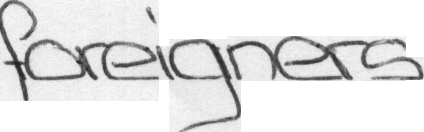

 88%|████████▊ | 581/663 [06:37<00:57,  1.44it/s]

Prediction Text: frreigners
Image:  iam_words/words/c03/c03-016d/c03-016d-09-02.png
Label: her
Prediction:  the
CER: 0.6666666666666666; WER: 1.0


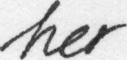

 88%|████████▊ | 582/663 [06:38<00:56,  1.43it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-087d/c03-087d-00-05.png
Label: some
Prediction:  some
CER: 0.0; WER: 0.0


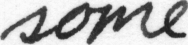

 88%|████████▊ | 583/663 [06:38<00:56,  1.42it/s]

Prediction Text: some
Image:  iam_words/words/a01/a01-020u/a01-020u-07-02.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


Prediction Text: .
Image:  iam_words/words/c03/c03-084f/c03-084f-03-05.png
Label: play
Prediction:  ,
CER: 1.0; WER: 1.0


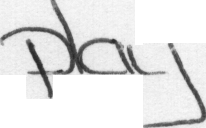

 88%|████████▊ | 585/663 [06:39<00:41,  1.88it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-020x/a01-020x-08-02.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 88%|████████▊ | 586/663 [06:39<00:41,  1.86it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-072u/a01-072u-07-08.png
Label: in
Prediction:  ,
CER: 1.0; WER: 1.0


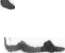

 89%|████████▊ | 587/663 [06:40<00:43,  1.73it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-087d/c03-087d-04-02.png
Label: world
Prediction:  world
CER: 0.0; WER: 0.0


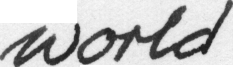

 89%|████████▊ | 588/663 [06:41<00:43,  1.74it/s]

Prediction Text: world
Image:  iam_words/words/c03/c03-094a/c03-094a-08-03.png
Label: Mr.
Prediction:  H
CER: 1.0; WER: 1.0


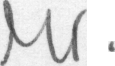

 89%|████████▉ | 589/663 [06:42<00:47,  1.56it/s]

Prediction Text: H
Image:  iam_words/words/c03/c03-084a/c03-084a-07-04.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 89%|████████▉ | 590/663 [06:42<00:46,  1.57it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-021a/c03-021a-02-05.png
Label: moved
Prediction:  moved
CER: 0.0; WER: 0.0


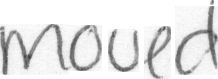

 89%|████████▉ | 591/663 [06:43<00:49,  1.46it/s]

Prediction Text: moved
Image:  iam_words/words/c03/c03-007b/c03-007b-02-05.png
Label: The
Prediction:  T
CER: 0.6666666666666666; WER: 1.0


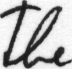

 89%|████████▉ | 592/663 [06:44<00:52,  1.36it/s]

Prediction Text: T
Image:  iam_words/words/c03/c03-021e/c03-021e-02-06.png
Label: yet
Prediction:  .
CER: 1.0; WER: 1.0


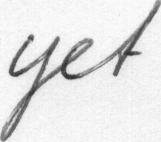

 89%|████████▉ | 593/663 [06:45<00:51,  1.36it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-021b/c03-021b-05-05.png
Label: her
Prediction:  '
CER: 1.0; WER: 1.0


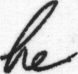

 90%|████████▉ | 594/663 [06:45<00:48,  1.41it/s]

Prediction Text: '
Image:  iam_words/words/a01/a01-003x/a01-003x-08-05.png
Label: "
Prediction:  .
CER: 1.0; WER: 1.0


 90%|████████▉ | 595/663 [06:46<00:49,  1.37it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-043x/a01-043x-01-04.png
Label: today
Prediction:  .
CER: 1.0; WER: 1.0


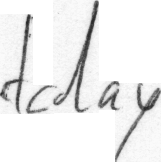

 90%|████████▉ | 596/663 [06:46<00:45,  1.49it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-087a/c03-087a-01-03.png
Label: subject
Prediction:  bubjectt
CER: 0.2857142857142857; WER: 1.0


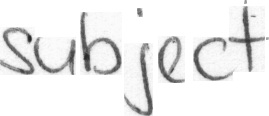

 90%|█████████ | 597/663 [06:47<00:45,  1.45it/s]

Prediction Text: bubjectt
Image:  iam_words/words/c03/c03-087e/c03-087e-00-06.png
Label: distance
Prediction:  distance
CER: 0.0; WER: 0.0


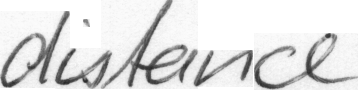

 90%|█████████ | 598/663 [06:48<00:44,  1.46it/s]

Prediction Text: distance
Image:  iam_words/words/c03/c03-094d/c03-094d-02-01.png
Label: wife
Prediction:  wife
CER: 0.0; WER: 0.0


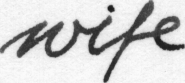

 90%|█████████ | 599/663 [06:49<00:45,  1.41it/s]

Prediction Text: wife
Image:  iam_words/words/c03/c03-003a/c03-003a-07-04.png
Label: attempted
Prediction:  ietemphod
CER: 0.4444444444444444; WER: 1.0


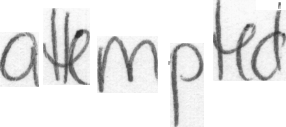

 90%|█████████ | 600/663 [06:50<00:47,  1.33it/s]

Prediction Text: ietemphod
Image:  iam_words/words/c03/c03-021e/c03-021e-04-07.png
Label: mother
Prediction:  mother
CER: 0.0; WER: 0.0


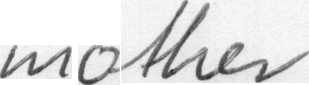

 91%|█████████ | 601/663 [06:50<00:48,  1.27it/s]

Prediction Text: mother
Image:  iam_words/words/c03/c03-081e/c03-081e-04-02.png
Label: but
Prediction:  but
CER: 0.0; WER: 0.0


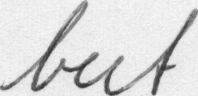

 91%|█████████ | 602/663 [06:51<00:45,  1.34it/s]

Prediction Text: but
Image:  iam_words/words/a01/a01-087u/a01-087u-01-03.png
Label: on
Prediction:  a
CER: 1.0; WER: 1.0


 91%|█████████ | 603/663 [06:52<00:44,  1.36it/s]

Prediction Text: a
Image:  iam_words/words/a01/a01-117u/a01-117u-07-04.png
Label: it
Prediction:  it
CER: 0.0; WER: 0.0


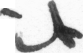

 91%|█████████ | 604/663 [06:52<00:43,  1.36it/s]

Prediction Text: it
Image:  iam_words/words/a01/a01-011u/a01-011u-07-01.png
Label: in
Prediction:  ,
CER: 1.0; WER: 1.0


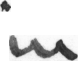

 91%|█████████▏| 605/663 [06:54<00:55,  1.05it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-007c/c03-007c-06-02.png
Label: "
Prediction:  .
CER: 1.0; WER: 1.0


 91%|█████████▏| 606/663 [06:55<00:48,  1.17it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-000b/c03-000b-00-02.png
Label: version
Prediction:  hemenn
CER: 0.7142857142857143; WER: 1.0


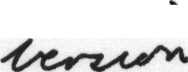

 92%|█████████▏| 607/663 [06:55<00:44,  1.25it/s]

Prediction Text: hemenn
Image:  iam_words/words/c03/c03-081f/c03-081f-09-04.png
Label: and
Prediction:  and
CER: 0.0; WER: 0.0


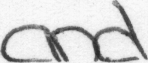

 92%|█████████▏| 608/663 [06:56<00:41,  1.32it/s]

Prediction Text: and
Image:  iam_words/words/c03/c03-087c/c03-087c-06-00.png
Label: little
Prediction:  Mitlee
CER: 0.5; WER: 1.0


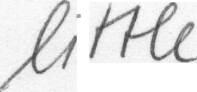

 92%|█████████▏| 609/663 [06:56<00:38,  1.42it/s]

Prediction Text: Mitlee
Image:  iam_words/words/c03/c03-003d/c03-003d-05-08.png
Label: ,
Prediction:  ,
CER: 0.0; WER: 0.0


 92%|█████████▏| 610/663 [06:57<00:35,  1.50it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-016d/c03-016d-09-00.png
Label: who
Prediction:  Whoo
CER: 0.6666666666666666; WER: 1.0


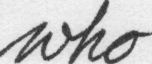

 92%|█████████▏| 611/663 [06:58<00:35,  1.48it/s]

Prediction Text: Whoo
Image:  iam_words/words/a01/a01-026u/a01-026u-00-04.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


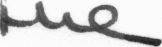

 92%|█████████▏| 612/663 [06:58<00:33,  1.53it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-003f/c03-003f-05-02.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


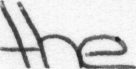

 92%|█████████▏| 613/663 [06:59<00:35,  1.42it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-096b/c03-096b-03-04.png
Label: spite
Prediction:  hopld
CER: 1.0; WER: 1.0


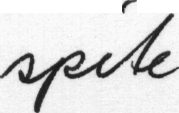

Prediction Text: hopld
Image:  iam_words/words/c03/c03-016a/c03-016a-01-06.png
Label: A
Prediction:  .
CER: 1.0; WER: 1.0


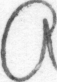

 93%|█████████▎| 615/663 [07:00<00:27,  1.73it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-081b/c03-081b-07-00.png
Label: the
Prediction:  T
CER: 1.0; WER: 1.0


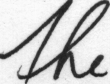

 93%|█████████▎| 616/663 [07:01<00:27,  1.73it/s]

Prediction Text: T
Image:  iam_words/words/c03/c03-084a/c03-084a-01-01.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 93%|█████████▎| 617/663 [07:01<00:28,  1.63it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-007e/c03-007e-04-03.png
Label: public
Prediction:  pulliec
CER: 0.3333333333333333; WER: 1.0


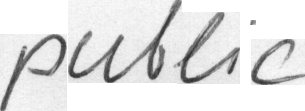

 93%|█████████▎| 618/663 [07:02<00:29,  1.54it/s]

Prediction Text: pulliec
Image:  iam_words/words/a01/a01-117u/a01-117u-05-02.png
Label: swung
Prediction:  swung
CER: 0.0; WER: 0.0


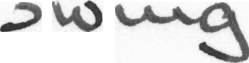

 93%|█████████▎| 619/663 [07:03<00:29,  1.48it/s]

Prediction Text: swung
Image:  iam_words/words/a01/a01-053u/a01-053u-05-03.png
Label: Weaver
Prediction:  Weaver
CER: 0.0; WER: 0.0


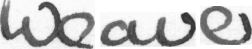

 94%|█████████▎| 620/663 [07:04<00:29,  1.45it/s]

Prediction Text: Weaver
Image:  iam_words/words/a01/a01-043x/a01-043x-02-01.png
Label: appointment
Prediction:  Iphat
CER: 0.8181818181818182; WER: 1.0


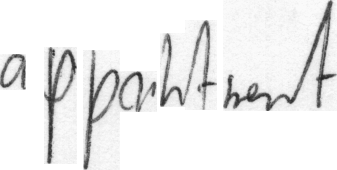

 94%|█████████▎| 621/663 [07:04<00:30,  1.39it/s]

Prediction Text: Iphat
Image:  iam_words/words/c03/c03-021d/c03-021d-03-02.png
Label: instinct
Prediction:  instinct
CER: 0.0; WER: 0.0


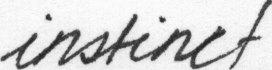

 94%|█████████▍| 622/663 [07:05<00:29,  1.39it/s]

Prediction Text: instinct
Image:  iam_words/words/c03/c03-000b/c03-000b-04-06.png
Label: and
Prediction:  ard
CER: 0.3333333333333333; WER: 1.0


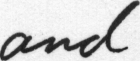

 94%|█████████▍| 623/663 [07:06<00:28,  1.41it/s]

Prediction Text: ard
Image:  iam_words/words/c03/c03-094f/c03-094f-01-00.png
Label: tively
Prediction:  Tiely
CER: 0.3333333333333333; WER: 1.0


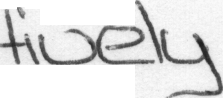

 94%|█████████▍| 624/663 [07:07<00:28,  1.35it/s]

Prediction Text: Tiely
Image:  iam_words/words/c03/c03-081c/c03-081c-02-06.png
Label: our
Prediction:  oT
CER: 0.6666666666666666; WER: 1.0


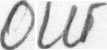

 94%|█████████▍| 625/663 [07:07<00:27,  1.37it/s]

Prediction Text: oT
Image:  iam_words/words/a01/a01-058u/a01-058u-04-04.png
Label: -
Prediction:  .
CER: 1.0; WER: 1.0


 94%|█████████▍| 626/663 [07:08<00:25,  1.45it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-087e/c03-087e-06-08.png
Label: more
Prediction:  more
CER: 0.0; WER: 0.0


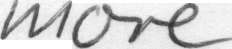

Prediction Text: more
Image:  iam_words/words/c03/c03-094d/c03-094d-07-05.png
Label: set
Prediction:  set
CER: 0.0; WER: 0.0


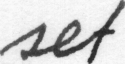

 95%|█████████▍| 628/663 [07:09<00:19,  1.76it/s]

Prediction Text: set
Image:  iam_words/words/c03/c03-081c/c03-081c-00-06.png
Label: a
Prediction:  ,
CER: 1.0; WER: 1.0


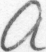

 95%|█████████▍| 629/663 [07:09<00:20,  1.66it/s]

Prediction Text: ,
Image:  iam_words/words/a01/a01-007x/a01-007x-07-09.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 95%|█████████▌| 630/663 [07:10<00:19,  1.68it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-094a/c03-094a-08-02.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


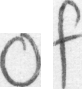

 95%|█████████▌| 631/663 [07:11<00:19,  1.65it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-011u/a01-011u-02-04.png
Label: and
Prediction:  and
CER: 0.0; WER: 0.0


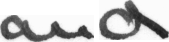

 95%|█████████▌| 632/663 [07:11<00:19,  1.59it/s]

Prediction Text: and
Image:  iam_words/words/c03/c03-087b/c03-087b-08-02.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 95%|█████████▌| 633/663 [07:12<00:18,  1.64it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-082u/a01-082u-08-05.png
Label: poles
Prediction:  poles
CER: 0.0; WER: 0.0


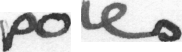

 96%|█████████▌| 634/663 [07:13<00:18,  1.53it/s]

Prediction Text: poles
Image:  iam_words/words/c03/c03-003c/c03-003c-03-06.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


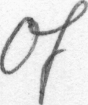

 96%|█████████▌| 635/663 [07:13<00:18,  1.50it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-030u/a01-030u-05-03.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 96%|█████████▌| 636/663 [07:14<00:18,  1.46it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-094b/c03-094b-01-00.png
Label: insensitively
Prediction:  insemnitively
CER: 0.15384615384615385; WER: 1.0


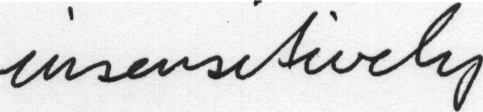

 96%|█████████▌| 637/663 [07:15<00:19,  1.33it/s]

Prediction Text: insemnitively
Image:  iam_words/words/a01/a01-068u/a01-068u-02-03.png
Label: own
Prediction:  own
CER: 0.0; WER: 0.0


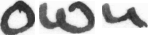

 96%|█████████▌| 638/663 [07:16<00:18,  1.34it/s]

Prediction Text: own
Image:  iam_words/words/c03/c03-016a/c03-016a-03-06.png
Label: In
Prediction:  .
CER: 1.0; WER: 1.0


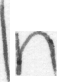

 96%|█████████▋| 639/663 [07:16<00:17,  1.40it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-043u/a01-043u-02-03.png
Label: of
Prediction:  ,
CER: 1.0; WER: 1.0


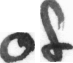

 97%|█████████▋| 640/663 [07:17<00:16,  1.36it/s]

Prediction Text: ,
Image:  iam_words/words/c03/c03-094e/c03-094e-09-06.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 97%|█████████▋| 641/663 [07:18<00:15,  1.47it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-087b/c03-087b-01-06.png
Label: to
Prediction:  I
CER: 1.0; WER: 1.0


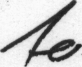

 97%|█████████▋| 642/663 [07:18<00:14,  1.43it/s]

Prediction Text: I
Image:  iam_words/words/a01/a01-014x/a01-014x-00-00.png
Label: Sir
Prediction:  .
CER: 1.0; WER: 1.0


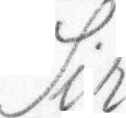

 97%|█████████▋| 643/663 [07:19<00:13,  1.48it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-087d/c03-087d-00-03.png
Label: perhaps
Prediction:  peraps
CER: 0.14285714285714285; WER: 1.0


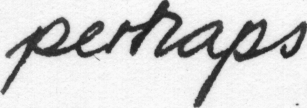

 97%|█████████▋| 644/663 [07:20<00:13,  1.45it/s]

Prediction Text: peraps
Image:  iam_words/words/a01/a01-058x/a01-058x-07-02.png
Label: .
Prediction:  .
CER: 0.0; WER: 0.0


 97%|█████████▋| 645/663 [07:21<00:12,  1.41it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-081a/c03-081a-04-05.png
Label: ,
Prediction:  .
CER: 1.0; WER: 1.0


 97%|█████████▋| 646/663 [07:21<00:11,  1.46it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-007u/a01-007u-01-01.png
Label: have
Prediction:  have
CER: 0.0; WER: 0.0


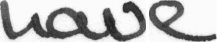

Prediction Text: have
Image:  iam_words/words/a01/a01-107u/a01-107u-03-06.png
Label: attainable
Prediction:  attainable
CER: 0.0; WER: 0.0


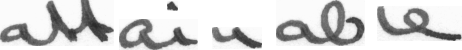

 98%|█████████▊| 648/663 [07:22<00:08,  1.80it/s]

Prediction Text: attainable
Image:  iam_words/words/c03/c03-000f/c03-000f-02-05.png
Label: It
Prediction:  .
CER: 1.0; WER: 1.0


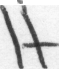

 98%|█████████▊| 649/663 [07:23<00:08,  1.65it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-020x/a01-020x-07-02.png
Label: the
Prediction:  '
CER: 1.0; WER: 1.0


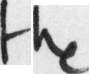

 98%|█████████▊| 650/663 [07:23<00:08,  1.54it/s]

Prediction Text: '
Image:  iam_words/words/c03/c03-016a/c03-016a-04-01.png
Label: she
Prediction:  Whe
CER: 0.3333333333333333; WER: 1.0


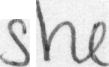

 98%|█████████▊| 651/663 [07:24<00:08,  1.46it/s]

Prediction Text: Whe
Image:  iam_words/words/c03/c03-096e/c03-096e-00-05.png
Label: therefore
Prediction:  therefore
CER: 0.0; WER: 0.0


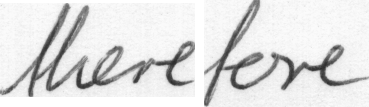

 98%|█████████▊| 652/663 [07:25<00:07,  1.50it/s]

Prediction Text: therefore
Image:  iam_words/words/c03/c03-021a/c03-021a-04-00.png
Label: as
Prediction:  a
CER: 0.5; WER: 1.0


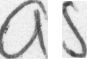

 98%|█████████▊| 653/663 [07:26<00:07,  1.43it/s]

Prediction Text: a
Image:  iam_words/words/a01/a01-049u/a01-049u-03-06.png
Label: had
Prediction:  had
CER: 0.0; WER: 0.0


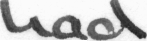

 99%|█████████▊| 654/663 [07:26<00:06,  1.36it/s]

Prediction Text: had
Image:  iam_words/words/a01/a01-053x/a01-053x-04-00.png
Label: of
Prediction:  .
CER: 1.0; WER: 1.0


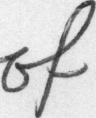

 99%|█████████▉| 655/663 [07:27<00:05,  1.34it/s]

Prediction Text: .
Image:  iam_words/words/c03/c03-084a/c03-084a-07-02.png
Label: unbridled
Prediction:  unbridled
CER: 0.0; WER: 0.0


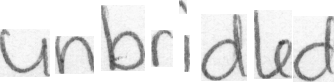

 99%|█████████▉| 656/663 [07:28<00:05,  1.34it/s]

Prediction Text: unbridled
Image:  iam_words/words/a01/a01-063u/a01-063u-04-07.png
Label: Washington
Prediction:  Washington
CER: 0.0; WER: 0.0


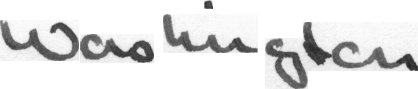

 99%|█████████▉| 657/663 [07:29<00:04,  1.35it/s]

Prediction Text: Washington
Image:  iam_words/words/c03/c03-087f/c03-087f-03-01.png
Label: left
Prediction:  ,f
CER: 0.75; WER: 1.0


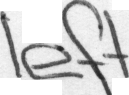

 99%|█████████▉| 658/663 [07:29<00:03,  1.35it/s]

Prediction Text: ,f
Image:  iam_words/words/a01/a01-049x/a01-049x-09-08.png
Label: several
Prediction:  several
CER: 0.0; WER: 0.0


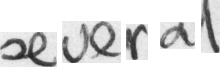

 99%|█████████▉| 659/663 [07:30<00:02,  1.40it/s]

Prediction Text: several
Image:  iam_words/words/a01/a01-132x/a01-132x-05-07.png
Label: "
Prediction:  .
CER: 1.0; WER: 1.0


100%|█████████▉| 660/663 [07:31<00:02,  1.42it/s]

Prediction Text: .
Image:  iam_words/words/a01/a01-122u/a01-122u-08-00.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


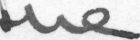

100%|█████████▉| 661/663 [07:32<00:01,  1.38it/s]

Prediction Text: the
Image:  iam_words/words/a01/a01-128u/a01-128u-08-00.png
Label: the
Prediction:  the
CER: 0.0; WER: 0.0


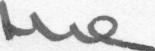

100%|█████████▉| 662/663 [07:32<00:00,  1.31it/s]

Prediction Text: the
Image:  iam_words/words/c03/c03-003b/c03-003b-04-08.png
Label: to
Prediction:  .
CER: 1.0; WER: 1.0


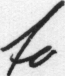

100%|██████████| 663/663 [07:33<00:00,  1.46it/s]

Prediction Text: .
Average CER: 0.38798352225954036, Average WER: 0.5656108597285068


In [ ]:
# inferenceModel.py
import cv2
import typing
import numpy as np

from mltu.inferenceModel import OnnxInferenceModel
from mltu.utils.text_utils import ctc_decoder, get_cer, get_wer
from mltu.transformers import ImageResizer


from google.colab.patches import cv2_imshow

class ImageToWordModel(OnnxInferenceModel):
    def __init__(self, char_list: typing.Union[str, list], *args, **kwargs):
        super().__init__(*args, **kwargs)
        self.char_list = char_list

    def predict(self, image: np.ndarray):
        if image is None:
            raise ValueError("Invalid image provided")

        image = ImageResizer.resize_maintaining_aspect_ratio(image, *self.input_shapes[0][1:3][::-1])

        image_pred = np.expand_dims(image, axis=0).astype(np.float32)

        preds = self.model.run(self.output_names, {self.input_names[0]: image_pred})[0]

        text = ctc_decoder(preds, self.char_list)[0]

        return text

if __name__ == "__main__":
    import pandas as pd
    from tqdm import tqdm
    from mltu.configs import BaseModelConfigs

    configs = BaseModelConfigs.load("Models/04_sentence_recognition/202405310803/configs.yaml")

    model = ImageToWordModel(model_path=configs.model_path, char_list=configs.vocab)

    df = pd.read_csv("Models/04_sentence_recognition/202405310803/ val.csv").values.tolist()

    accum_cer, accum_wer = [], []
    for image_path, label in tqdm(df):
        image_path = image_path.replace("\\", "/")
        image = cv2.imread(image_path)

        if image is None:
            print(f"Error loading image: {image_path}")
            continue

        try:
            prediction_text = model.predict(image)
        except ValueError as e:
            print(f"Error processing image {image_path}: {e}")
            continue

        cer = get_cer(prediction_text, label)
        wer = get_wer(prediction_text, label)
        print("Image: ", image_path)
        print("Label:", label)
        print("Prediction: ", prediction_text)
        print(f"CER: {cer}; WER: {wer}")

        accum_cer.append(cer)
        accum_wer.append(wer)

        cv2_imshow(image)
        print(f"Prediction Text: {prediction_text}")
        cv2.waitKey(0)
        cv2.destroyAllWindows()

    print(f"Average CER: {np.average(accum_cer)}, Average WER: {np.average(accum_wer)}")


In [ ]:
import tensorflow as tf
from keras.callbacks import TensorBoard
import os

# Define the directory where logs will be stored
train_log_dir = "Models/04_sentence_recognition/202405310803/logs/train"
val_log_dir = "Models/04_sentence_recognition/202405310803/logs/validation"

# Create the TensorBoard callback
tensorboard_callback_train = TensorBoard(log_dir=train_log_dir, histogram_freq=1)
tensorboard_callback_val = TensorBoard(log_dir=val_log_dir)

# Install TensorBoard
!pip install tensorboard

# Load TensorBoard
%load_ext tensorboard

# Start TensorBoard and point it to the parent logs directory
%tensorboard --logdir Models/04_sentence_recognition/202405310803/logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
!ls Models/04_sentence_recognition/202405310803/logs/train
!ls Models/04_sentence_recognition/202405310803/logs/validation

events.out.tfevents.1673457118.sfwks-189.sf.lan.425942.0.v2
events.out.tfevents.1673457137.sfwks-189.sf.lan.425942.1.v2


In [ ]:
import os

model_dir = "Models/04_sentence_recognition/202405310803"
print(os.listdir(model_dir))


[' logs.log', ' model.h5', ' model.onnx', 'train.csv', 'configs.yaml', ' val.csv']


In [ ]:
import cv2
import typing
import numpy as np
import pandas as pd
from tqdm import tqdm
from mltu.inferenceModel import OnnxInferenceModel
from mltu.utils.text_utils import ctc_decoder, get_cer, get_wer
from mltu.transformers import ImageResizer

class ImageToWordModel(OnnxInferenceModel):
    def __init__(self, char_list: typing.Union[str, list], model_path: str ):
        super().__init__(model_path=model_path)
        self.char_list = char_list

    def predict(self, image: np.ndarray):
        # Resize image while maintaining aspect ratio
        image = ImageResizer.resize_maintaining_aspect_ratio(image, *self.input_shape[:2][::-1])

        # Add batch dimension and convert image to float32
        image_pred = np.expand_dims(image, axis=0).astype(np.float32)

        # Run model inference
        preds = self.model.run(None, {self.input_name: image_pred})[0]

        # Decode prediction
        text = ctc_decoder(preds, self.char_list)[0]

        return text

if __name__ == "__main__":
    # Manually specify the model path and character list
    model_path = "Models/04_sentence_recognition/202405310803/ model.onnx"
    char_list = 'z9k5ijq.E0TPr,LcfDyumotYKO-QJ;d:Bn?b8lNWHI4s6\'g7U!1A3)pweV#MRF"GZvax&h(S2C'  # Example character list; adjust based on your model

    # Initialize the model
    model = ImageToWordModel(model_path=model_path, char_list=char_list)

    # Load validation data
    df = pd.read_csv("Models/04_sentence_recognition/202405310803/ val.csv").values.tolist()

    accum_cer, accum_wer = [], []
    for image_path, label in tqdm(df):
        image = cv2.imread(image_path)
        if image is None:
            print(f"Error loading image: {image_path}")
            continue

        # Predict text from image
        prediction_text = model.predict(image)

        # Calculate CER and WER
        cer = get_cer(prediction_text, label)
        wer = get_wer(prediction_text, label)

        print(f"Image: {image_path}")
        print(f"Label: {label}")
        print(f"Prediction: {prediction_text}")
        print(f"CER: {cer}; WER: {wer}")

        accum_cer.append(cer)
        accum_wer.append(wer)

        # Display the image with prediction text
        cv2.imshow('Prediction', image)
        cv2.waitKey(0)
        cv2.destroyAllWindows()

    # Print average CER and WER
    print(f"Average CER: {np.average(accum_cer)}, Average WER: {np.average(accum_wer)}")


  5%|▍         | 108/2171 [00:00<00:02, 988.85it/s]

Error loading image: Datasets/IAM_Words/words/g06/g06-031o/g06-031o-07-04.png
Error loading image: Datasets/IAM_Words/words/g06/g06-026e/g06-026e-02-03.png
Error loading image: Datasets/IAM_Words/words/g06/g06-050g/g06-050g-06-00.png
Error loading image: Datasets/IAM_Words/words/a01/a01-058u/a01-058u-01-01.png
Error loading image: Datasets/IAM_Words/words/f07/f07-046b/f07-046b-08-04.png
Error loading image: Datasets/IAM_Words/words/g06/g06-050i/g06-050i-04-08.png
Error loading image: Datasets/IAM_Words/words/c03/c03-096c/c03-096c-05-06.png
Error loading image: Datasets/IAM_Words/words/c03/c03-003c/c03-003c-06-02.png
Error loading image: Datasets/IAM_Words/words/f07/f07-076a/f07-076a-02-04.png
Error loading image: Datasets/IAM_Words/words/g06/g06-018a/g06-018a-01-05.png
Error loading image: Datasets/IAM_Words/words/g07/g07-074a/g07-074a-03-05.png
Error loading image: Datasets/IAM_Words/words/g06/g06-031m/g06-031m-08-01.png
Error loading image: Datasets/IAM_Words/words/g06/g06-026d/g06-0

 17%|█▋        | 363/2171 [00:00<00:01, 1011.37it/s]

Error loading image: Datasets/IAM_Words/words/g06/g06-011b/g06-011b-03-01.png
Error loading image: Datasets/IAM_Words/words/g06/g06-011h/g06-011h-04-02.png
Error loading image: Datasets/IAM_Words/words/g06/g06-031m/g06-031m-04-00.png
Error loading image: Datasets/IAM_Words/words/g07/g07-007a/g07-007a-03-04.png
Error loading image: Datasets/IAM_Words/words/n02/n02-082a/n02-082a-02-05.png
Error loading image: Datasets/IAM_Words/words/g06/g06-042j/g06-042j-00-03.png
Error loading image: Datasets/IAM_Words/words/g07/g07-028b/g07-028b-04-01.png
Error loading image: Datasets/IAM_Words/words/g07/g07-000a/g07-000a-00-02.png
Error loading image: Datasets/IAM_Words/words/a01/a01-007x/a01-007x-01-05.png
Error loading image: Datasets/IAM_Words/words/g06/g06-011a/g06-011a-05-08.png
Error loading image: Datasets/IAM_Words/words/g06/g06-031j/g06-031j-01-05.png
Error loading image: Datasets/IAM_Words/words/c03/c03-087b/c03-087b-05-00.png
Error loading image: Datasets/IAM_Words/words/g06/g06-037o/g06-0

 55%|█████▍    | 1194/2171 [00:00<00:00, 2668.10it/s]

Error loading image: Datasets/IAM_Words/words/a01/a01-122u/a01-122u-08-02.png
Error loading image: Datasets/IAM_Words/words/g06/g06-018a/g06-018a-06-07.png
Error loading image: Datasets/IAM_Words/words/g06/g06-018b/g06-018b-09-09.png
Error loading image: Datasets/IAM_Words/words/g06/g06-047b/g06-047b-01-05.png
Error loading image: Datasets/IAM_Words/words/g06/g06-018p/g06-018p-01-07.png
Error loading image: Datasets/IAM_Words/words/g07/g07-026b/g07-026b-02-05.png
Error loading image: Datasets/IAM_Words/words/g06/g06-045g/g06-045g-02-08.png
Error loading image: Datasets/IAM_Words/words/c03/c03-007c/c03-007c-07-06.png
Error loading image: Datasets/IAM_Words/words/g06/g06-045b/g06-045b-01-03.png
Error loading image: Datasets/IAM_Words/words/h07/h07-063b/h07-063b-01-04.png
Error loading image: Datasets/IAM_Words/words/h07/h07-028a/h07-028a-01-03.png
Error loading image: Datasets/IAM_Words/words/h07/h07-069a/h07-069a-01-00.png
Error loading image: Datasets/IAM_Words/words/g06/g06-011o/g06-0

 80%|███████▉  | 1727/2171 [00:00<00:00, 2313.39it/s]

Error loading image: Datasets/IAM_Words/words/g06/g06-050h/g06-050h-05-04.png
Error loading image: Datasets/IAM_Words/words/g06/g06-050g/g06-050g-06-06.png
Error loading image: Datasets/IAM_Words/words/c03/c03-087b/c03-087b-05-04.png
Error loading image: Datasets/IAM_Words/words/a01/a01-058u/a01-058u-08-02.png
Error loading image: Datasets/IAM_Words/words/g06/g06-011p/g06-011p-05-06.png
Error loading image: Datasets/IAM_Words/words/c03/c03-000a/c03-000a-01-01.png
Error loading image: Datasets/IAM_Words/words/g06/g06-047a/g06-047a-01-03.png
Error loading image: Datasets/IAM_Words/words/g06/g06-037b/g06-037b-05-05.png
Error loading image: Datasets/IAM_Words/words/c03/c03-084a/c03-084a-06-01.png
Error loading image: Datasets/IAM_Words/words/g06/g06-018b/g06-018b-00-01.png
Error loading image: Datasets/IAM_Words/words/c03/c03-096b/c03-096b-05-05.png
Error loading image: Datasets/IAM_Words/words/h07/h07-037a/h07-037a-07-00.png
Error loading image: Datasets/IAM_Words/words/a01/a01-007u/a01-0

100%|██████████| 2171/2171 [00:00<00:00, 2352.90it/s]

Error loading image: Datasets/IAM_Words/words/a01/a01-132u/a01-132u-03-05.png
Error loading image: Datasets/IAM_Words/words/g06/g06-031n/g06-031n-01-01.png
Error loading image: Datasets/IAM_Words/words/f07/f07-101a/f07-101a-01-05.png
Error loading image: Datasets/IAM_Words/words/g07/g07-003b/g07-003b-07-03.png
Error loading image: Datasets/IAM_Words/words/g06/g06-011a/g06-011a-02-08.png
Error loading image: Datasets/IAM_Words/words/g06/g06-047h/g06-047h-01-07.png
Error loading image: Datasets/IAM_Words/words/g06/g06-011j/g06-011j-10-06.png
Error loading image: Datasets/IAM_Words/words/g06/g06-011k/g06-011k-04-00.png
Error loading image: Datasets/IAM_Words/words/c03/c03-007f/c03-007f-01-06.png
Error loading image: Datasets/IAM_Words/words/g06/g06-031i/g06-031i-05-02.png
Error loading image: Datasets/IAM_Words/words/g06/g06-047g/g06-047g-01-02.png
Error loading image: Datasets/IAM_Words/words/g06/g06-026b/g06-026b-05-05.png
Error loading image: Datasets/IAM_Words/words/c03/c03-021b/c03-0


/usr/local/lib/python3.10/dist-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [ ]:
# Train the model

history = model.fit(
    x=x_train,
    y=y_train,
    batch_size=32,
    epochs=10,
    validation_data=(x_val, y_val),
    verbose=1
)

Epoch 1/10


ValueError: in user code:

    File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1401, in train_function  *
        return step_function(self, iterator)
    File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1384, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1373, in run_step  **
        outputs = model.train_step(data)
    File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1151, in train_step
        loss = self.compute_loss(x, y, y_pred, sample_weight)
    File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1209, in compute_loss
        return self.compiled_loss(
    File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/compile_utils.py", line 277, in __call__
        loss_value = loss_obj(y_t, y_p, sample_weight=sw)
    File "/usr/local/lib/python3.10/dist-packages/mltu/tensorflow/losses.py", line 15, in __call__
        label_length = tf.cast(tf.shape(y_true)[1], dtype="int64")

    ValueError: slice index 1 of dimension 0 out of bounds. for '{{node strided_slice_2}} = StridedSlice[Index=DT_INT32, T=DT_INT32, begin_mask=0, ellipsis_mask=0, end_mask=0, new_axis_mask=0, shrink_axis_mask=1](Shape_2, strided_slice_2/stack, strided_slice_2/stack_1, strided_slice_2/stack_2)' with input shapes: [1], [1], [1], [1] and with computed input tensors: input[1] = <1>, input[2] = <2>, input[3] = <1>.
